# Preprocessing CAPTCHA Images with OpenCV

* Original Dataset
  * [Version 2 CAPTCHA Images (from Kaggle)](https://www.kaggle.com/fournierp/captcha-version-2-images)
    * 1070 images files of 5 letter words (200 x 50, .png or .jpg) 

* Preprocessed Dataset (result)
  * charset = ['2', '3', '4', '5', '6', '7', '8', 'b', 'c', 'd', 'e', 'f', 'g', 'm', 'n', 'p', 'w', 'x', 'y'] (19 classes)
  * https://drive.google.com/drive/folders/1uz6nel0_x5l8mPI8p1HVw5oSAovEmNy7?usp=sharing

* Process of Image Preprocessing
  1. Otsu threholding with Gaussian Blur
  2. Dilation -> Erosion -> Dilation
  3. Split into characters by fixed coordinates
  4. Reclassify some misclassified characters in Train Dataset by hand
    * 'm' and 'w' can occupy the width for two characters so some characters were missed or misclassified.
  5. Remove some ambiguously split characters in Train Dataset by hand
    * The characters are not always accurately located at the coordinates, so some characters were split partially. 
    * 'm' and 'w' can occupy the width for two characters, so 'm' can be cut into two 'n's and 'w' can be cut into two 'v's. 

* Reference
  * [OpenCV Word Segmenting on CAPTCHA Images](https://www.kaggle.com/fournierp/opencv-word-segmenting-on-captcha-images)


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [ ]:
%ls -al

total 12
drwx------  3 root root 4096 Jun 14 13:40 samples/
drwx------ 38 root root 4096 Jun 15 06:27 test/
drwx------ 38 root root 4096 Jun 15 06:27 train/


In [ ]:
%pwd

'/content/gdrive/My Drive/Colab Notebooks/term_project/dataset'

In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
%matplotlib inline

import os
for dirname, _, filenames in os.walk('/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2pfpn.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/42xpy.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2x7bm.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3g2w6.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ndxd.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2nbc5.jpg
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3bfnd.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4433m.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/37d52.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2wx73.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3xcgg.png
/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/36nx4.png
/content/gdrive/My Drive/Colab Notebooks

In [ ]:
os.listdir("samples")

['2pfpn.png',
 '42xpy.png',
 '2x7bm.png',
 '3g2w6.png',
 '3ndxd.png',
 '2nbc5.jpg',
 '3bfnd.png',
 '4433m.png',
 '37d52.png',
 '2wx73.png',
 '3xcgg.png',
 '36nx4.png',
 '36bc2.png',
 '43mn5.png',
 '3den6.png',
 '3bd8f.png',
 '2nbcx.png',
 '3bx86.png',
 '2w4y7.png',
 '44fyb.png',
 '2npg6.png',
 '3n7mx.png',
 '3w2bw.png',
 '3nnpw.png',
 '3p67n.png',
 '42nxy.png',
 '3ebpw.png',
 '3x325.png',
 '3nfdn.png',
 '373gb.png',
 '3wnd3.png',
 '428b6.png',
 '43gey.png',
 '3fbxd.png',
 '368y5.png',
 '3ygde.png',
 '3n2b4.png',
 '3eny7.png',
 '3nw7w.png',
 '3ym7f.png',
 '33ng4.png',
 '32cnn.png',
 '3c7de.jpg',
 '3ebnn.png',
 '3xng6.png',
 '325fb.png',
 '3ny45.png',
 '6ng6n.png',
 'c753e.png',
 '65m85.png',
 '4yc85.png',
 '6xpme.png',
 '6mygb.png',
 '8np22.png',
 'd2nbn.png',
 'cffp4.png',
 'cwmny.png',
 'dd5w5.png',
 'ennmm.png',
 'e667x.png',
 'bbymy.png',
 '785n4.png',
 '5mcy7.png',
 '7xd5m.png',
 '5n245.png',
 '87nym.png',
 '4n3mn.png',
 '88y52.png',
 'bgd4m.png',
 'dbex3.png',
 '573d8.png',
 '8w75

In [ ]:
# gdrive/My Drive/Colab Notebooks/term_project/dataset/samples
# gdrive/My Drive/Colab Notebooks/term_project/dataset/test
# gdrive/My Drive/Colab Notebooks/term_project/dataset/train
import shutil

files = os.listdir("samples")
img_files = [f for f in files if f.endswith(".png") or f.endswith(".jpg")]

# 1070 -> 749(train, 70%), 321(test, 30%)
print("# of img_files:", len(img_files))  
print(img_files)    

# of img_files: 1070
['2pfpn.png', '42xpy.png', '2x7bm.png', '3g2w6.png', '3ndxd.png', '2nbc5.jpg', '3bfnd.png', '4433m.png', '37d52.png', '2wx73.png', '3xcgg.png', '36nx4.png', '36bc2.png', '43mn5.png', '3den6.png', '3bd8f.png', '2nbcx.png', '3bx86.png', '2w4y7.png', '44fyb.png', '2npg6.png', '3n7mx.png', '3w2bw.png', '3nnpw.png', '3p67n.png', '42nxy.png', '3ebpw.png', '3x325.png', '3nfdn.png', '373gb.png', '3wnd3.png', '428b6.png', '43gey.png', '3fbxd.png', '368y5.png', '3ygde.png', '3n2b4.png', '3eny7.png', '3nw7w.png', '3ym7f.png', '33ng4.png', '32cnn.png', '3c7de.jpg', '3ebnn.png', '3xng6.png', '325fb.png', '3ny45.png', '6ng6n.png', 'c753e.png', '65m85.png', '4yc85.png', '6xpme.png', '6mygb.png', '8np22.png', 'd2nbn.png', 'cffp4.png', 'cwmny.png', 'dd5w5.png', 'ennmm.png', 'e667x.png', 'bbymy.png', '785n4.png', '5mcy7.png', '7xd5m.png', '5n245.png', '87nym.png', '4n3mn.png', '88y52.png', 'bgd4m.png', 'dbex3.png', '573d8.png', '8w754.png', '56c34.png', 'ffpxf.png', 'een23.png', 'fc

In [ ]:
# Reference: https://www.kaggle.com/fournierp/opencv-word-segmenting-on-captcha-images

def preprocess(dirname, filename, train_or_test):
    full_path = os.path.join(dirname, filename)
    if os.path.exists(full_path):
      print("Preprocessing on:", full_path)
    else:
      print(full_path, "doesn't exist")
    # Load image
    img = cv2.imread(os.path.join(dirname, filename), 0)  # gray
    plt.imshow(img, 'gray')
    blurred_img = cv2.GaussianBlur(img, (5, 5), 0)
    ret, th = cv2.threshold(blurred_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
        
    # Dilation 
    kernel = np.ones((3,3), np.uint8)  # structuring element
    dil = cv2.dilate(th, kernel, iterations=1)
    # Erosion
    ero = cv2.erode(dil, kernel, iterations=1)
    # Dilation
    kernel = np.ones((3, 1), np.uint8)
    dil = cv2.dilate(ero, kernel, iterations=1)
    
    # Separate each letter and save
    x, y, w, h = 30, 12, 20, 38
    for i in range(5):
        cropped_img = dil[y:y+h, x:x+w]
        if train_or_test == 'train':
          save_path = os.path.join('/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train', filename[-9 + i], 
                                 filename[:-4] + '_' + filename[-9 + i] + filename[-4:])
        elif train_or_test == 'test':
          save_path = os.path.join('/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test', filename[-9 + i], 
                                 filename[:-4] + '_' + filename[-9 + i] + filename[-4:])
          
        cv2.imwrite(save_path, cropped_img)
        print("Cropped image saved to:", save_path)
        
        plt.cla()  
        plt.imshow(cropped_img, 'gray')
        plt.pause(1)
        
        x += w    

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2pfpn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2pfpn_2.png


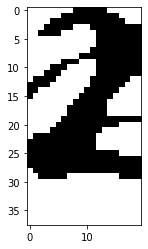

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/2pfpn_p.png


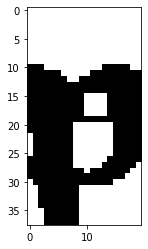

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/2pfpn_f.png


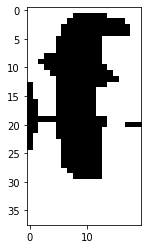

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/2pfpn_p.png


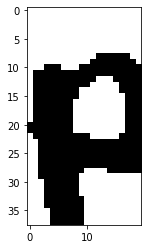

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/2pfpn_n.png


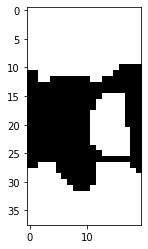

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/42xpy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/42xpy_4.png


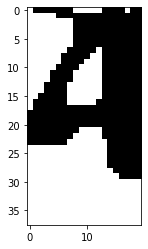

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/42xpy_2.png


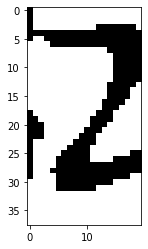

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/42xpy_x.png


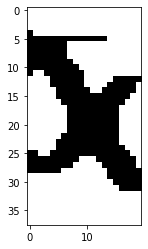

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/42xpy_p.png


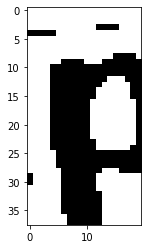

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/42xpy_y.png


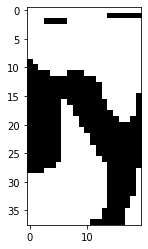

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2x7bm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2x7bm_2.png


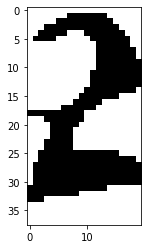

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/2x7bm_x.png


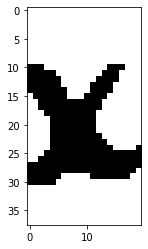

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/2x7bm_7.png


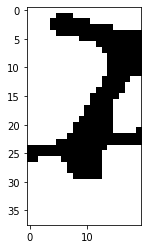

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/2x7bm_b.png


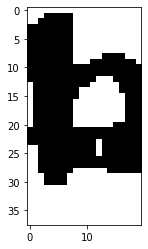

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/2x7bm_m.png


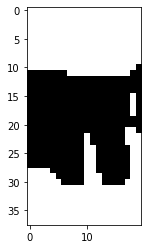

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3g2w6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3g2w6_3.png


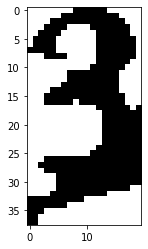

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/3g2w6_g.png


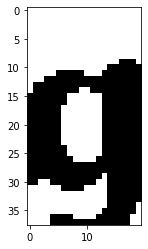

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/3g2w6_2.png


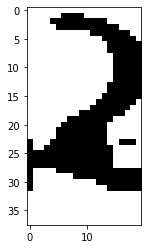

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3g2w6_w.png


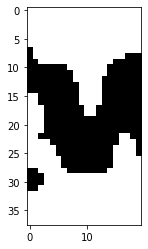

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/3g2w6_6.png


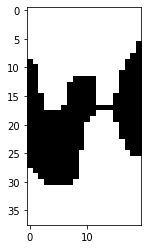

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ndxd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ndxd_3.png


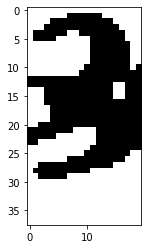

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3ndxd_n.png


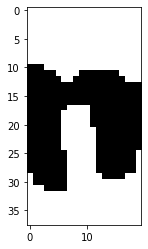

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3ndxd_d.png


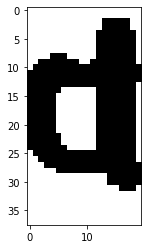

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3ndxd_x.png


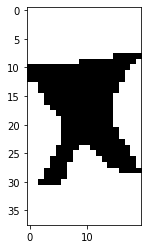

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3ndxd_d.png


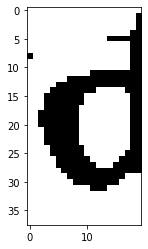

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2nbc5.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2nbc5_2.jpg


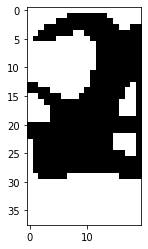

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/2nbc5_n.jpg


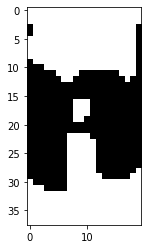

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/2nbc5_b.jpg


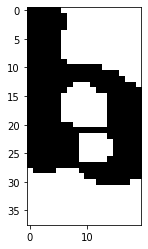

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/2nbc5_c.jpg


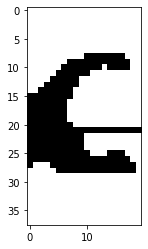

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/2nbc5_5.jpg


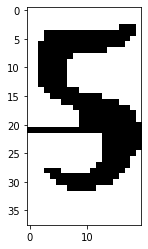

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3bfnd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3bfnd_3.png


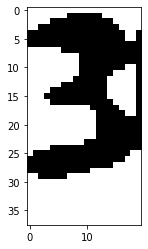

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3bfnd_b.png


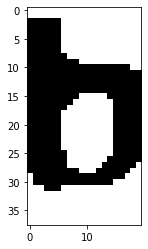

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/3bfnd_f.png


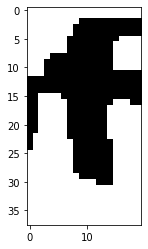

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3bfnd_n.png


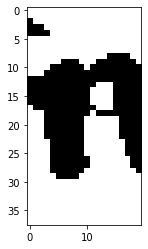

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3bfnd_d.png


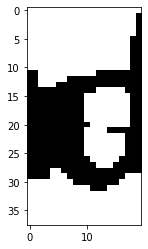

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4433m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4433m_4.png


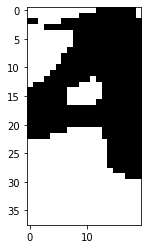

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4433m_4.png


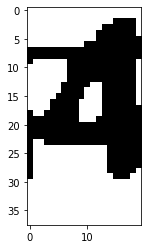

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4433m_3.png


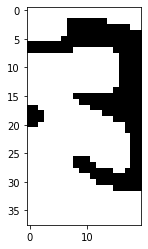

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4433m_3.png


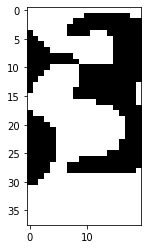

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4433m_m.png


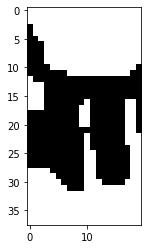

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/37d52.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/37d52_3.png


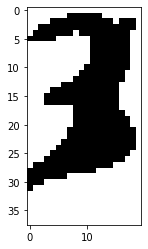

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/37d52_7.png


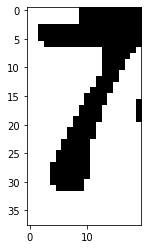

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/37d52_d.png


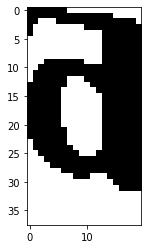

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/37d52_5.png


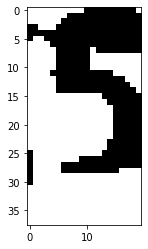

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/37d52_2.png


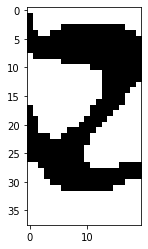

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2wx73.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2wx73_2.png


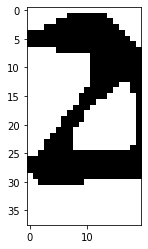

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/2wx73_w.png


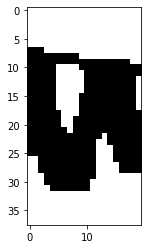

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/2wx73_x.png


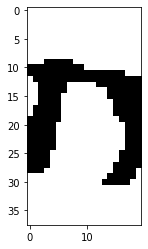

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/2wx73_7.png


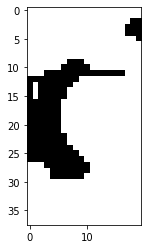

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/2wx73_3.png


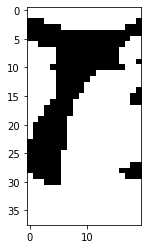

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3xcgg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3xcgg_3.png


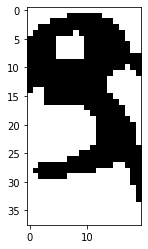

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3xcgg_x.png


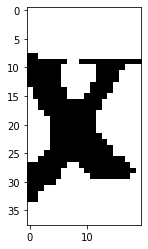

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/3xcgg_c.png


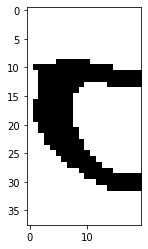

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/3xcgg_g.png


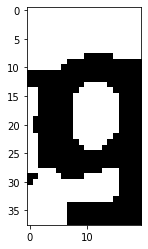

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/3xcgg_g.png


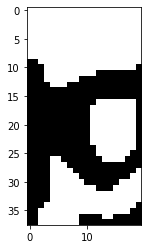

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/36nx4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/36nx4_3.png


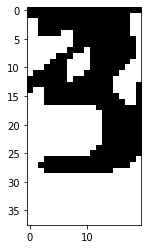

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/36nx4_6.png


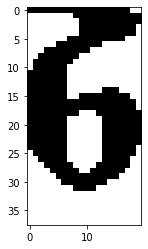

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/36nx4_n.png


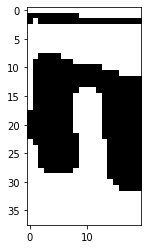

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/36nx4_x.png


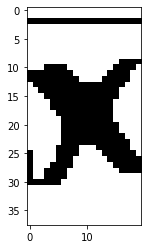

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/36nx4_4.png


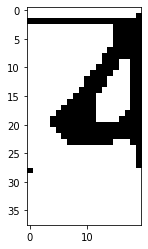

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/36bc2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/36bc2_3.png


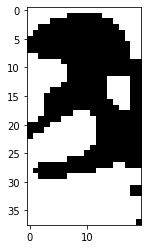

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/36bc2_6.png


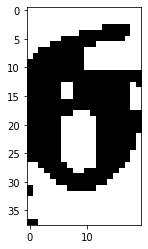

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/36bc2_b.png


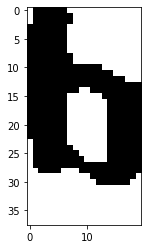

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/36bc2_c.png


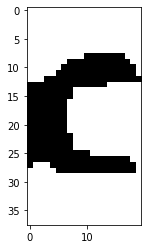

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/36bc2_2.png


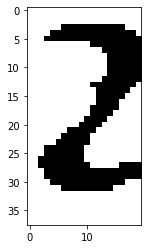

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/43mn5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/43mn5_4.png


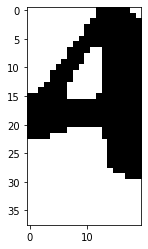

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/43mn5_3.png


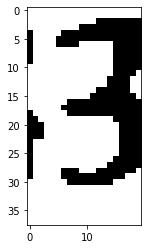

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/43mn5_m.png


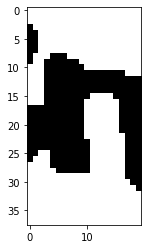

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/43mn5_n.png


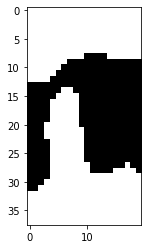

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/43mn5_5.png


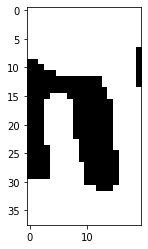

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3den6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3den6_3.png


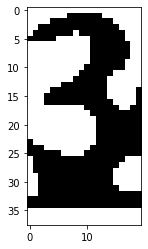

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3den6_d.png


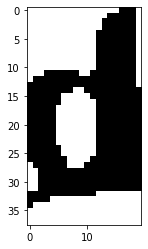

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3den6_e.png


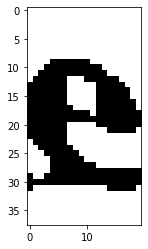

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3den6_n.png


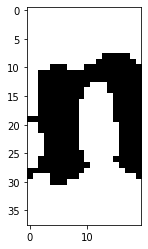

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/3den6_6.png


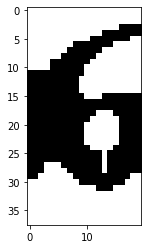

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3bd8f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3bd8f_3.png


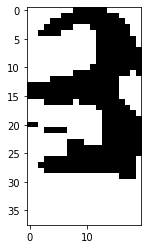

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3bd8f_b.png


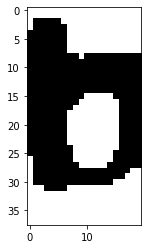

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3bd8f_d.png


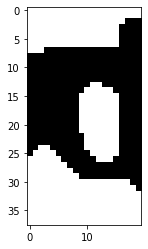

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/3bd8f_8.png


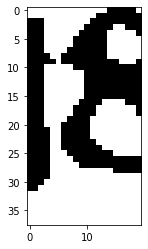

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/3bd8f_f.png


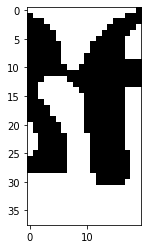

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2nbcx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2nbcx_2.png


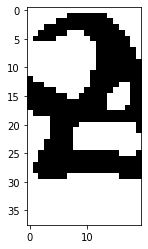

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/2nbcx_n.png


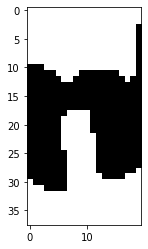

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/2nbcx_b.png


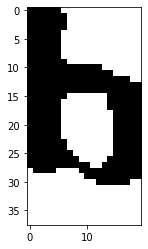

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/2nbcx_c.png


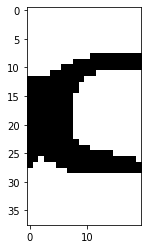

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/2nbcx_x.png


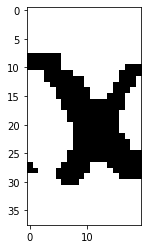

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3bx86.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3bx86_3.png


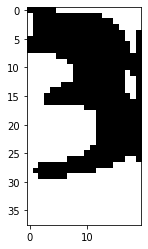

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3bx86_b.png


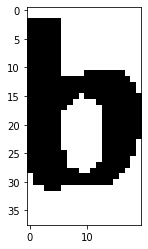

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3bx86_x.png


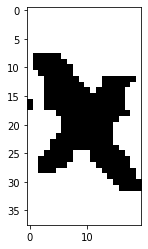

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/3bx86_8.png


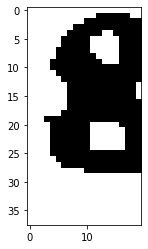

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/3bx86_6.png


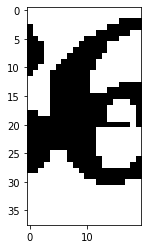

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2w4y7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2w4y7_2.png


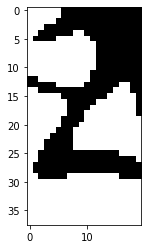

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/2w4y7_w.png


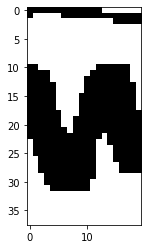

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/2w4y7_4.png


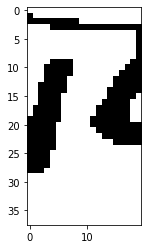

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/2w4y7_y.png


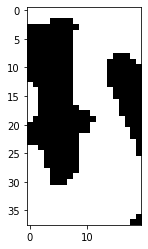

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/2w4y7_7.png


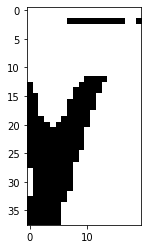

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/44fyb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44fyb_4.png


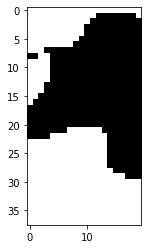

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44fyb_4.png


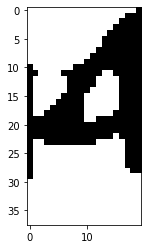

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/44fyb_f.png


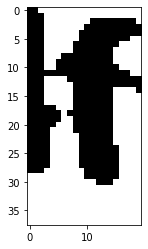

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/44fyb_y.png


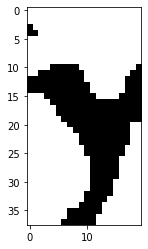

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/44fyb_b.png


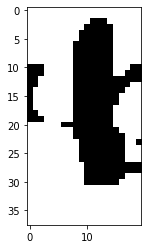

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2npg6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/2npg6_2.png


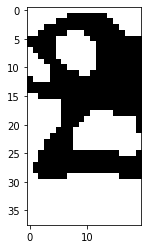

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/2npg6_n.png


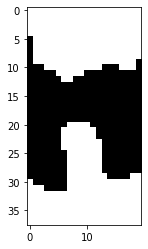

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/2npg6_p.png


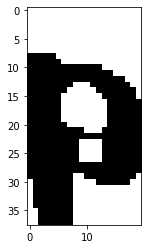

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/2npg6_g.png


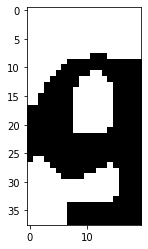

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/2npg6_6.png


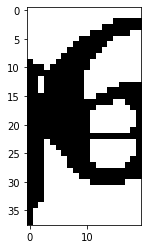

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3n7mx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3n7mx_3.png


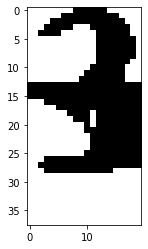

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3n7mx_n.png


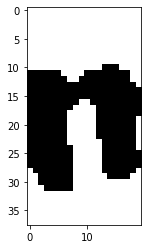

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3n7mx_7.png


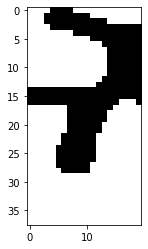

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/3n7mx_m.png


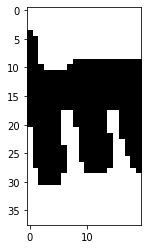

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3n7mx_x.png


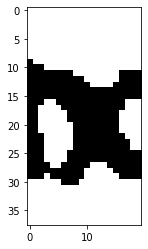

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3w2bw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3w2bw_3.png


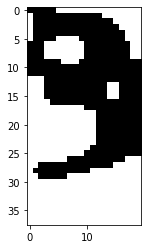

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3w2bw_w.png


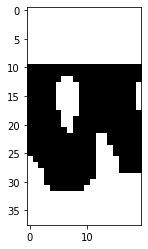

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/3w2bw_2.png


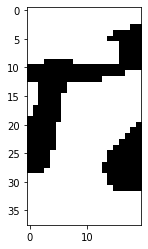

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3w2bw_b.png


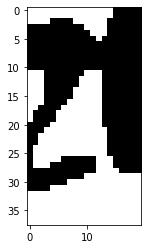

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3w2bw_w.png


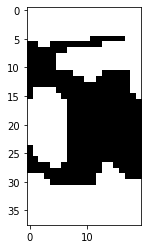

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3nnpw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3nnpw_3.png


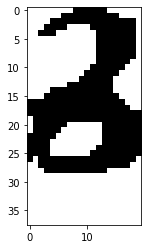

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3nnpw_n.png


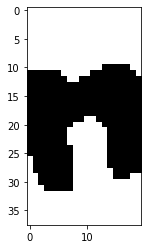

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3nnpw_n.png


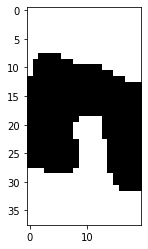

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/3nnpw_p.png


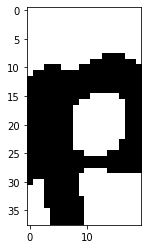

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3nnpw_w.png


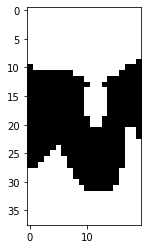

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3p67n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3p67n_3.png


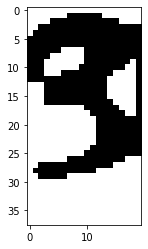

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/3p67n_p.png


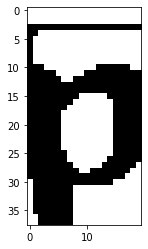

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/3p67n_6.png


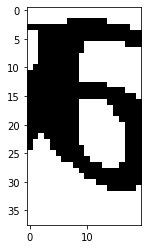

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3p67n_7.png


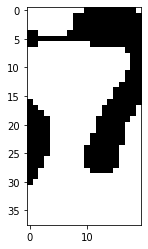

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3p67n_n.png


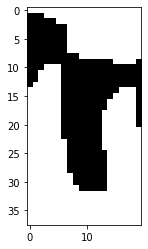

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/42nxy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/42nxy_4.png


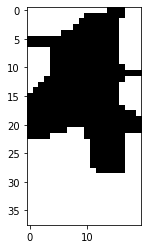

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/42nxy_2.png


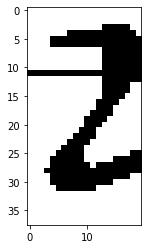

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/42nxy_n.png


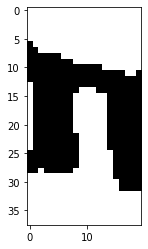

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/42nxy_x.png


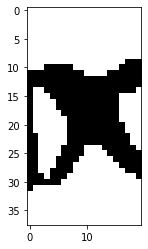

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/42nxy_y.png


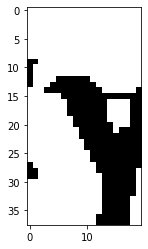

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ebpw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ebpw_3.png


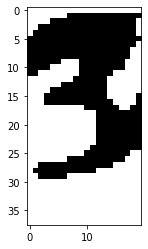

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3ebpw_e.png


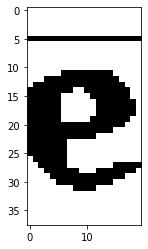

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3ebpw_b.png


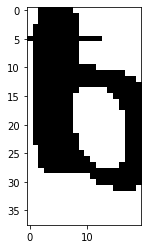

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/3ebpw_p.png


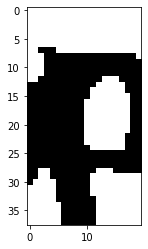

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3ebpw_w.png


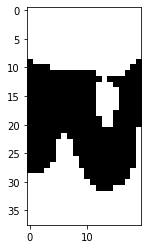

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3x325.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3x325_3.png


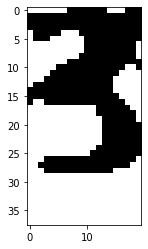

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3x325_x.png


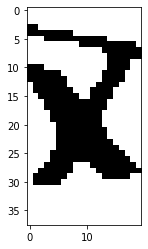

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3x325_3.png


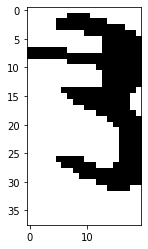

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/3x325_2.png


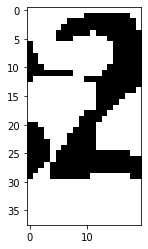

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/3x325_5.png


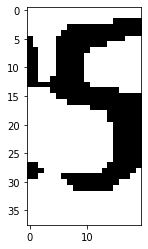

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3nfdn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3nfdn_3.png


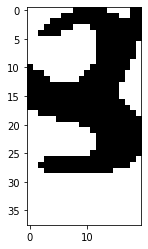

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3nfdn_n.png


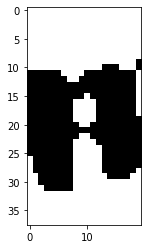

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/3nfdn_f.png


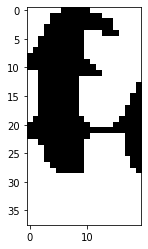

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3nfdn_d.png


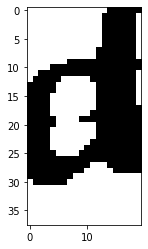

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3nfdn_n.png


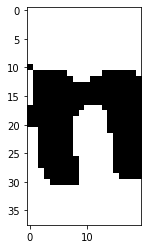

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/373gb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/373gb_3.png


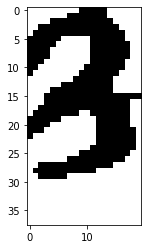

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/373gb_7.png


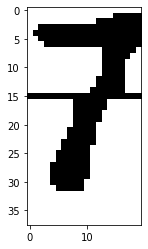

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/373gb_3.png


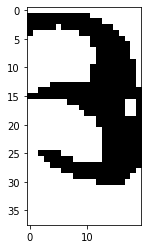

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/373gb_g.png


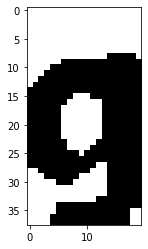

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/373gb_b.png


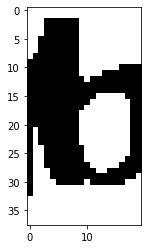

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3wnd3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3wnd3_3.png


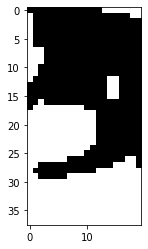

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3wnd3_w.png


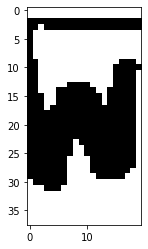

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3wnd3_n.png


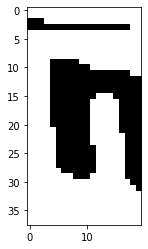

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3wnd3_d.png


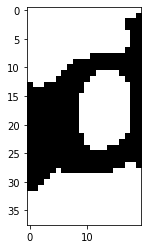

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3wnd3_3.png


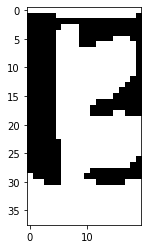

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/428b6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/428b6_4.png


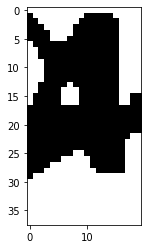

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/428b6_2.png


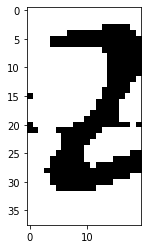

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/428b6_8.png


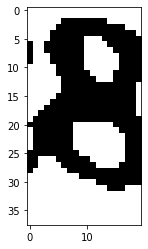

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/428b6_b.png


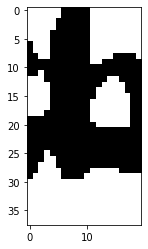

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/428b6_6.png


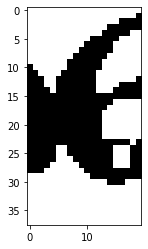

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/43gey.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/43gey_4.png


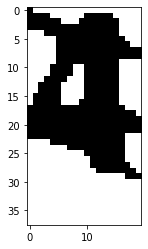

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/43gey_3.png


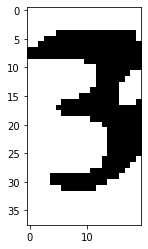

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/43gey_g.png


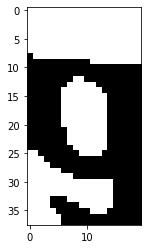

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/43gey_e.png


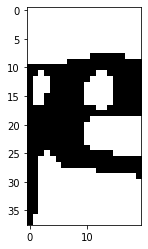

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/43gey_y.png


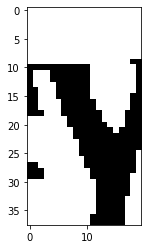

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3fbxd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3fbxd_3.png


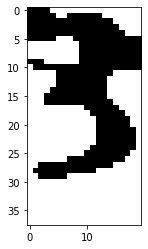

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/3fbxd_f.png


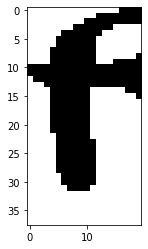

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3fbxd_b.png


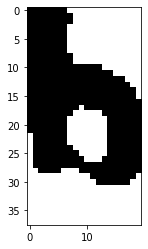

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3fbxd_x.png


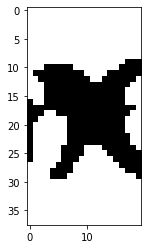

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3fbxd_d.png


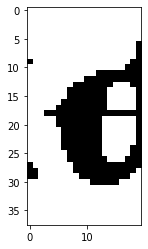

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/368y5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/368y5_3.png


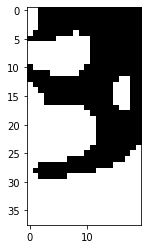

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/368y5_6.png


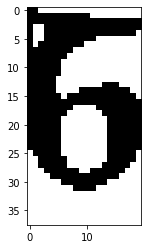

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/368y5_8.png


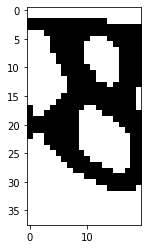

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/368y5_y.png


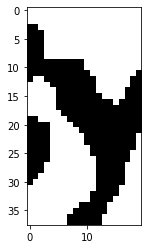

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/368y5_5.png


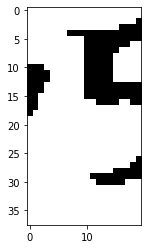

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ygde.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ygde_3.png


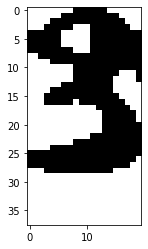

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/3ygde_y.png


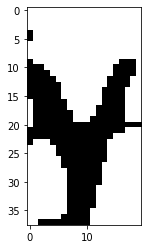

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/3ygde_g.png


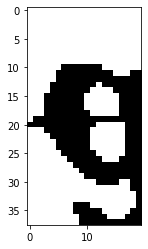

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3ygde_d.png


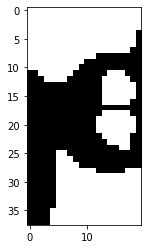

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3ygde_e.png


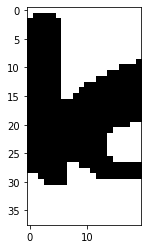

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3n2b4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3n2b4_3.png


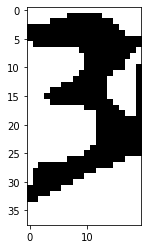

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3n2b4_n.png


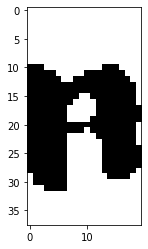

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/3n2b4_2.png


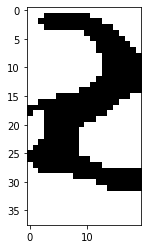

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3n2b4_b.png


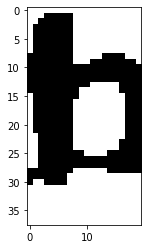

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/3n2b4_4.png


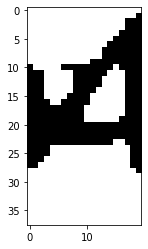

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3eny7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3eny7_3.png


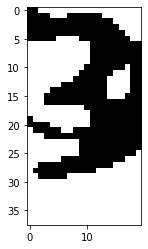

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3eny7_e.png


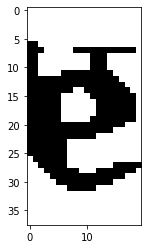

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3eny7_n.png


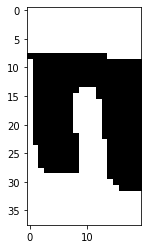

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/3eny7_y.png


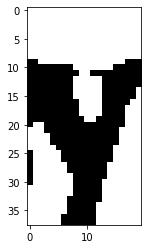

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3eny7_7.png


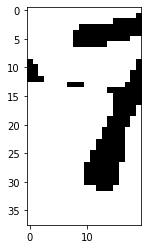

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3nw7w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3nw7w_3.png


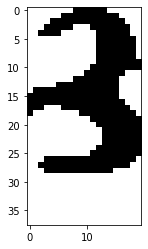

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3nw7w_n.png


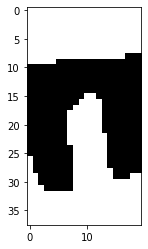

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3nw7w_w.png


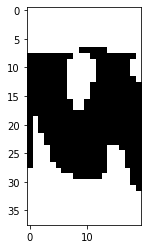

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3nw7w_7.png


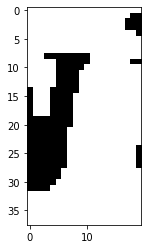

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/3nw7w_w.png


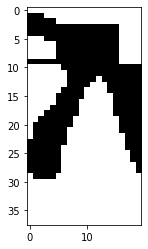

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ym7f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ym7f_3.png


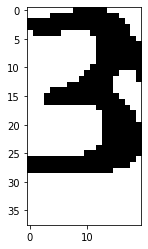

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/3ym7f_y.png


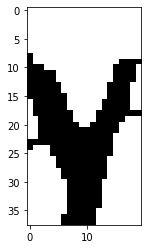

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/3ym7f_m.png


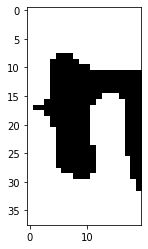

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3ym7f_7.png


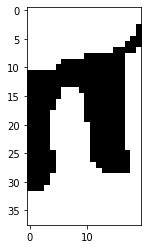

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/3ym7f_f.png


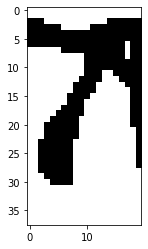

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/33ng4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/33ng4_3.png


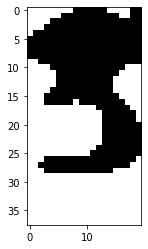

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/33ng4_3.png


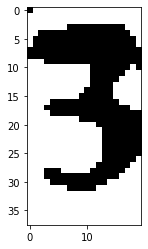

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/33ng4_n.png


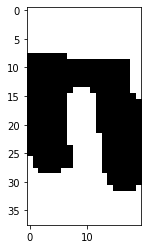

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/33ng4_g.png


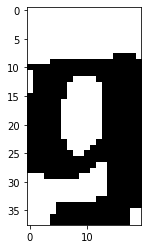

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/33ng4_4.png


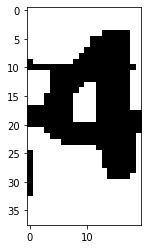

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/32cnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/32cnn_3.png


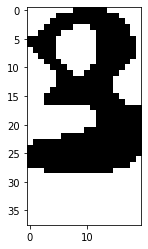

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/32cnn_2.png


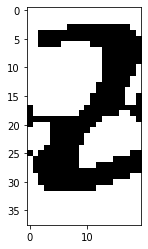

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/32cnn_c.png


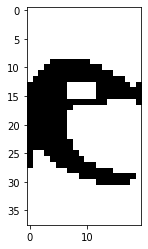

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/32cnn_n.png


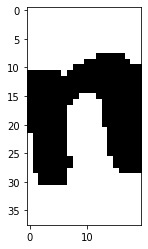

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/32cnn_n.png


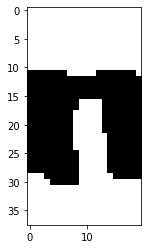

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3c7de.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3c7de_3.jpg


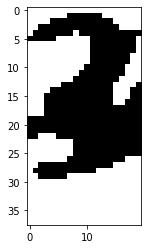

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/3c7de_c.jpg


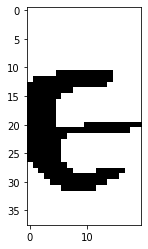

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/3c7de_7.jpg


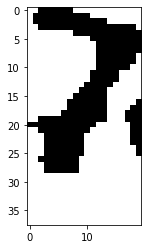

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/3c7de_d.jpg


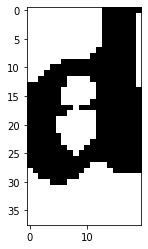

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3c7de_e.jpg


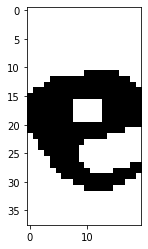

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ebnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ebnn_3.png


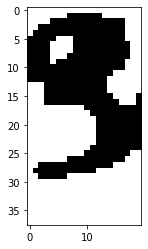

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/3ebnn_e.png


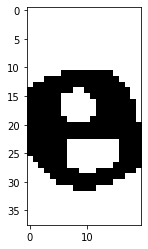

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/3ebnn_b.png


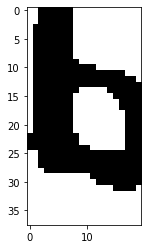

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3ebnn_n.png


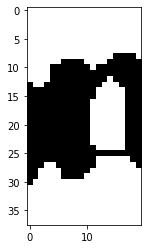

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3ebnn_n.png


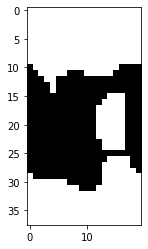

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3xng6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3xng6_3.png


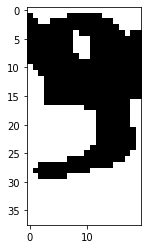

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/3xng6_x.png


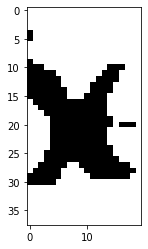

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3xng6_n.png


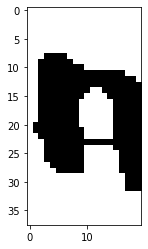

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/3xng6_g.png


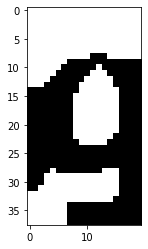

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/3xng6_6.png


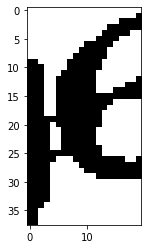

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/325fb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/325fb_3.png


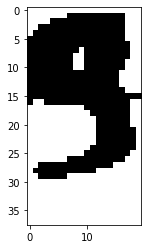

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/325fb_2.png


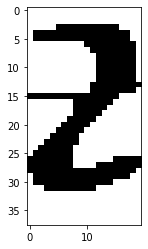

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/325fb_5.png


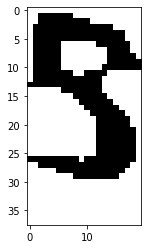

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/325fb_f.png


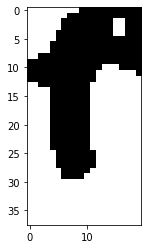

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/325fb_b.png


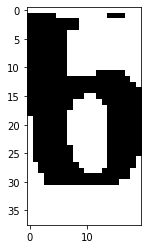

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ny45.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/3ny45_3.png


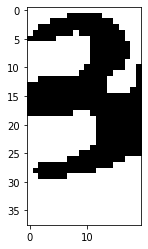

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/3ny45_n.png


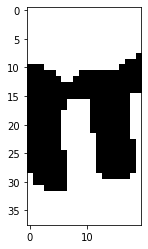

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/3ny45_y.png


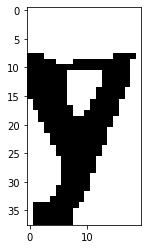

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/3ny45_4.png


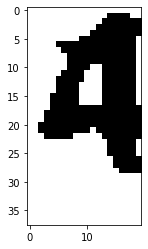

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/3ny45_5.png


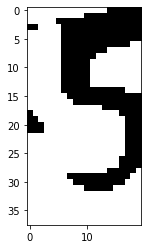

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6ng6n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ng6n_6.png


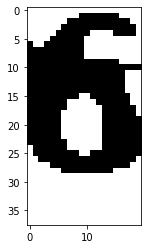

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6ng6n_n.png


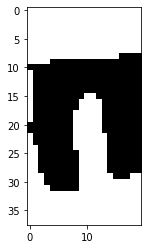

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6ng6n_g.png


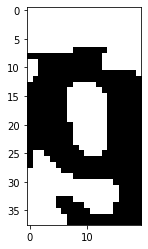

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ng6n_6.png


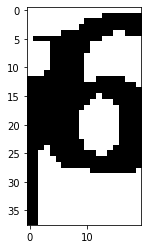

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6ng6n_n.png


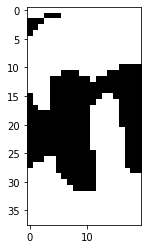

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c753e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c753e_c.png


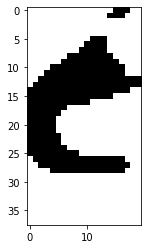

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c753e_7.png


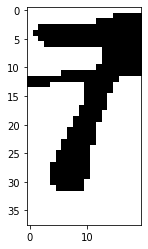

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c753e_5.png


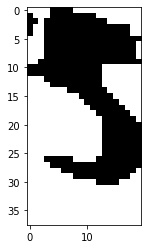

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c753e_3.png


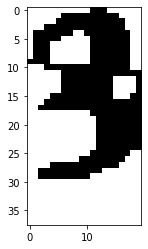

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/c753e_e.png


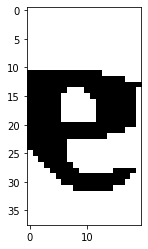

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/65m85.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/65m85_6.png


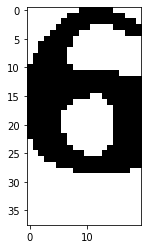

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/65m85_5.png


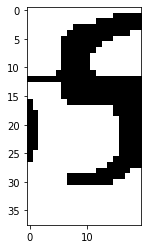

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/65m85_m.png


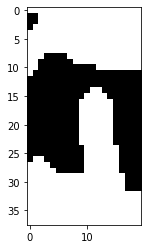

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/65m85_8.png


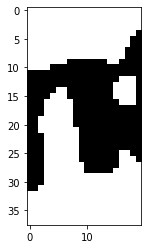

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/65m85_5.png


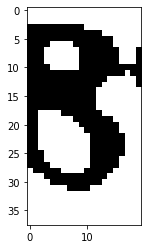

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4yc85.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4yc85_4.png


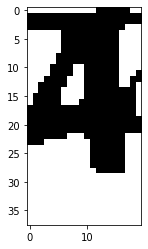

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4yc85_y.png


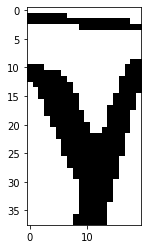

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4yc85_c.png


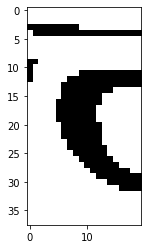

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/4yc85_8.png


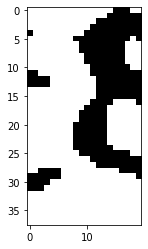

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/4yc85_5.png


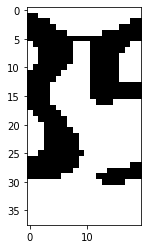

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6xpme.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6xpme_6.png


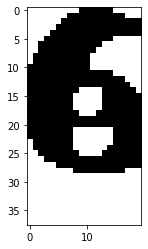

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6xpme_x.png


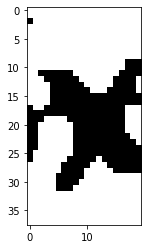

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6xpme_p.png


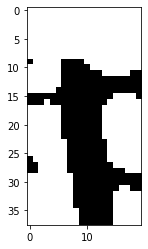

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6xpme_m.png


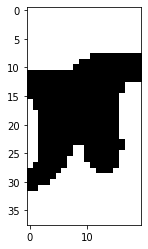

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6xpme_e.png


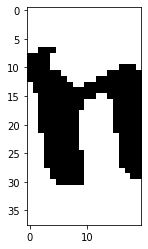

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6mygb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6mygb_6.png


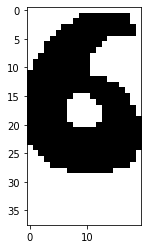

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6mygb_m.png


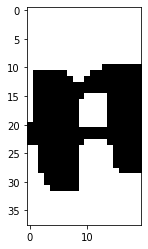

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6mygb_y.png


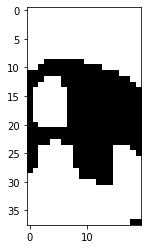

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6mygb_g.png


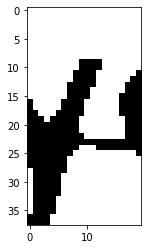

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6mygb_b.png


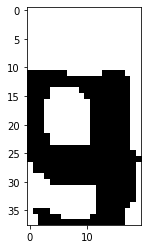

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8np22.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8np22_8.png


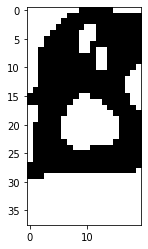

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8np22_n.png


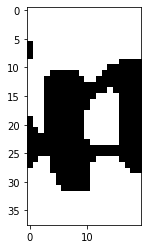

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8np22_p.png


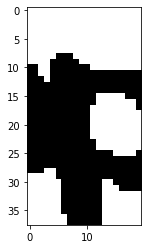

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8np22_2.png


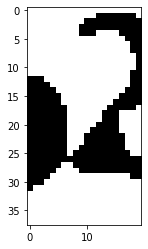

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8np22_2.png


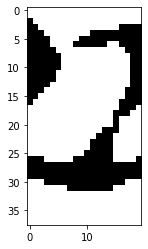

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d2nbn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d2nbn_d.png


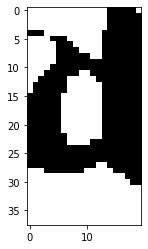

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d2nbn_2.png


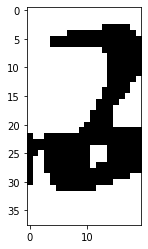

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d2nbn_n.png


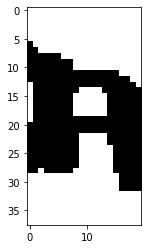

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/d2nbn_b.png


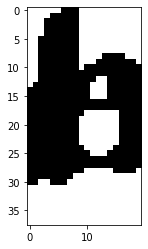

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d2nbn_n.png


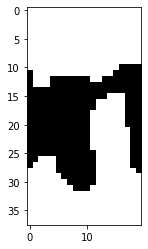

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cffp4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cffp4_c.png


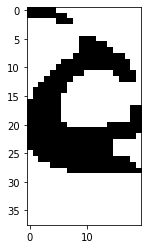

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cffp4_f.png


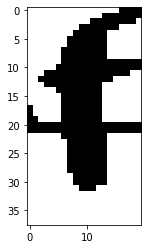

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cffp4_f.png


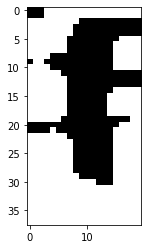

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/cffp4_p.png


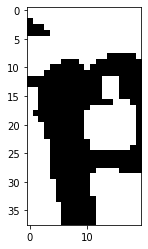

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/cffp4_4.png


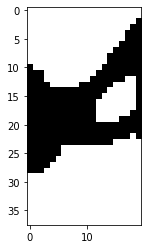

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cwmny.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cwmny_c.png


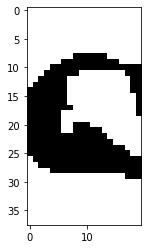

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cwmny_w.png


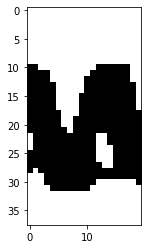

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cwmny_m.png


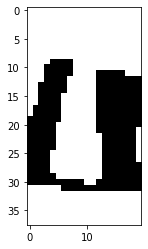

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cwmny_n.png


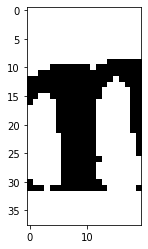

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cwmny_y.png


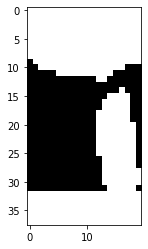

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dd5w5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dd5w5_d.png


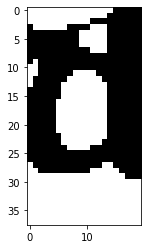

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dd5w5_d.png


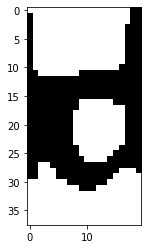

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/dd5w5_5.png


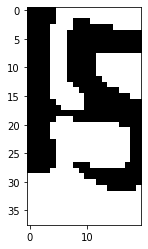

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dd5w5_w.png


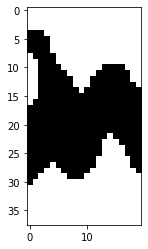

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/dd5w5_5.png


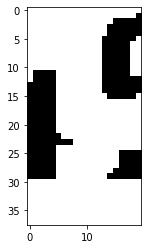

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ennmm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ennmm_e.png


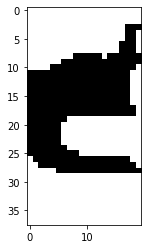

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ennmm_n.png


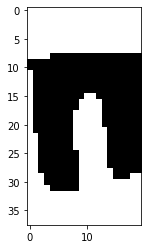

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ennmm_n.png


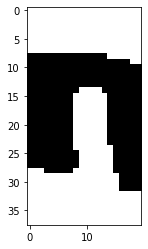

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ennmm_m.png


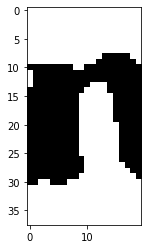

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ennmm_m.png


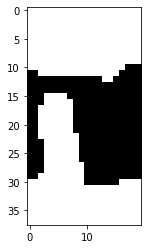

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e667x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e667x_e.png


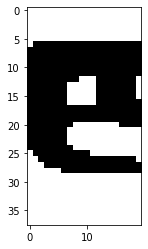

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e667x_6.png


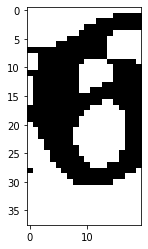

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e667x_6.png


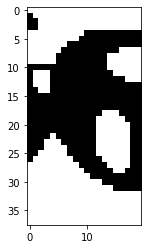

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e667x_7.png


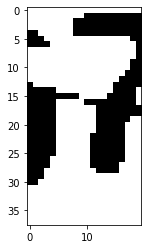

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/e667x_x.png


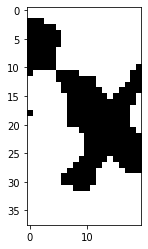

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bbymy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bbymy_b.png


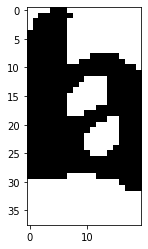

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bbymy_b.png


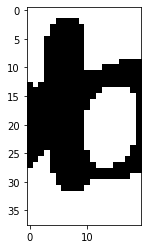

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/bbymy_y.png


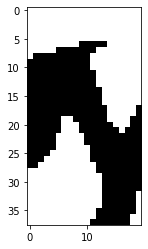

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bbymy_m.png


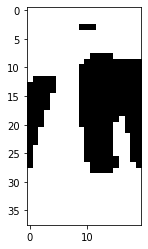

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/bbymy_y.png


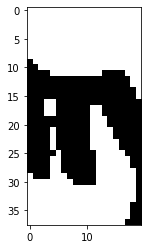

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/785n4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/785n4_7.png


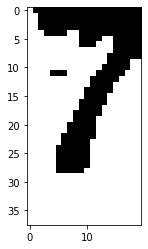

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/785n4_8.png


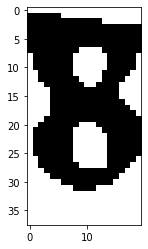

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/785n4_5.png


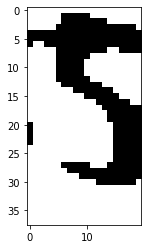

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/785n4_n.png


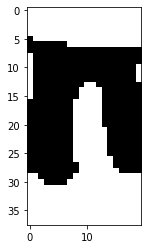

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/785n4_4.png


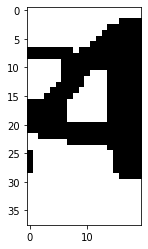

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5mcy7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5mcy7_5.png


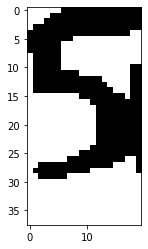

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5mcy7_m.png


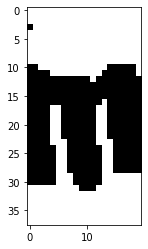

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/5mcy7_c.png


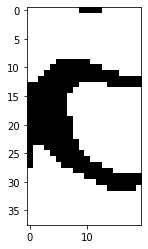

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/5mcy7_y.png


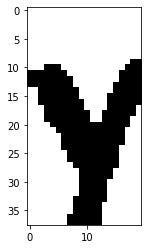

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5mcy7_7.png


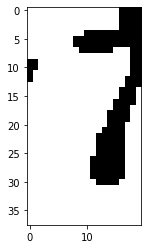

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7xd5m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7xd5m_7.png


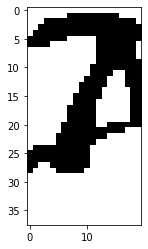

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7xd5m_x.png


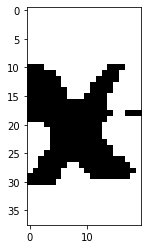

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7xd5m_d.png


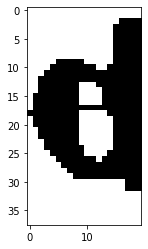

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/7xd5m_5.png


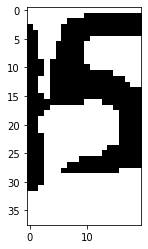

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7xd5m_m.png


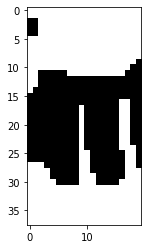

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5n245.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5n245_5.png


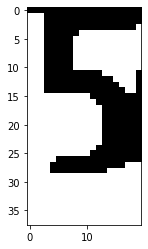

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5n245_n.png


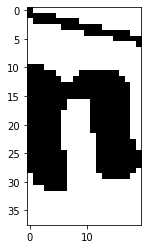

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5n245_2.png


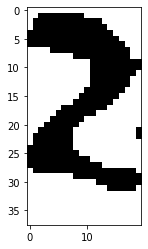

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/5n245_4.png


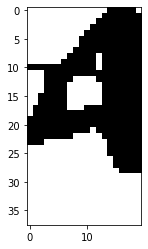

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5n245_5.png


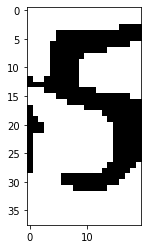

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/87nym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/87nym_8.png


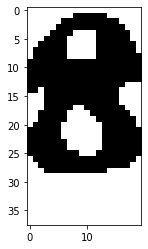

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/87nym_7.png


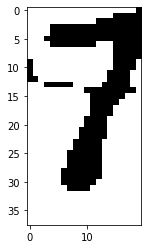

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/87nym_n.png


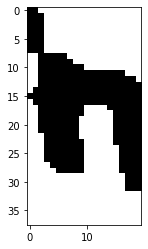

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/87nym_y.png


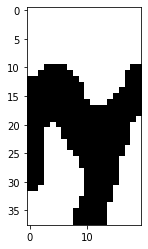

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/87nym_m.png


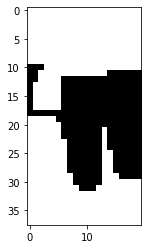

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4n3mn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4n3mn_4.png


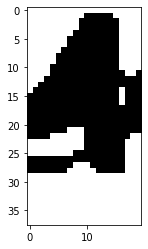

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4n3mn_n.png


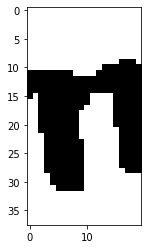

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4n3mn_3.png


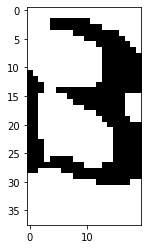

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4n3mn_m.png


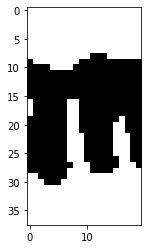

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4n3mn_n.png


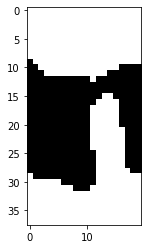

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/88y52.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/88y52_8.png


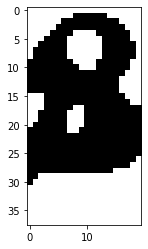

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/88y52_8.png


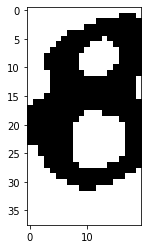

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/88y52_y.png


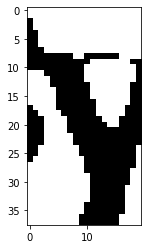

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/88y52_5.png


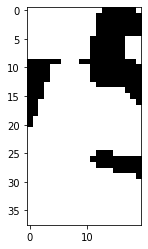

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/88y52_2.png


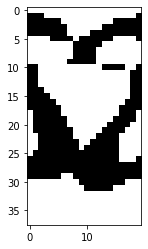

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bgd4m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bgd4m_b.png


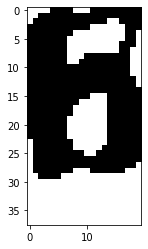

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/bgd4m_g.png


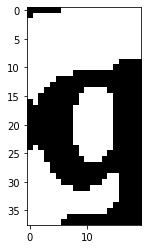

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bgd4m_d.png


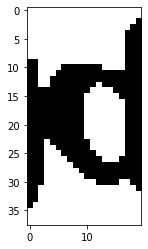

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bgd4m_4.png


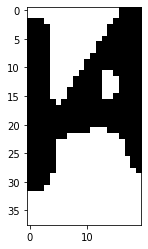

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bgd4m_m.png


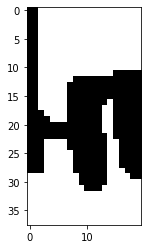

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dbex3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dbex3_d.png


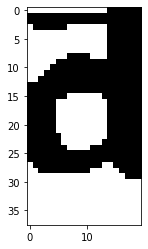

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/dbex3_b.png


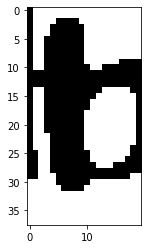

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/dbex3_e.png


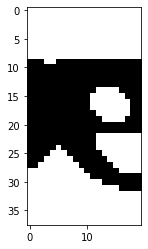

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dbex3_x.png


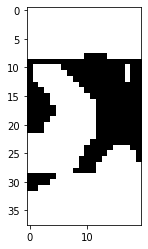

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dbex3_3.png


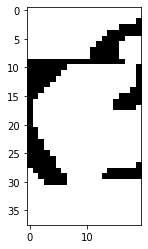

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/573d8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/573d8_5.png


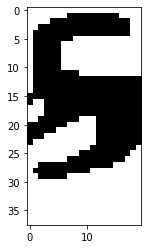

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/573d8_7.png


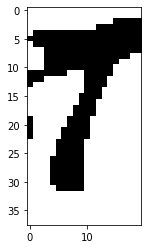

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/573d8_3.png


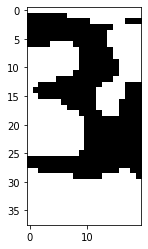

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/573d8_d.png


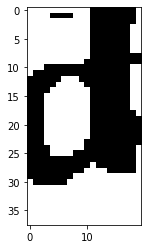

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/573d8_8.png


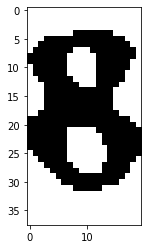

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8w754.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8w754_8.png


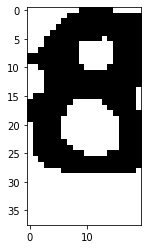

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8w754_w.png


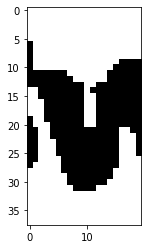

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8w754_7.png


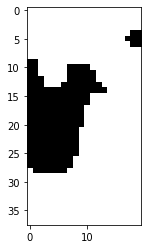

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8w754_5.png


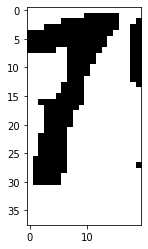

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8w754_4.png


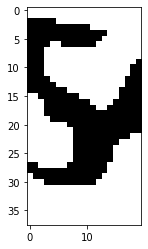

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/56c34.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/56c34_5.png


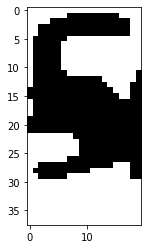

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/56c34_6.png


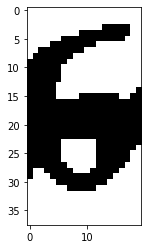

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/56c34_c.png


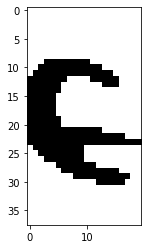

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/56c34_3.png


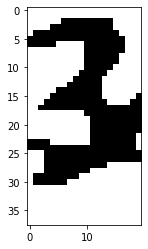

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/56c34_4.png


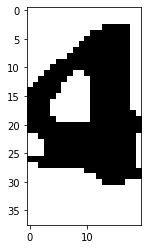

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ffpxf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffpxf_f.png


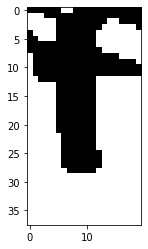

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffpxf_f.png


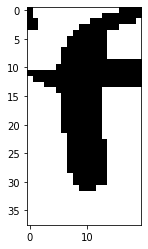

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ffpxf_p.png


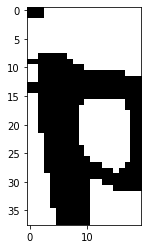

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ffpxf_x.png


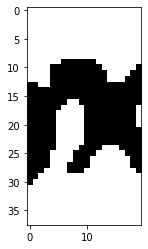

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffpxf_f.png


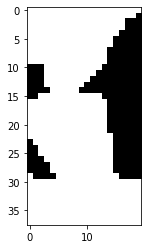

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/een23.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/een23_e.png


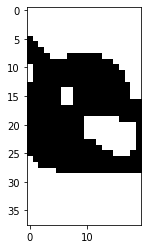

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/een23_e.png


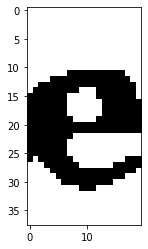

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/een23_n.png


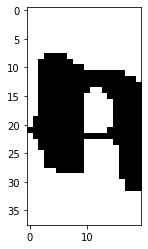

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/een23_2.png


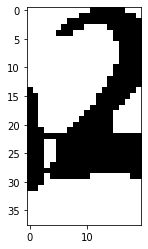

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/een23_3.png


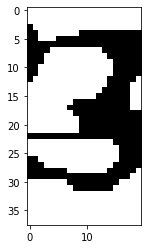

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fcey3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fcey3_f.png


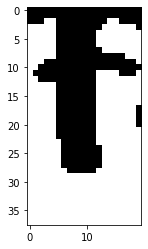

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fcey3_c.png


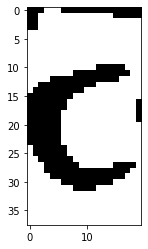

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/fcey3_e.png


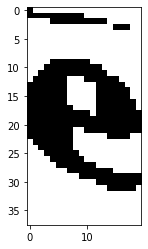

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/fcey3_y.png


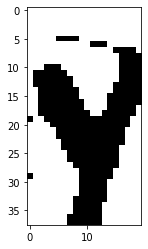

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fcey3_3.png


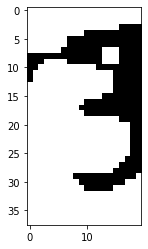

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c5xne.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c5xne_c.png


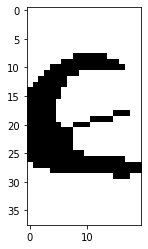

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c5xne_5.png


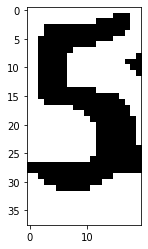

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/c5xne_x.png


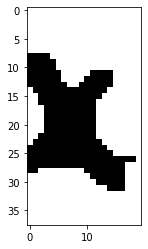

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c5xne_n.png


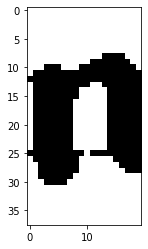

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/c5xne_e.png


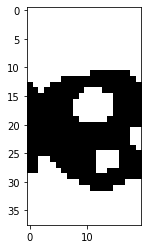

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddmyg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddmyg_d.png


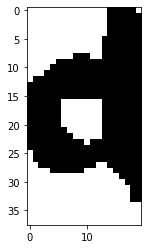

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddmyg_d.png


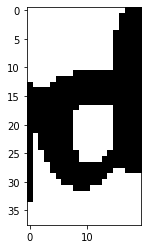

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ddmyg_m.png


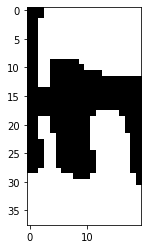

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ddmyg_y.png


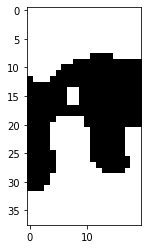

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ddmyg_g.png


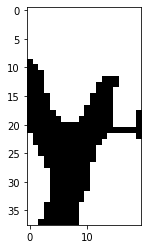

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fywb8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fywb8_f.png


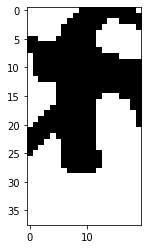

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/fywb8_y.png


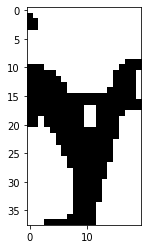

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fywb8_w.png


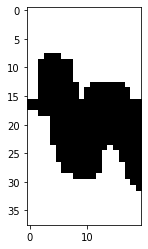

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fywb8_b.png


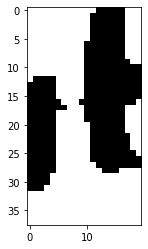

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/fywb8_8.png


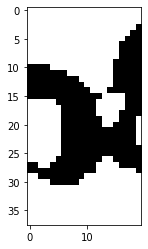

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/eppg3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/eppg3_e.png


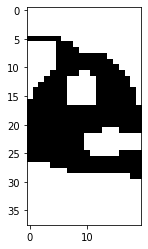

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/eppg3_p.png


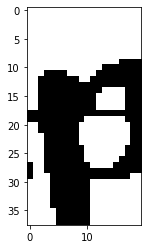

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/eppg3_p.png


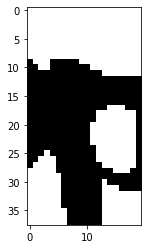

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/eppg3_g.png


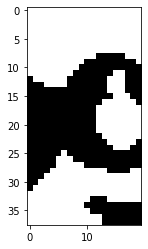

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/eppg3_3.png


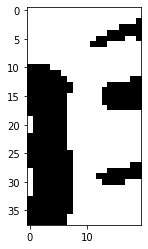

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cndmc.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cndmc_c.jpg


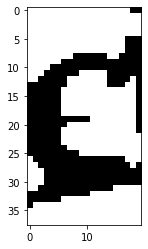

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cndmc_n.jpg


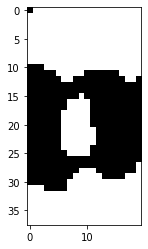

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cndmc_d.jpg


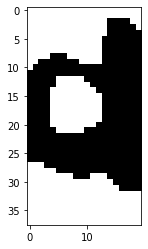

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cndmc_m.jpg


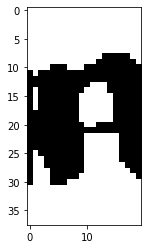

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cndmc_c.jpg


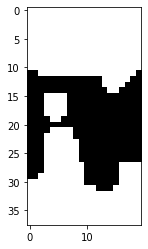

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dn5df.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dn5df_d.png


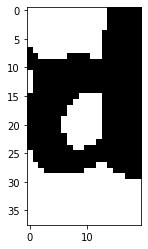

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dn5df_n.png


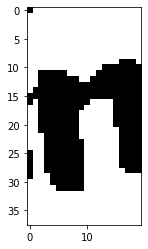

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/dn5df_5.png


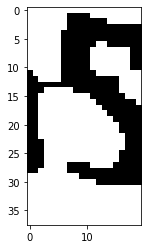

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dn5df_d.png


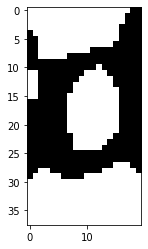

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/dn5df_f.png


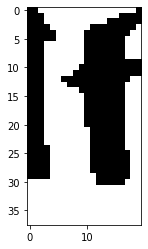

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5g5e5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5g5e5_5.png


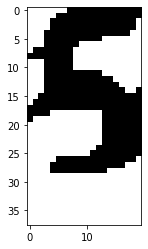

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5g5e5_g.png


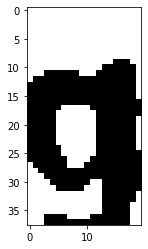

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5g5e5_5.png


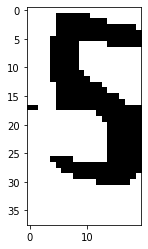

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5g5e5_e.png


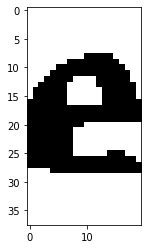

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5g5e5_5.png


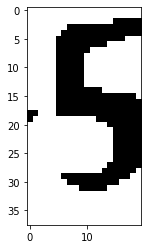

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/en32e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/en32e_e.png


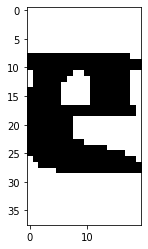

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/en32e_n.png


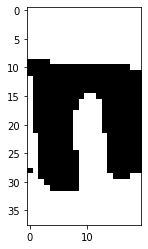

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/en32e_3.png


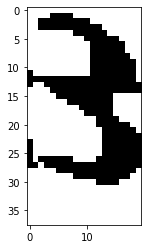

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/en32e_2.png


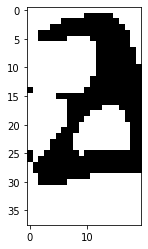

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/en32e_e.png


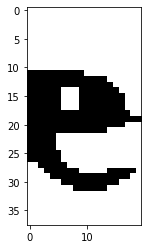

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cdf77.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cdf77_c.png


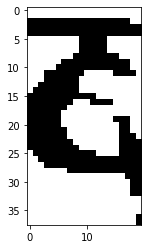

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cdf77_d.png


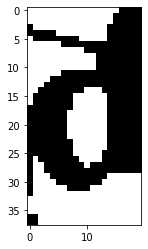

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cdf77_f.png


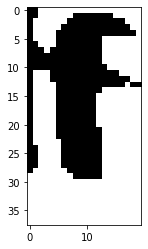

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/cdf77_7.png


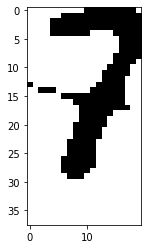

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/cdf77_7.png


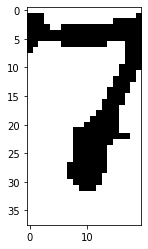

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d8xcn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d8xcn_d.png


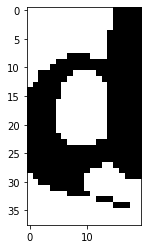

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d8xcn_8.png


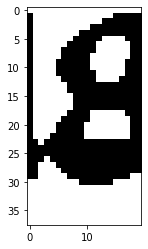

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/d8xcn_x.png


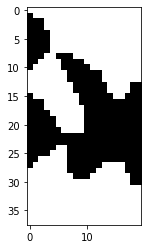

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d8xcn_c.png


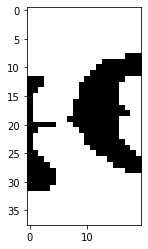

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d8xcn_n.png


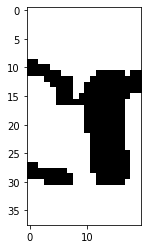

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6p2ge.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6p2ge_6.png


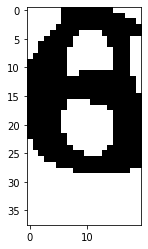

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6p2ge_p.png


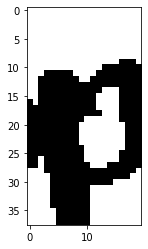

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/6p2ge_2.png


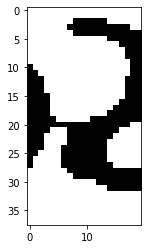

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6p2ge_g.png


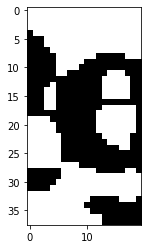

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6p2ge_e.png


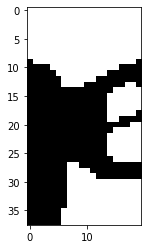

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c6745.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c6745_c.png


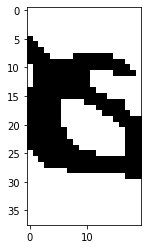

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c6745_6.png


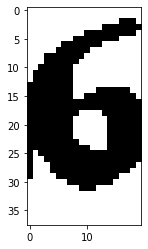

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c6745_7.png


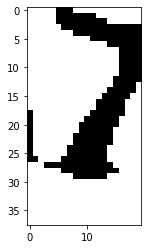

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c6745_4.png


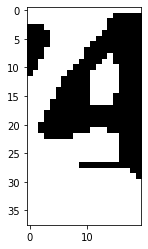

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c6745_5.png


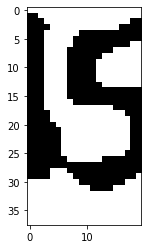

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ewcf5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ewcf5_e.png


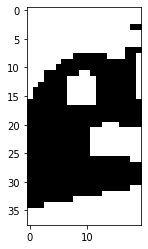

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ewcf5_w.png


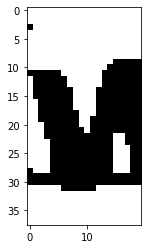

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ewcf5_c.png


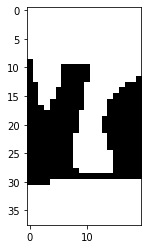

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ewcf5_f.png


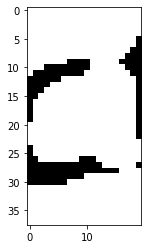

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/ewcf5_5.png


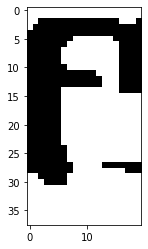

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bgxcd.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bgxcd_b.jpg


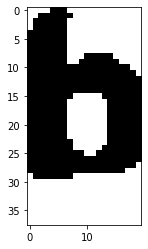

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/bgxcd_g.jpg


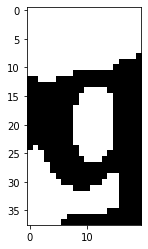

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/bgxcd_x.jpg


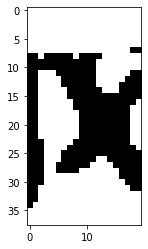

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bgxcd_c.jpg


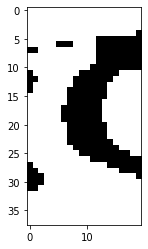

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bgxcd_d.jpg


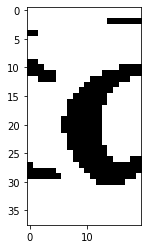

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cg5dd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cg5dd_c.png


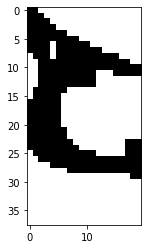

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cg5dd_g.png


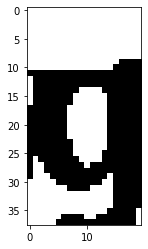

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cg5dd_5.png


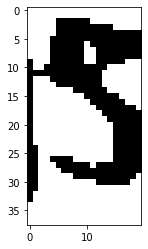

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cg5dd_d.png


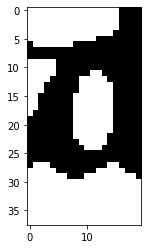

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cg5dd_d.png


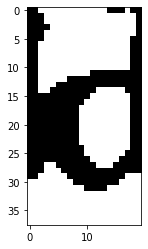

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6ge3p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ge3p_6.png


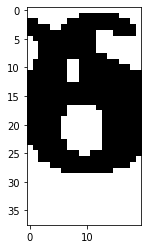

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6ge3p_g.png


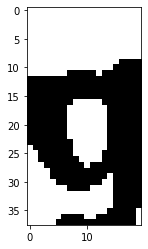

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6ge3p_e.png


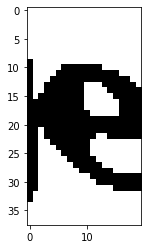

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6ge3p_3.png


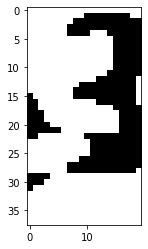

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6ge3p_p.png


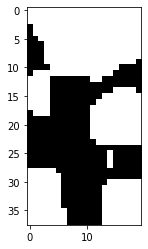

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g3dy6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g3dy6_g.png


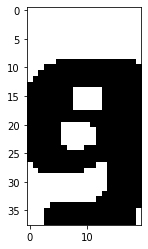

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/g3dy6_3.png


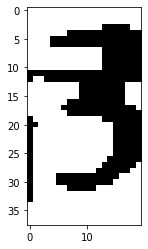

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/g3dy6_d.png


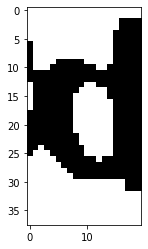

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/g3dy6_y.png


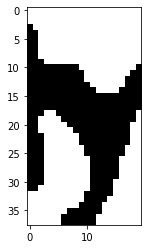

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/g3dy6_6.png


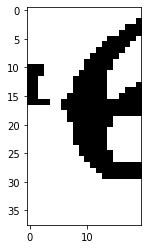

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dxwcw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dxwcw_d.png


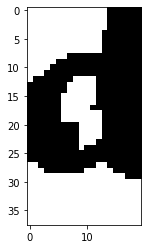

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dxwcw_x.png


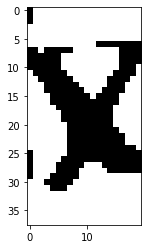

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dxwcw_w.png


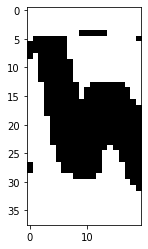

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dxwcw_c.png


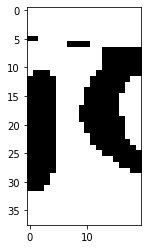

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dxwcw_w.png


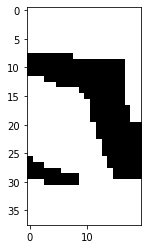

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6mege.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6mege_6.png


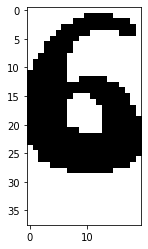

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6mege_m.png


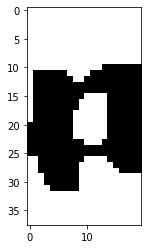

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6mege_e.png


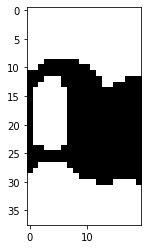

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6mege_g.png


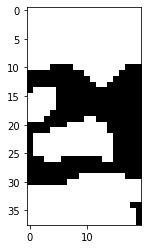

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6mege_e.png


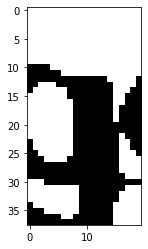

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f22bn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f22bn_f.png


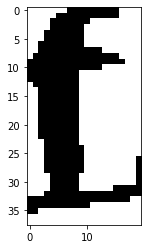

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f22bn_2.png


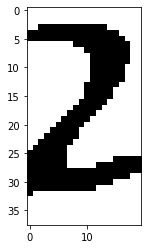

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f22bn_2.png


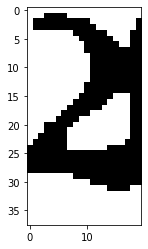

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/f22bn_b.png


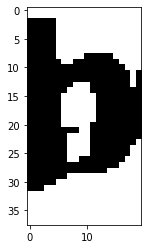

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f22bn_n.png


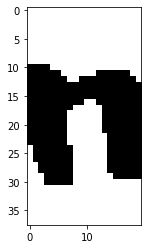

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d7nn3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d7nn3_d.png


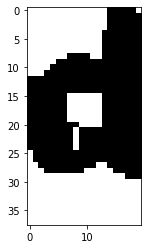

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d7nn3_7.png


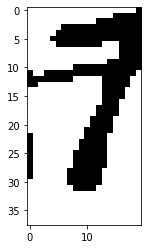

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d7nn3_n.png


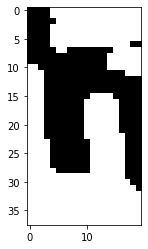

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d7nn3_n.png


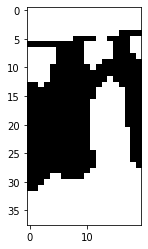

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d7nn3_3.png


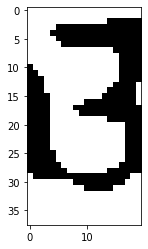

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c4mcm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c4mcm_c.png


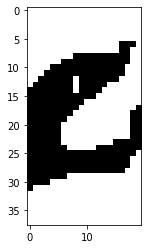

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c4mcm_4.png


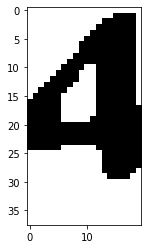

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/c4mcm_m.png


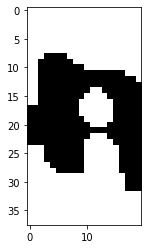

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c4mcm_c.png


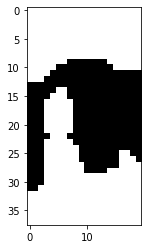

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/c4mcm_m.png


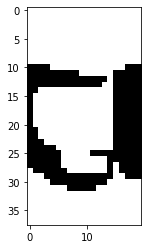

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6ng6w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ng6w_6.png


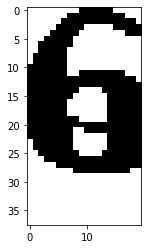

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6ng6w_n.png


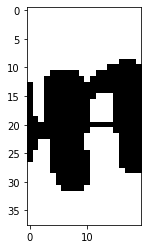

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6ng6w_g.png


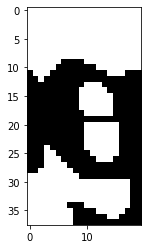

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ng6w_6.png


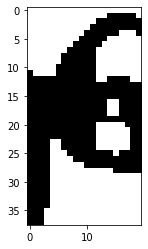

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6ng6w_w.png


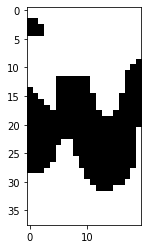

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b3xpn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b3xpn_b.png


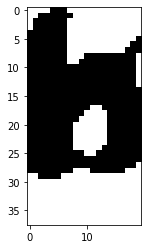

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/b3xpn_3.png


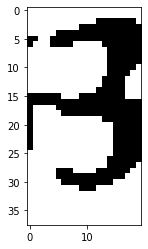

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/b3xpn_x.png


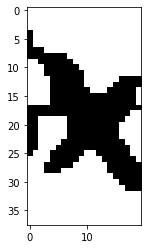

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/b3xpn_p.png


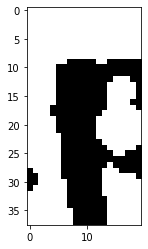

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b3xpn_n.png


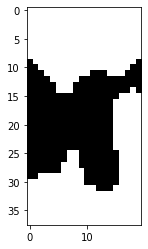

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6f857.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6f857_6.png


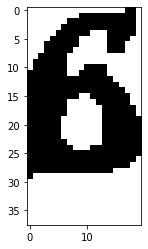

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6f857_f.png


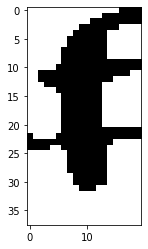

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/6f857_8.png


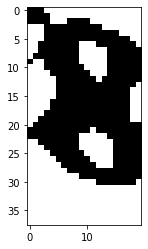

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6f857_5.png


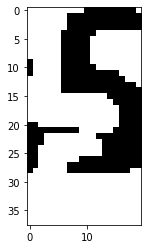

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/6f857_7.png


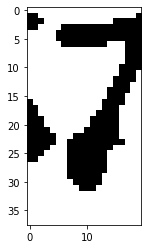

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8ne4g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8ne4g_8.png


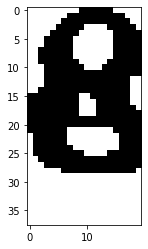

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8ne4g_n.png


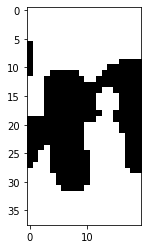

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8ne4g_e.png


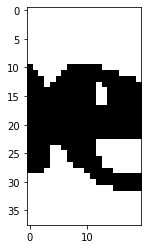

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8ne4g_4.png


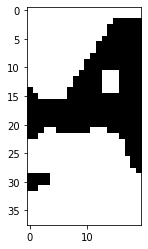

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8ne4g_g.png


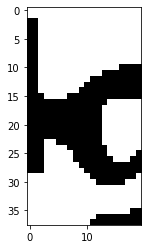

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e4gd7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e4gd7_e.png


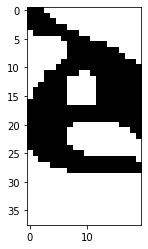

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e4gd7_4.png


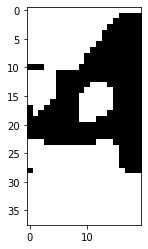

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/e4gd7_g.png


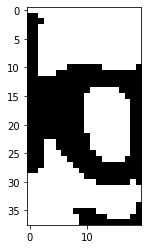

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e4gd7_d.png


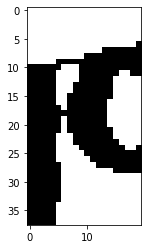

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e4gd7_7.png


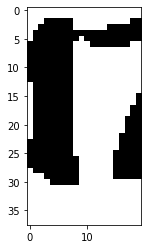

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d2ycw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d2ycw_d.png


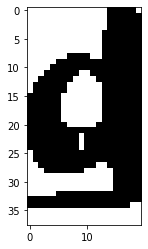

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d2ycw_2.png


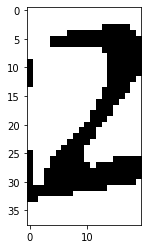

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d2ycw_y.png


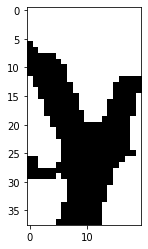

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d2ycw_c.png


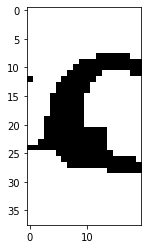

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/d2ycw_w.png


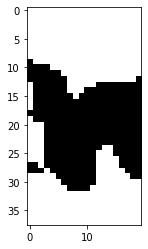

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cdfen.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cdfen_c.png


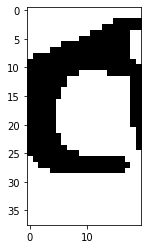

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cdfen_d.png


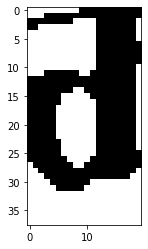

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cdfen_f.png


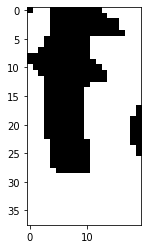

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cdfen_e.png


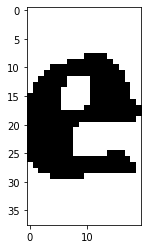

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cdfen_n.png


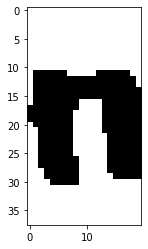

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d4n82.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d4n82_d.png


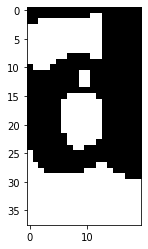

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/d4n82_4.png


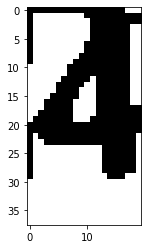

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d4n82_n.png


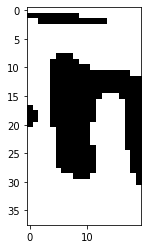

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d4n82_8.png


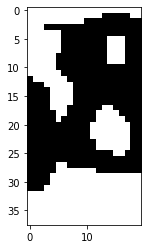

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d4n82_2.png


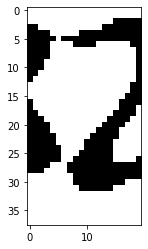

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8cm46.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8cm46_8.png


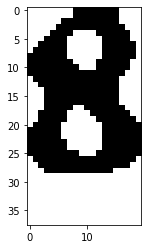

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8cm46_c.png


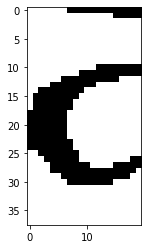

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8cm46_m.png


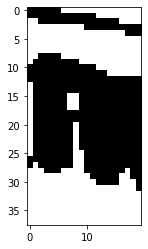

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8cm46_4.png


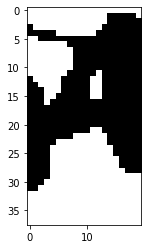

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8cm46_6.png


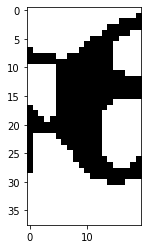

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e6b7y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e6b7y_e.png


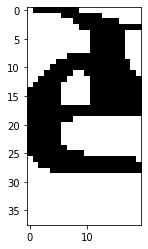

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e6b7y_6.png


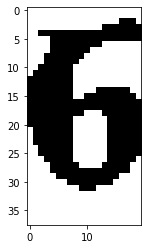

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/e6b7y_b.png


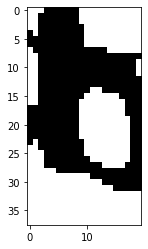

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e6b7y_7.png


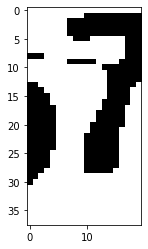

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/e6b7y_y.png


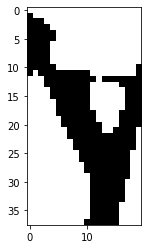

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dd764.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dd764_d.png


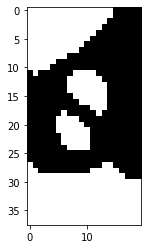

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dd764_d.png


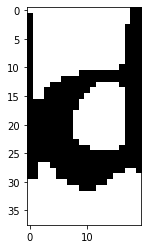

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/dd764_7.png


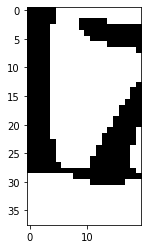

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/dd764_6.png


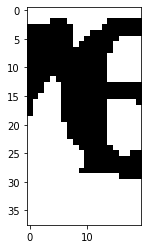

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/dd764_4.png


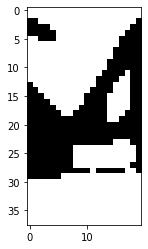

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/47m2b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/47m2b_4.png


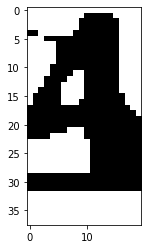

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/47m2b_7.png


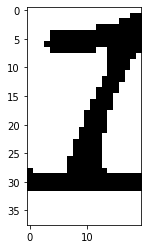

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/47m2b_m.png


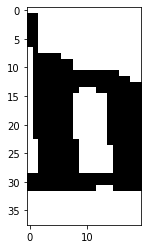

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/47m2b_2.png


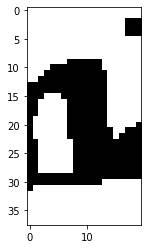

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/47m2b_b.png


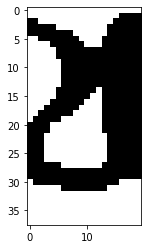

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c2pg6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c2pg6_c.png


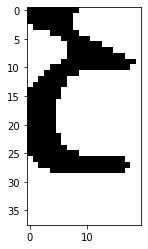

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c2pg6_2.png


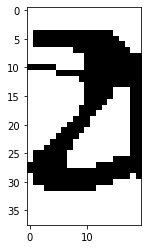

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/c2pg6_p.png


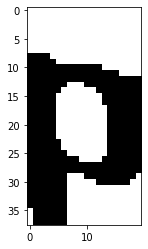

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/c2pg6_g.png


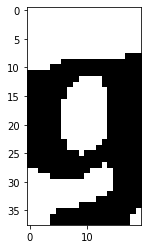

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c2pg6_6.png


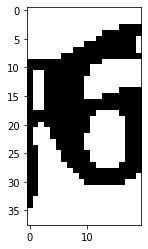

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/deep5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/deep5_d.png


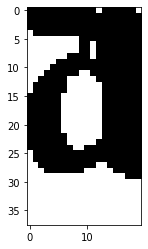

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/deep5_e.png


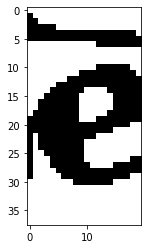

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/deep5_e.png


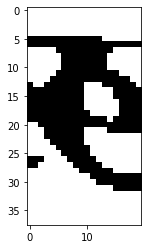

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/deep5_p.png


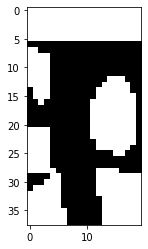

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/deep5_5.png


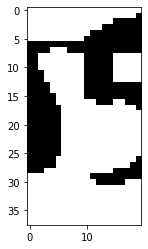

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fcne6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fcne6_f.png


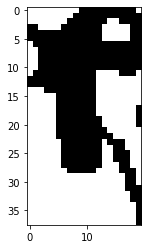

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fcne6_c.png


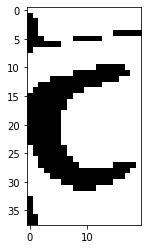

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fcne6_n.png


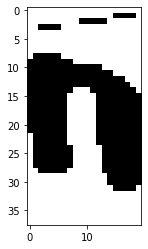

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/fcne6_e.png


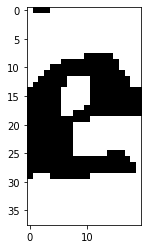

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/fcne6_6.png


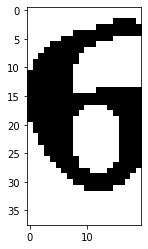

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dmx8p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dmx8p_d.png


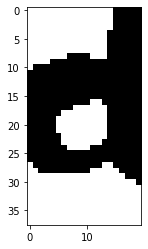

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dmx8p_m.png


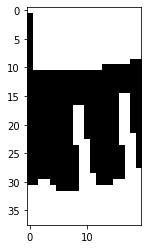

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dmx8p_x.png


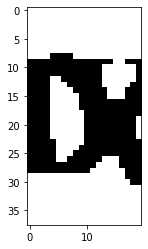

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dmx8p_8.png


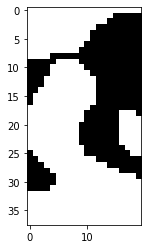

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dmx8p_p.png


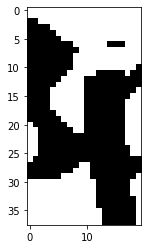

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b4y5x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b4y5x_b.png


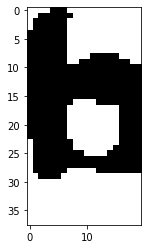

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b4y5x_4.png


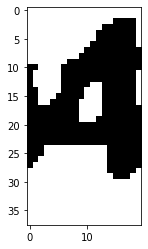

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/b4y5x_y.png


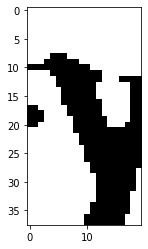

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b4y5x_5.png


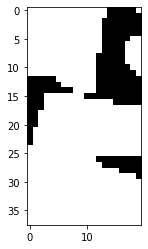

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/b4y5x_x.png


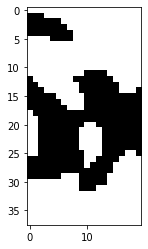

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/74853.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/74853_7.png


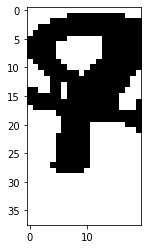

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/74853_4.png


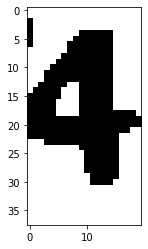

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/74853_8.png


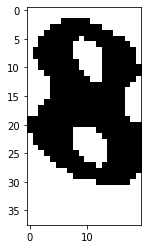

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/74853_5.png


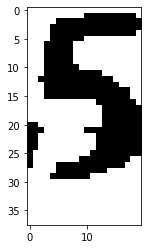

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/74853_3.png


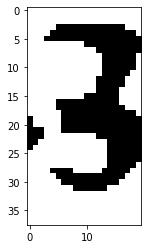

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/556wd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/556wd_5.png


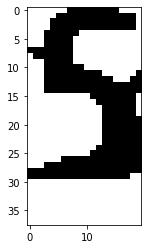

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/556wd_5.png


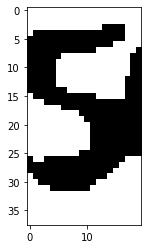

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/556wd_6.png


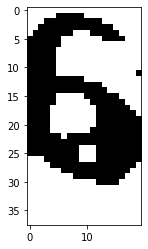

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/556wd_w.png


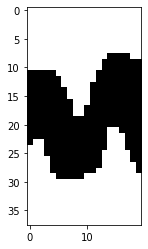

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/556wd_d.png


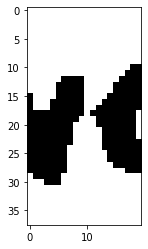

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4fp5g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4fp5g_4.png


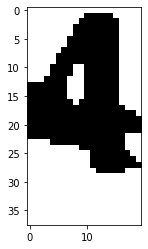

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4fp5g_f.png


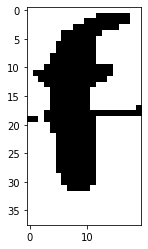

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/4fp5g_p.png


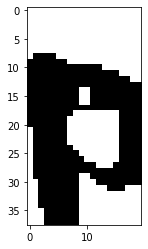

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/4fp5g_5.png


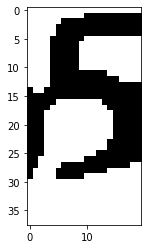

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4fp5g_g.png


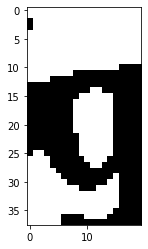

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d666m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d666m_d.png


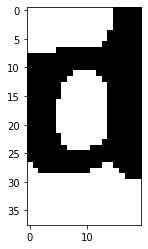

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d666m_6.png


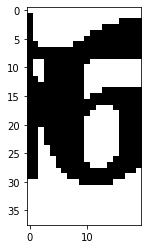

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d666m_6.png


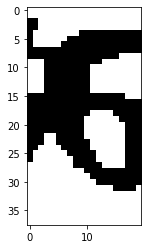

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d666m_6.png


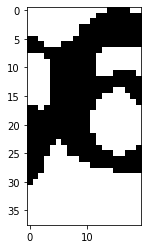

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/d666m_m.png


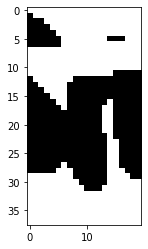

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4fc36.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4fc36_4.png


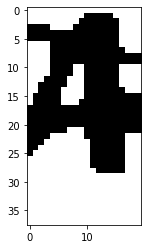

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4fc36_f.png


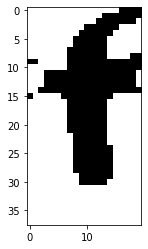

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4fc36_c.png


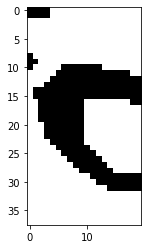

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4fc36_3.png


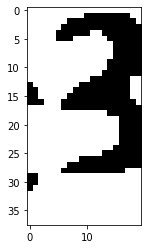

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/4fc36_6.png


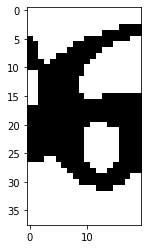

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8d8ep.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8d8ep_8.png


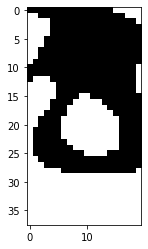

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8d8ep_d.png


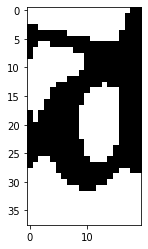

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8d8ep_8.png


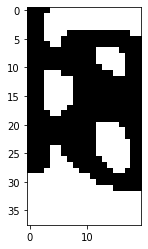

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8d8ep_e.png


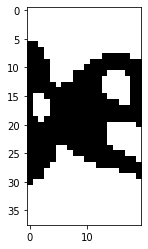

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8d8ep_p.png


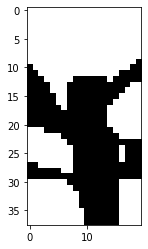

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g2fnw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g2fnw_g.png


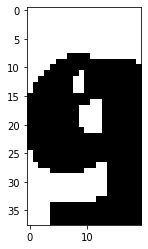

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/g2fnw_2.png


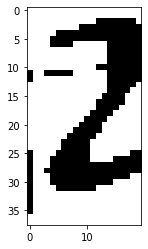

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/g2fnw_f.png


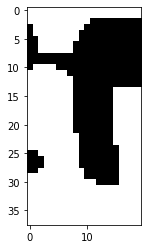

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/g2fnw_n.png


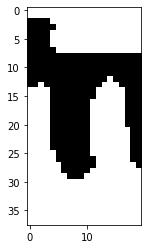

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/g2fnw_w.png


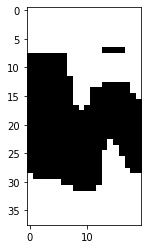

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6bdn5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6bdn5_6.png


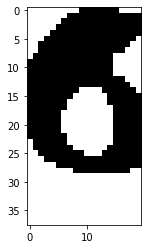

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6bdn5_b.png


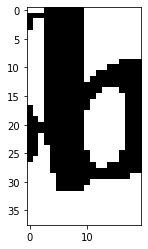

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6bdn5_d.png


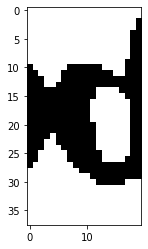

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6bdn5_n.png


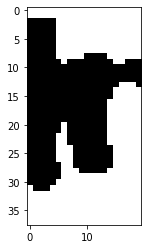

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6bdn5_5.png


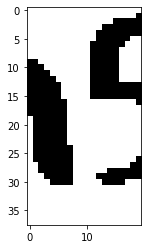

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/865wm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/865wm_8.png


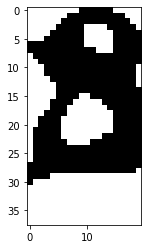

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/865wm_6.png


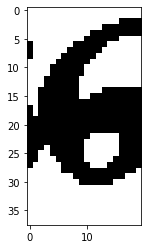

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/865wm_5.png


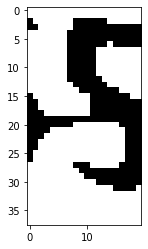

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/865wm_w.png


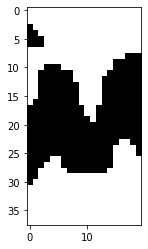

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/865wm_m.png


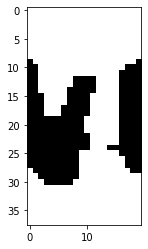

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/56ncx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/56ncx_5.png


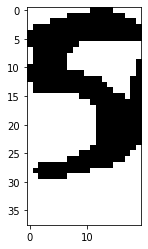

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/56ncx_6.png


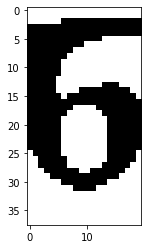

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/56ncx_n.png


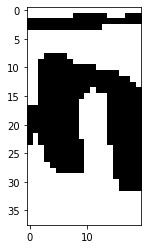

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/56ncx_c.png


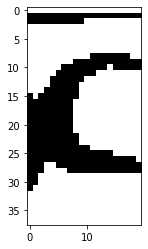

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/56ncx_x.png


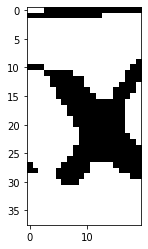

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8d2nd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8d2nd_8.png


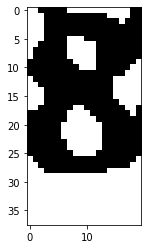

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8d2nd_d.png


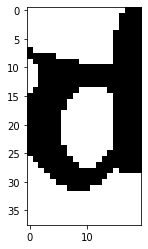

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8d2nd_2.png


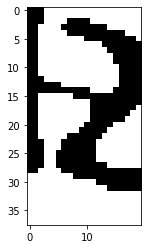

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8d2nd_n.png


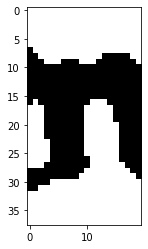

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8d2nd_d.png


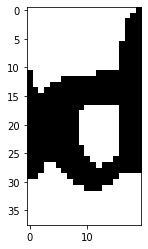

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/675p3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/675p3_6.png


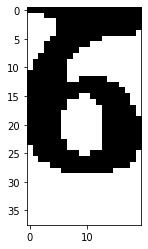

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/675p3_7.png


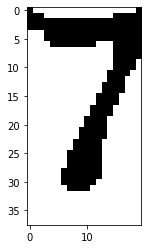

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/675p3_5.png


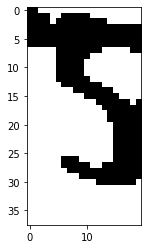

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/675p3_p.png


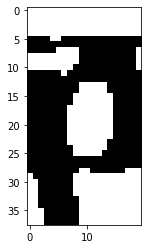

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/675p3_3.png


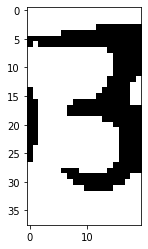

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/efb3f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efb3f_e.png


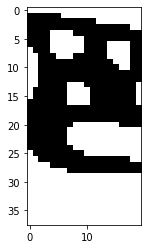

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efb3f_f.png


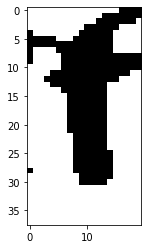

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/efb3f_b.png


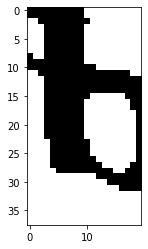

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/efb3f_3.png


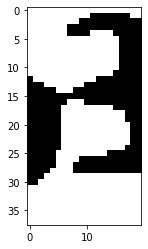

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efb3f_f.png


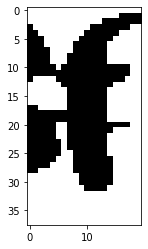

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cen55.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cen55_c.png


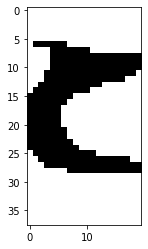

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cen55_e.png


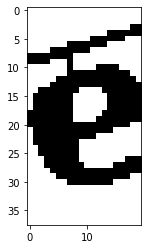

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cen55_n.png


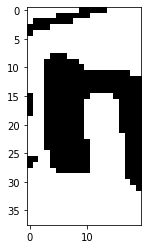

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cen55_5.png


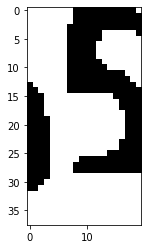

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cen55_5.png


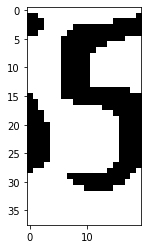

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8cccc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8cccc_8.png


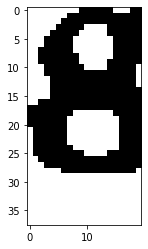

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8cccc_c.png


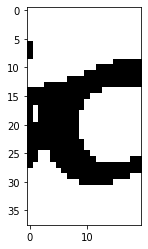

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8cccc_c.png


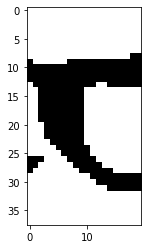

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8cccc_c.png


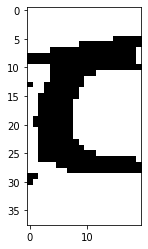

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8cccc_c.png


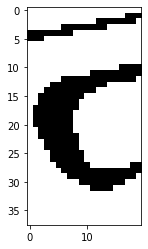

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5nggg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5nggg_5.png


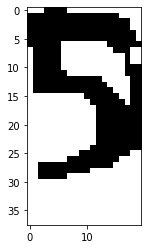

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nggg_n.png


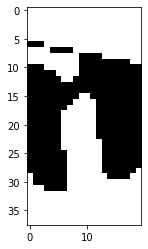

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5nggg_g.png


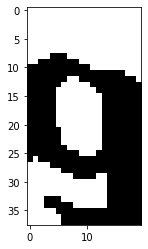

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5nggg_g.png


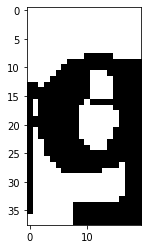

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5nggg_g.png


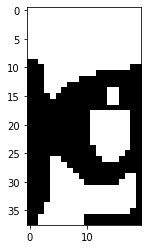

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6n5fd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6n5fd_6.png


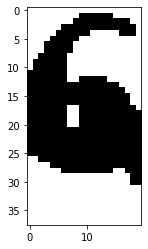

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6n5fd_n.png


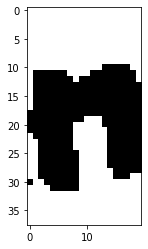

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6n5fd_5.png


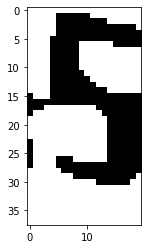

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6n5fd_f.png


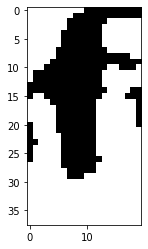

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6n5fd_d.png


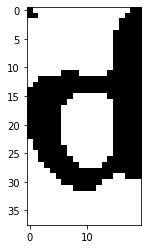

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8y6b3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8y6b3_8.png


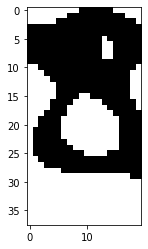

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8y6b3_y.png


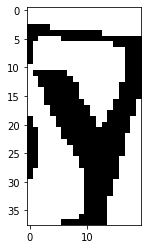

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8y6b3_6.png


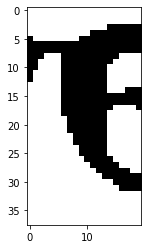

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8y6b3_b.png


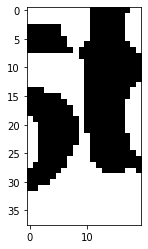

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8y6b3_3.png


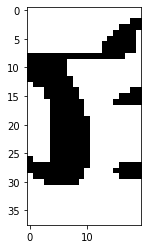

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4cfw8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4cfw8_4.png


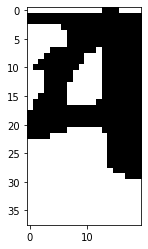

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4cfw8_c.png


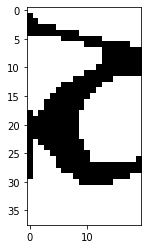

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4cfw8_f.png


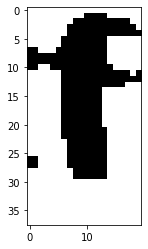

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4cfw8_w.png


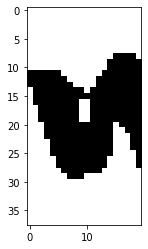

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/4cfw8_8.png


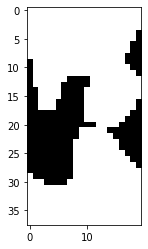

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bp6mw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bp6mw_b.png


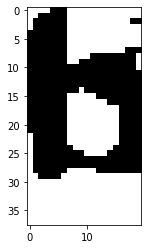

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/bp6mw_p.png


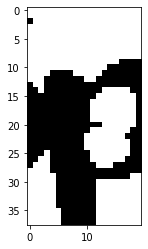

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/bp6mw_6.png


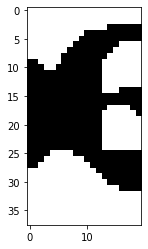

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bp6mw_m.png


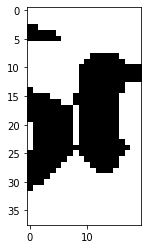

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bp6mw_w.png


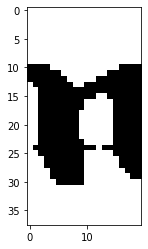

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/53wb8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/53wb8_5.png


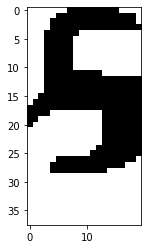

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/53wb8_3.png


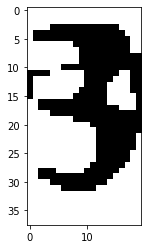

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/53wb8_w.png


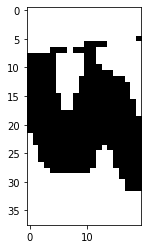

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/53wb8_b.png


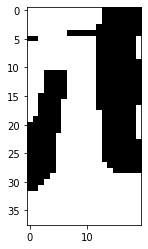

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/53wb8_8.png


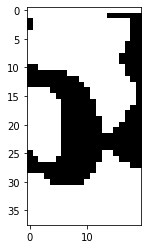

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6mn8n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6mn8n_6.png


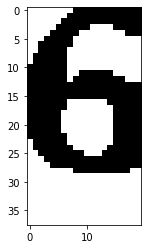

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6mn8n_m.png


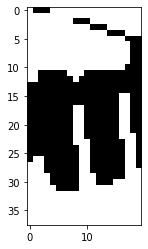

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6mn8n_n.png


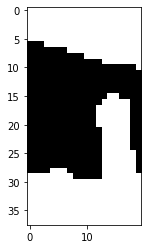

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/6mn8n_8.png


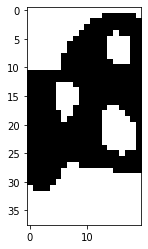

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6mn8n_n.png


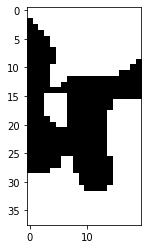

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b55d6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b55d6_b.png


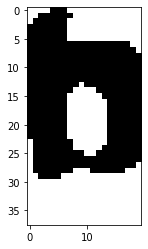

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b55d6_5.png


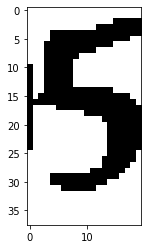

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b55d6_5.png


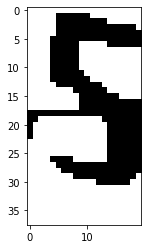

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/b55d6_d.png


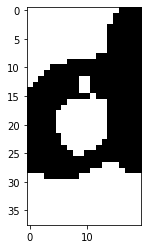

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/b55d6_6.png


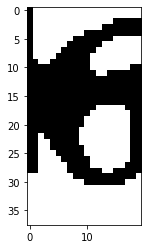

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bnc5f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bnc5f_b.png


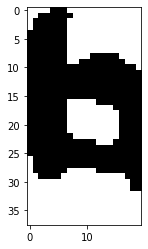

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bnc5f_n.png


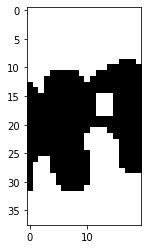

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bnc5f_c.png


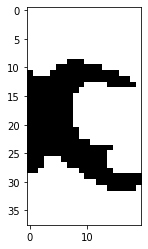

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bnc5f_5.png


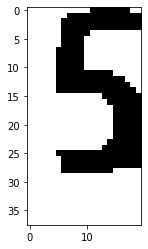

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bnc5f_f.png


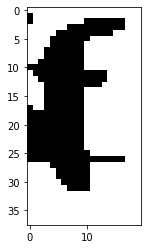

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/646x8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/646x8_6.png


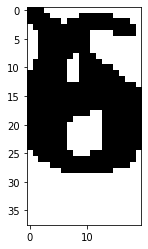

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/646x8_4.png


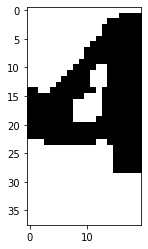

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/646x8_6.png


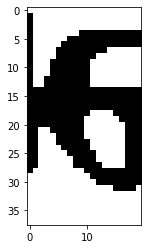

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/646x8_x.png


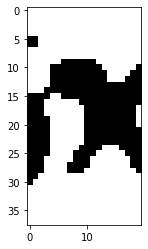

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/646x8_8.png


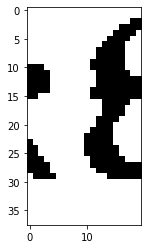

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5nm6d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5nm6d_5.png


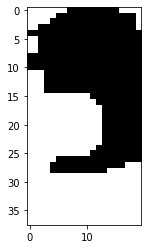

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nm6d_n.png


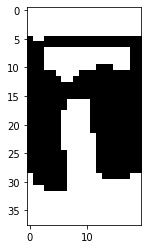

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5nm6d_m.png


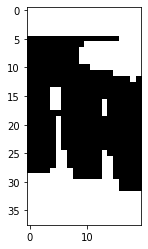

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/5nm6d_6.png


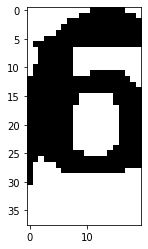

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5nm6d_d.png


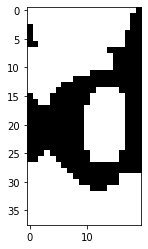

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n62n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n62n_8.png


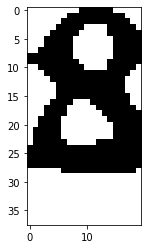

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n62n_n.png


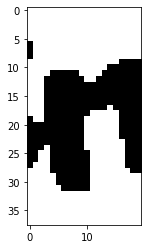

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8n62n_6.png


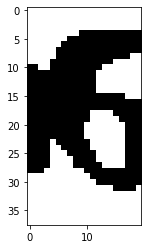

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8n62n_2.png


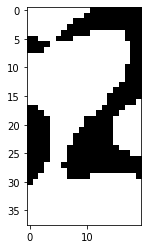

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n62n_n.png


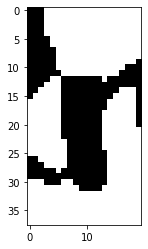

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bnc2f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bnc2f_b.png


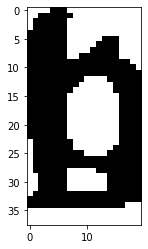

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bnc2f_n.png


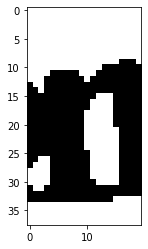

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bnc2f_c.png


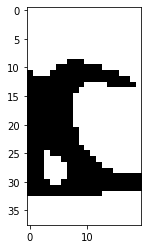

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/bnc2f_2.png


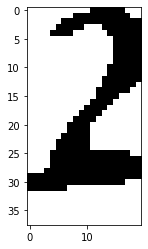

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bnc2f_f.png


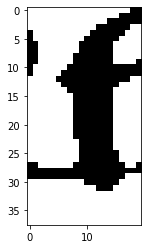

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6b4w6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6b4w6_6.png


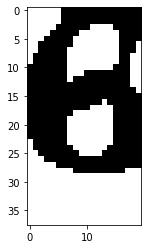

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6b4w6_b.png


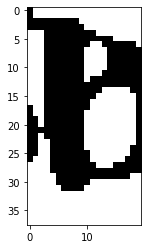

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6b4w6_4.png


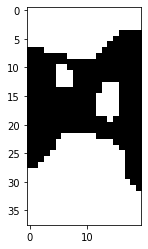

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6b4w6_w.png


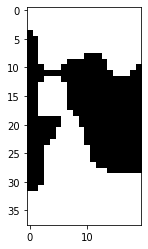

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6b4w6_6.png


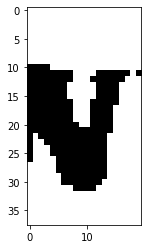

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6825y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6825y_6.png


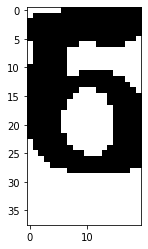

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/6825y_8.png


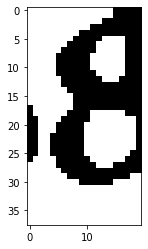

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/6825y_2.png


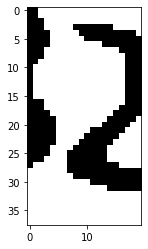

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6825y_5.png


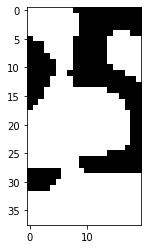

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6825y_y.png


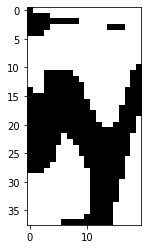

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b2nen.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b2nen_b.png


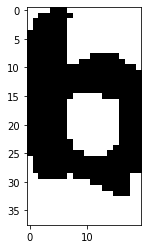

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/b2nen_2.png


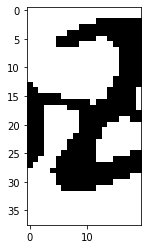

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b2nen_n.png


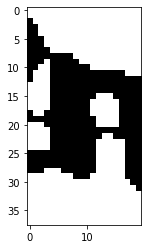

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/b2nen_e.png


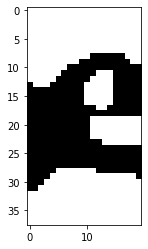

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b2nen_n.png


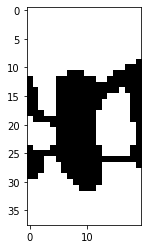

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/474ff.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/474ff_4.png


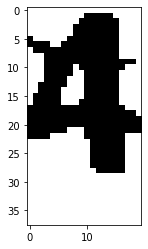

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/474ff_7.png


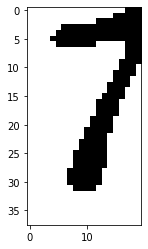

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/474ff_4.png


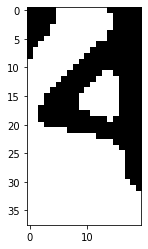

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/474ff_f.png


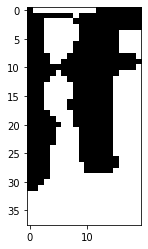

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/474ff_f.png


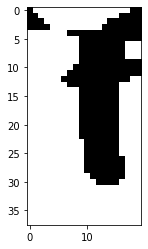

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/77wp4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77wp4_7.png


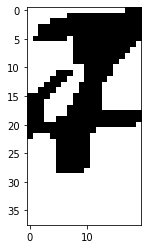

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77wp4_7.png


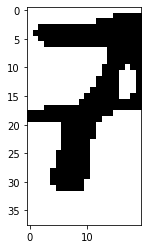

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/77wp4_w.png


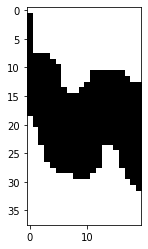

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/77wp4_p.png


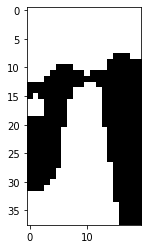

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/77wp4_4.png


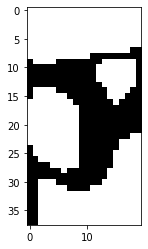

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/73mnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/73mnx_7.png


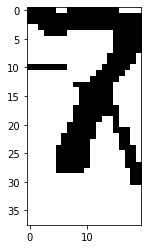

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/73mnx_3.png


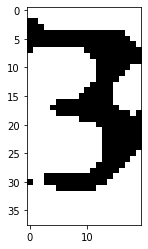

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/73mnx_m.png


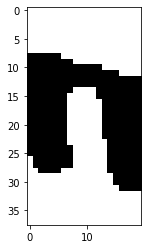

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/73mnx_n.png


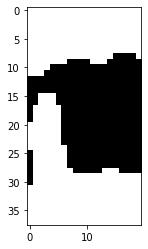

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/73mnx_x.png


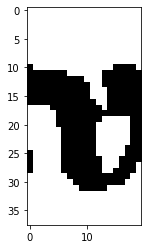

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/72m6f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/72m6f_7.png


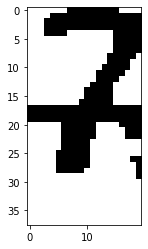

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/72m6f_2.png


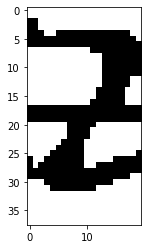

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/72m6f_m.png


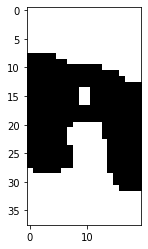

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/72m6f_6.png


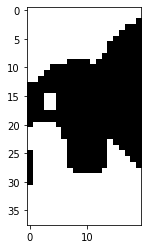

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/72m6f_f.png


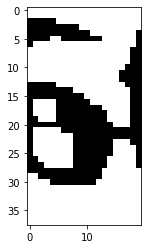

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bc8nf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bc8nf_b.png


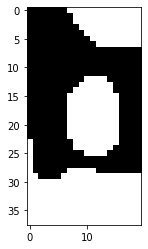

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bc8nf_c.png


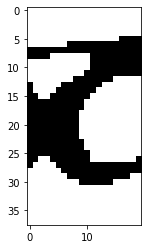

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/bc8nf_8.png


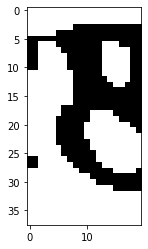

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bc8nf_n.png


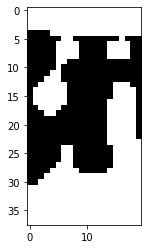

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bc8nf_f.png


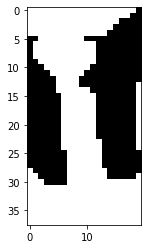

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8nbew.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8nbew_8.png


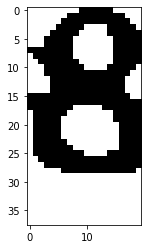

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8nbew_n.png


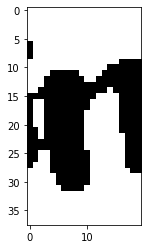

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8nbew_b.png


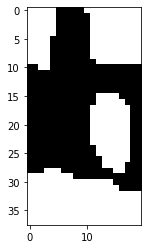

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8nbew_e.png


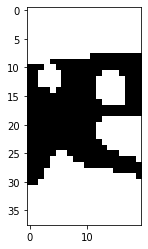

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8nbew_w.png


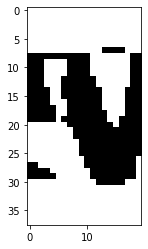

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b2g8e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b2g8e_b.png


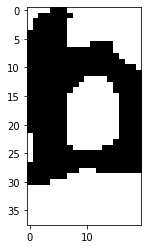

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/b2g8e_2.png


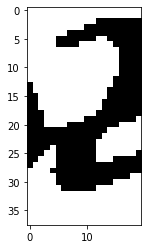

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/b2g8e_g.png


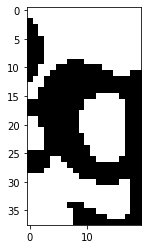

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/b2g8e_8.png


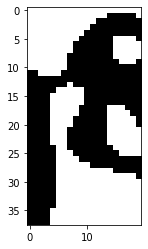

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/b2g8e_e.png


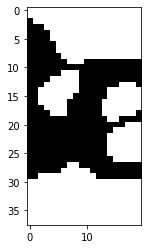

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4d22m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4d22m_4.png


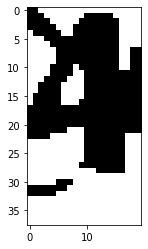

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/4d22m_d.png


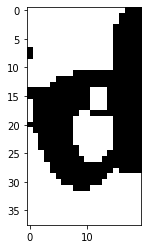

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/4d22m_2.png


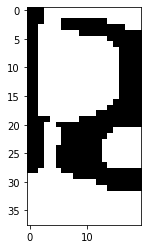

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/4d22m_2.png


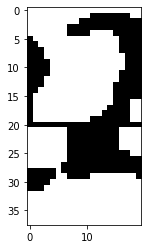

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4d22m_m.png


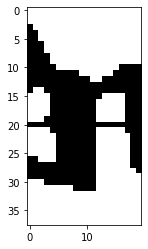

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/63pxe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/63pxe_6.png


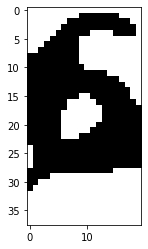

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/63pxe_3.png


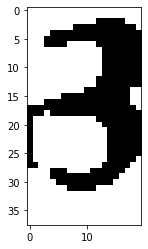

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/63pxe_p.png


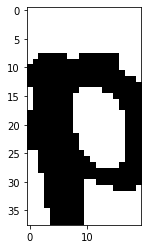

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/63pxe_x.png


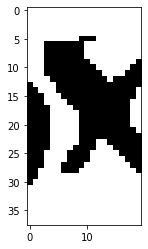

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/63pxe_e.png


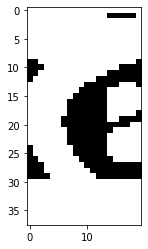

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bw5ym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bw5ym_b.png


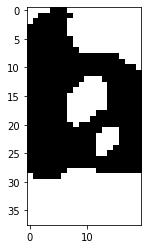

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bw5ym_w.png


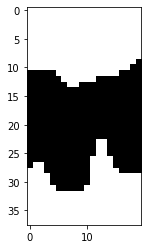

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bw5ym_5.png


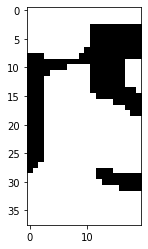

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/bw5ym_y.png


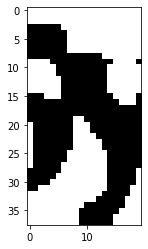

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bw5ym_m.png


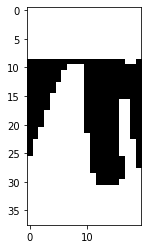

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7634y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7634y_7.png


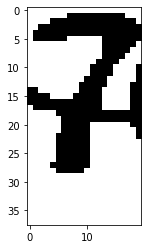

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/7634y_6.png


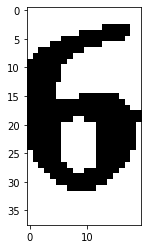

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/7634y_3.png


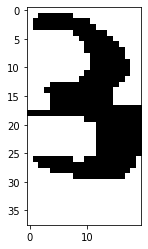

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7634y_4.png


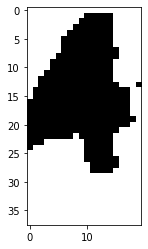

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7634y_y.png


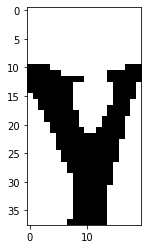

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f7cey.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f7cey_f.png


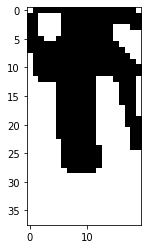

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/f7cey_7.png


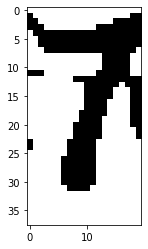

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/f7cey_c.png


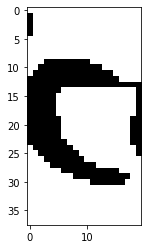

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/f7cey_e.png


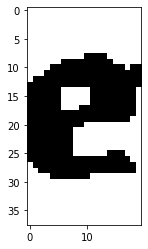

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/f7cey_y.png


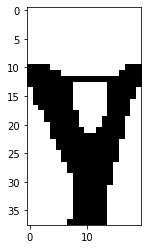

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g2577.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g2577_g.png


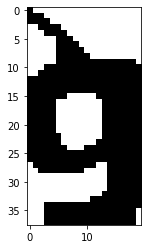

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/g2577_2.png


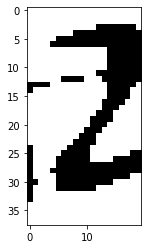

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/g2577_5.png


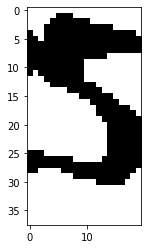

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/g2577_7.png


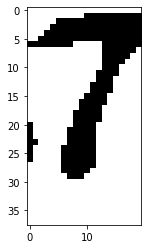

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/g2577_7.png


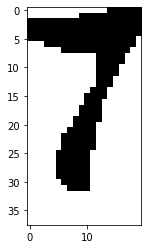

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6wnyc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6wnyc_6.png


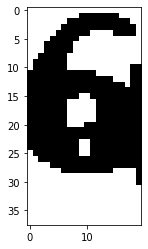

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6wnyc_w.png


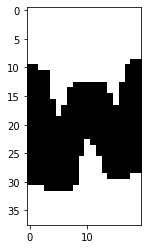

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6wnyc_n.png


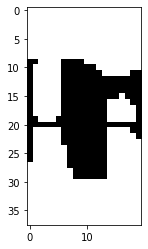

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6wnyc_y.png


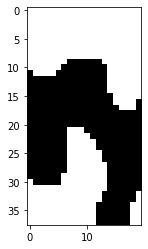

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6wnyc_c.png


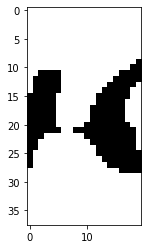

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8eggg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8eggg_8.png


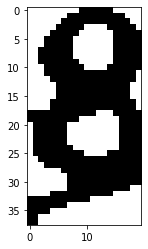

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8eggg_e.png


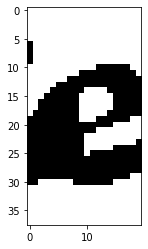

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8eggg_g.png


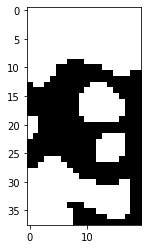

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8eggg_g.png


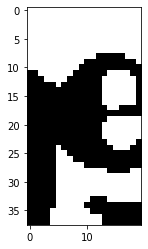

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8eggg_g.png


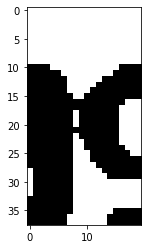

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/76nxn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/76nxn_7.png


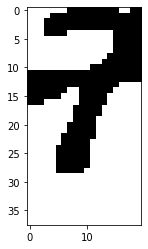

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/76nxn_6.png


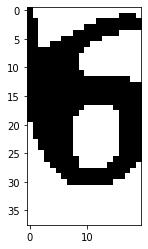

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/76nxn_n.png


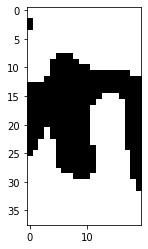

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/76nxn_x.png


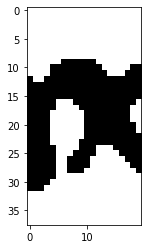

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/76nxn_n.png


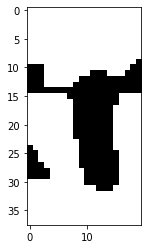

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n5p3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n5p3_8.png


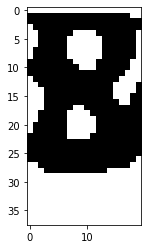

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n5p3_n.png


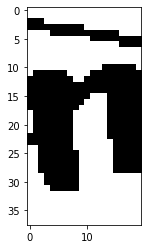

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8n5p3_5.png


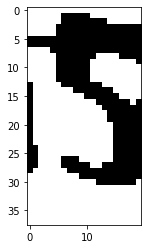

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8n5p3_p.png


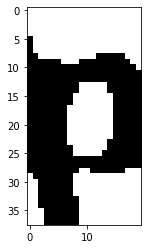

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8n5p3_3.png


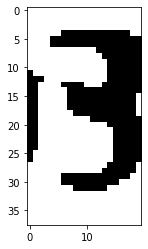

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7pcd7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7pcd7_7.png


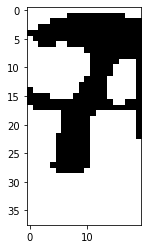

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7pcd7_p.png


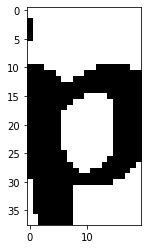

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7pcd7_c.png


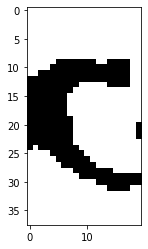

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7pcd7_d.png


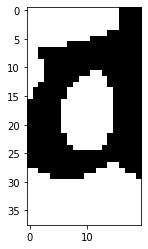

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7pcd7_7.png


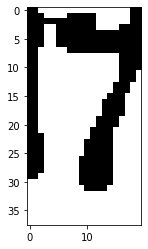

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6fg8c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6fg8c_6.png


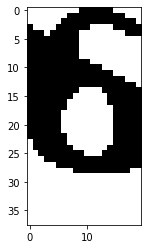

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6fg8c_f.png


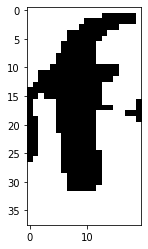

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6fg8c_g.png


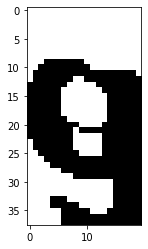

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/6fg8c_8.png


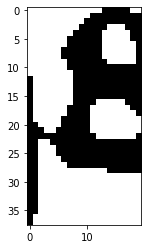

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6fg8c_c.png


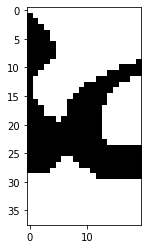

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n34n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n34n_8.png


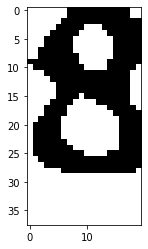

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n34n_n.png


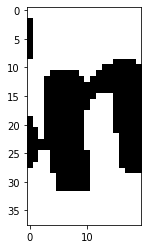

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8n34n_3.png


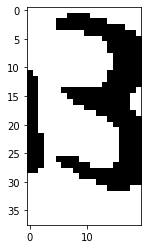

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8n34n_4.png


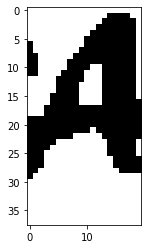

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n34n_n.png


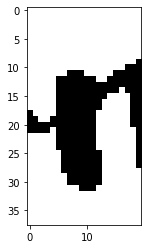

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e7nx4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e7nx4_e.png


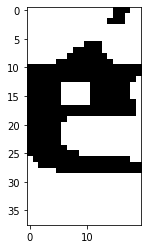

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e7nx4_7.png


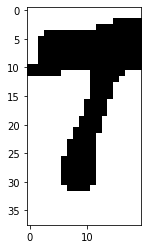

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e7nx4_n.png


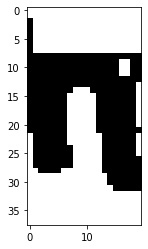

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/e7nx4_x.png


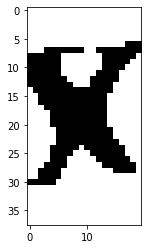

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e7nx4_4.png


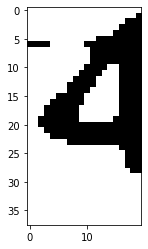

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8b735.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8b735_8.png


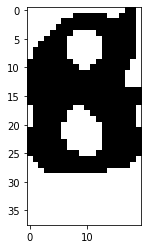

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8b735_b.png


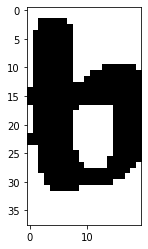

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8b735_7.png


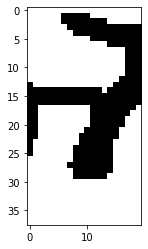

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8b735_3.png


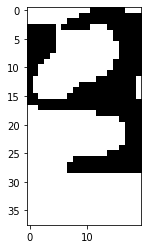

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8b735_5.png


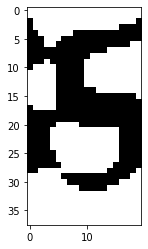

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ee8fg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ee8fg_e.png


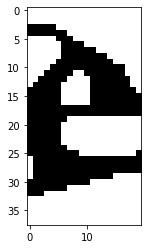

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ee8fg_e.png


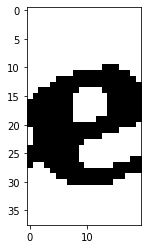

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/ee8fg_8.png


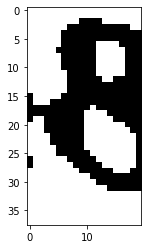

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ee8fg_f.png


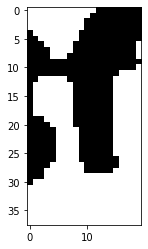

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ee8fg_g.png


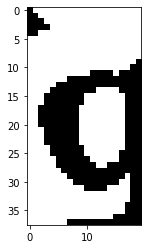

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/deneb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/deneb_d.png


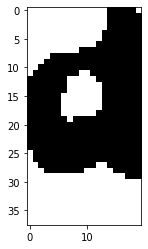

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/deneb_e.png


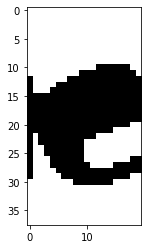

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/deneb_n.png


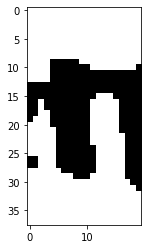

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/deneb_e.png


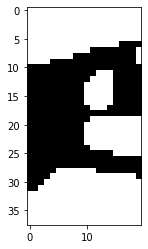

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/deneb_b.png


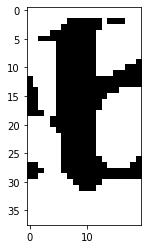

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f6ne5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f6ne5_f.png


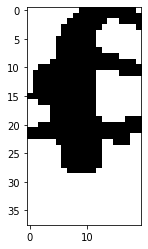

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/f6ne5_6.png


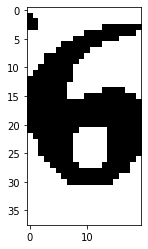

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f6ne5_n.png


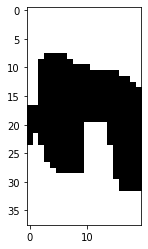

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/f6ne5_e.png


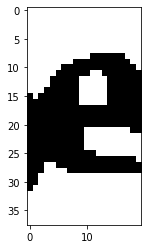

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f6ne5_5.png


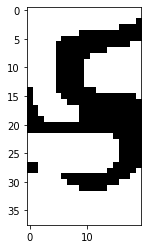

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ccn2x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ccn2x_c.png


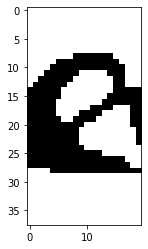

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ccn2x_c.png


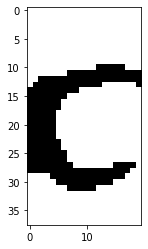

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ccn2x_n.png


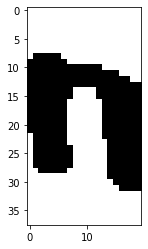

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/ccn2x_2.png


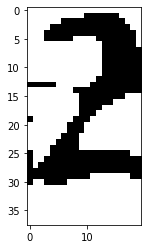

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ccn2x_x.png


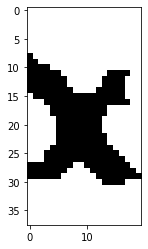

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b685n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b685n_b.png


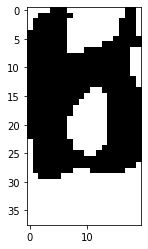

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/b685n_6.png


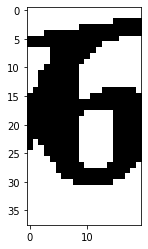

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/b685n_8.png


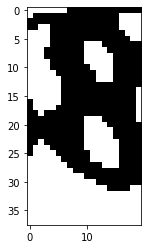

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b685n_5.png


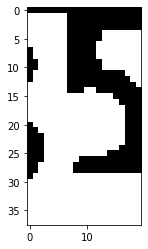

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b685n_n.png


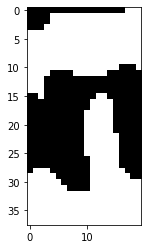

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f5cm2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f5cm2_f.png


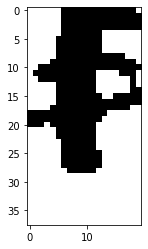

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f5cm2_5.png


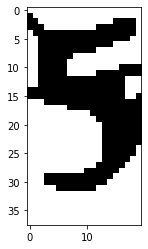

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/f5cm2_c.png


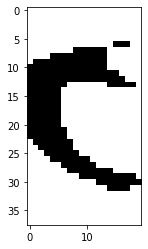

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/f5cm2_m.png


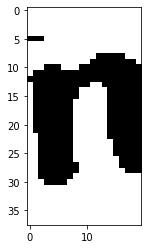

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f5cm2_2.png


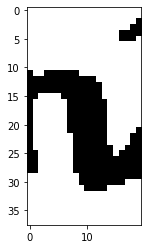

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cx3wg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cx3wg_c.png


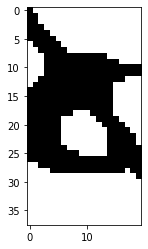

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/cx3wg_x.png


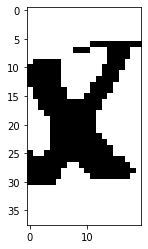

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/cx3wg_3.png


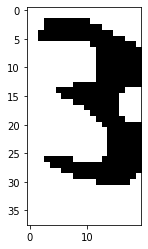

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cx3wg_w.png


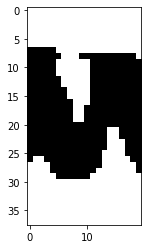

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cx3wg_g.png


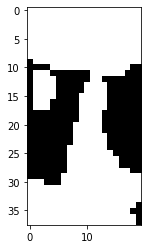

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6e554.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6e554_6.png


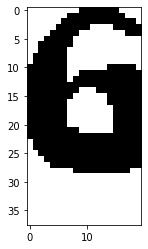

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6e554_e.png


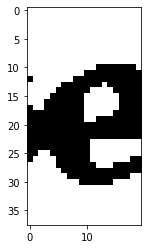

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6e554_5.png


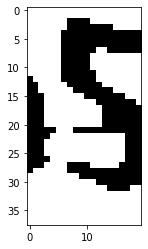

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6e554_5.png


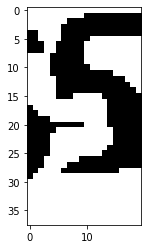

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6e554_4.png


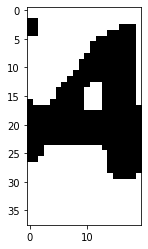

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/46mbm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/46mbm_4.png


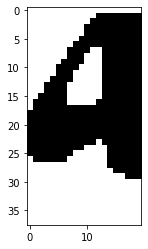

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/46mbm_6.png


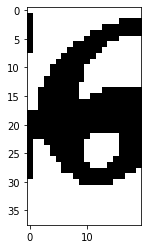

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/46mbm_m.png


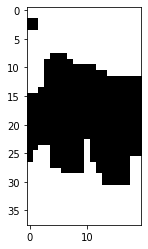

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/46mbm_b.png


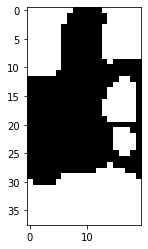

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/46mbm_m.png


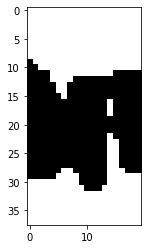

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fpw76.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fpw76_f.png


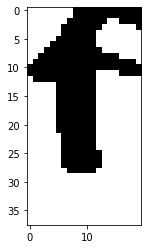

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fpw76_p.png


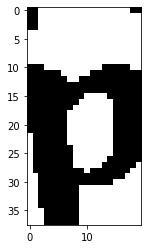

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fpw76_w.png


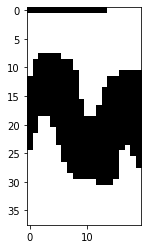

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/fpw76_7.png


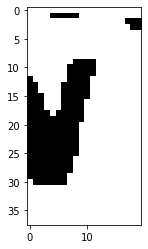

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/fpw76_6.png


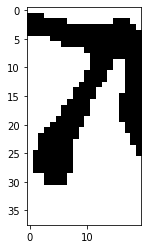

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/58pnp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/58pnp_5.png


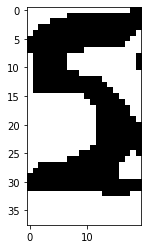

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/58pnp_8.png


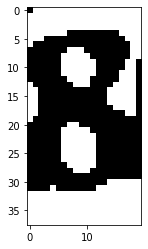

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/58pnp_p.png


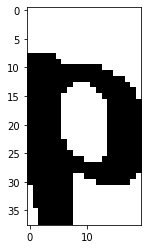

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/58pnp_n.png


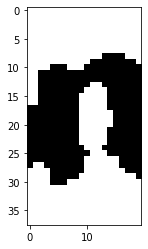

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/58pnp_p.png


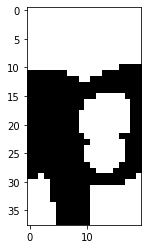

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/63824.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/63824_6.png


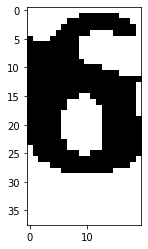

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/63824_3.png


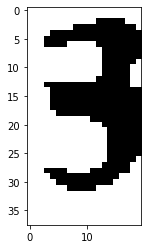

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/63824_8.png


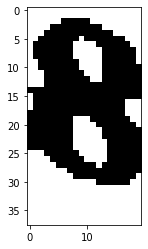

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/63824_2.png


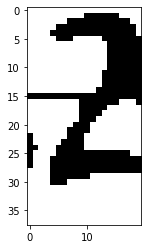

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/63824_4.png


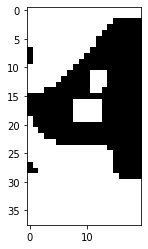

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/82fx2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/82fx2_8.png


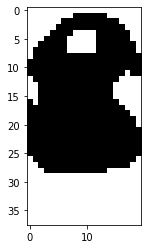

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/82fx2_2.png


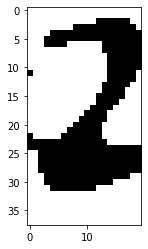

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/82fx2_f.png


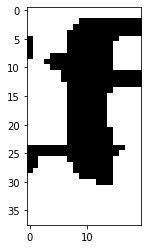

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/82fx2_x.png


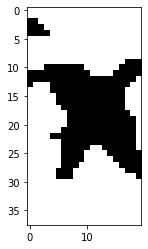

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/82fx2_2.png


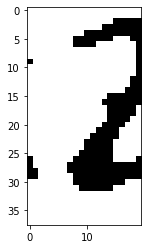

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/58b5m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/58b5m_5.png


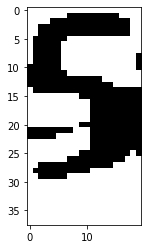

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/58b5m_8.png


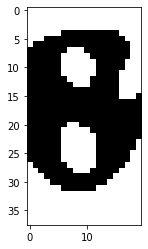

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/58b5m_b.png


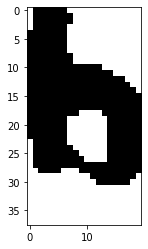

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/58b5m_5.png


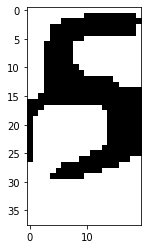

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/58b5m_m.png


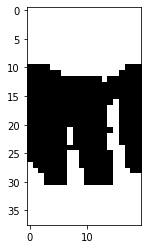

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/efx34.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efx34_e.png


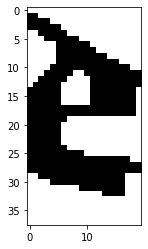

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efx34_f.png


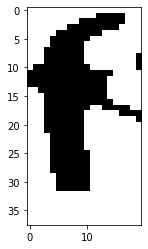

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/efx34_x.png


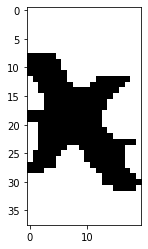

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/efx34_3.png


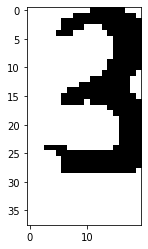

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/efx34_4.png


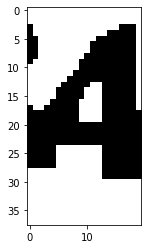

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dmw8n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dmw8n_d.png


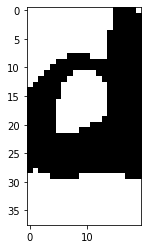

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dmw8n_m.png


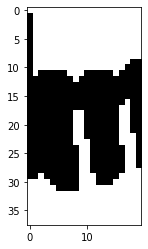

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dmw8n_w.png


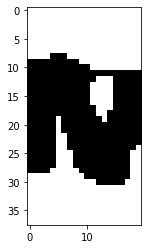

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dmw8n_8.png


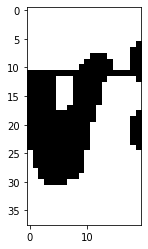

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dmw8n_n.png


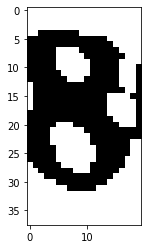

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/84w7x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/84w7x_8.png


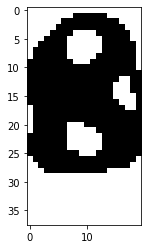

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/84w7x_4.png


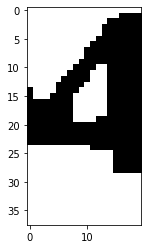

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/84w7x_w.png


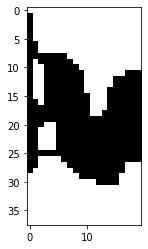

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/84w7x_7.png


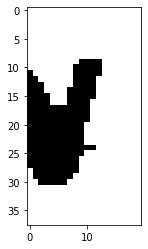

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/84w7x_x.png


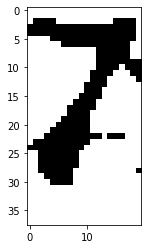

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c4bgd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c4bgd_c.png


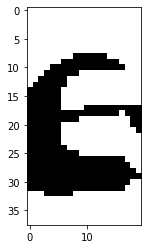

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c4bgd_4.png


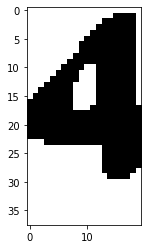

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c4bgd_b.png


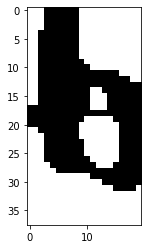

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/c4bgd_g.png


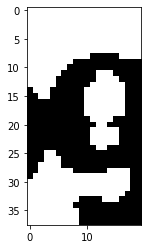

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/c4bgd_d.png


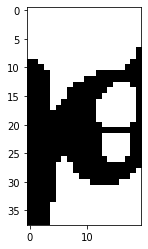

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e5n66.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e5n66_e.png


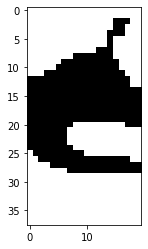

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/e5n66_5.png


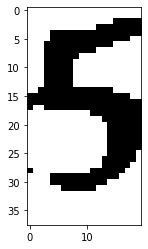

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e5n66_n.png


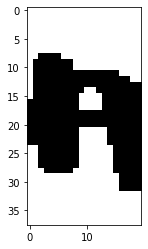

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e5n66_6.png


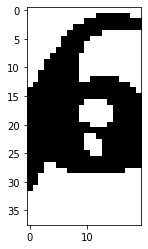

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e5n66_6.png


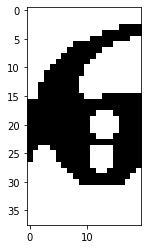

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bny23.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bny23_b.png


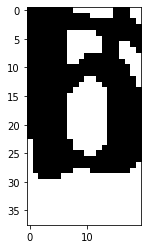

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bny23_n.png


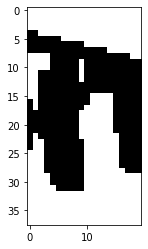

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/bny23_y.png


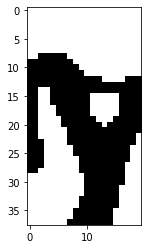

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/bny23_2.png


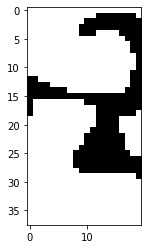

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/bny23_3.png


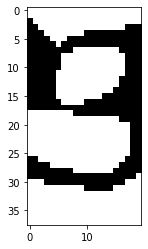

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d4ppy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d4ppy_d.png


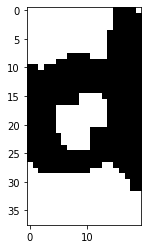

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/d4ppy_4.png


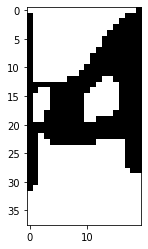

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/d4ppy_p.png


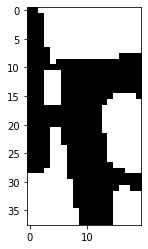

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/d4ppy_p.png


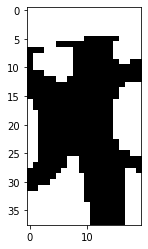

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d4ppy_y.png


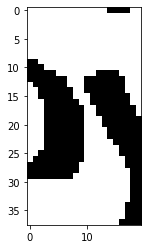

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6cm6m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6cm6m_6.png


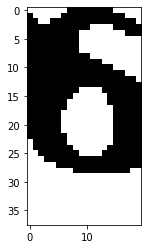

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6cm6m_c.png


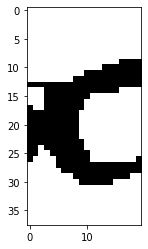

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6cm6m_m.png


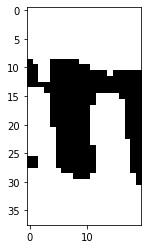

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6cm6m_6.png


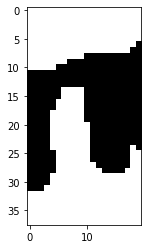

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6cm6m_m.png


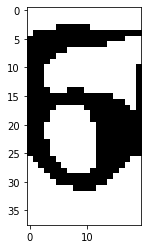

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cwgyx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cwgyx_c.png


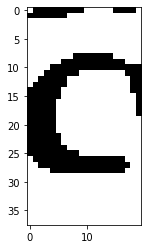

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cwgyx_w.png


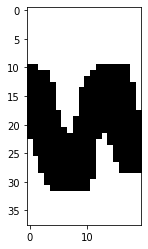

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cwgyx_g.png


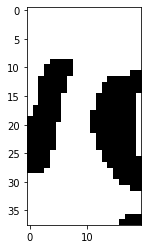

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cwgyx_y.png


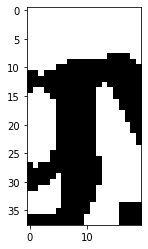

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/cwgyx_x.png


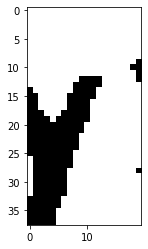

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6e6pn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6e6pn_6.png


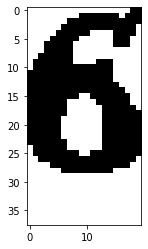

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6e6pn_e.png


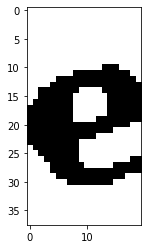

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6e6pn_6.png


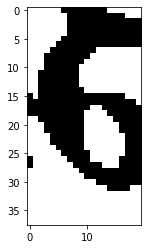

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6e6pn_p.png


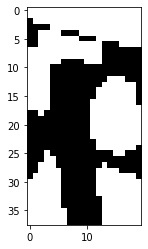

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6e6pn_n.png


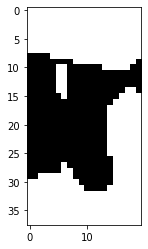

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d3c8y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d3c8y_d.png


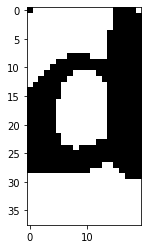

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d3c8y_3.png


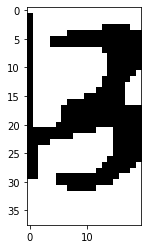

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d3c8y_c.png


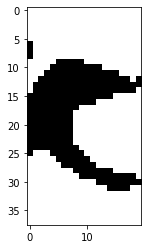

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d3c8y_8.png


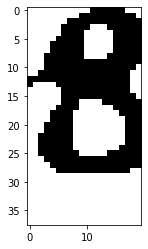

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d3c8y_y.png


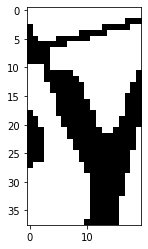

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5dxnm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5dxnm_5.png


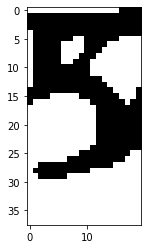

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5dxnm_d.png


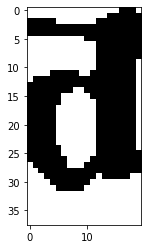

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5dxnm_x.png


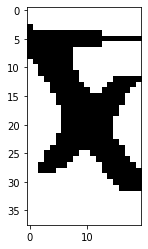

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5dxnm_n.png


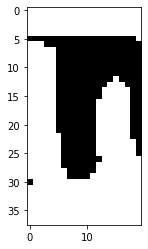

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5dxnm_m.png


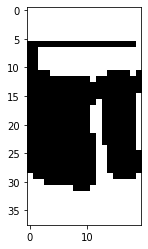

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/emwpn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/emwpn_e.png


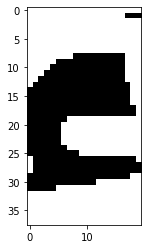

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/emwpn_m.png


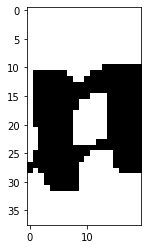

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/emwpn_w.png


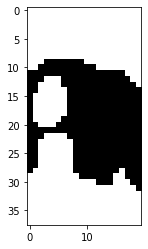

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/emwpn_p.png


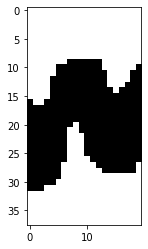

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/emwpn_n.png


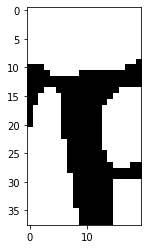

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8c23f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8c23f_8.png


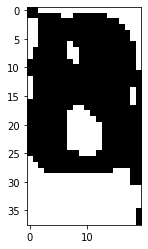

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8c23f_c.png


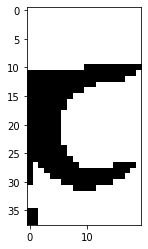

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8c23f_2.png


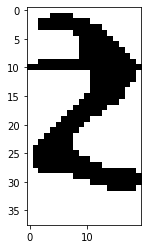

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8c23f_3.png


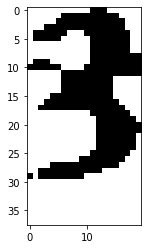

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8c23f_f.png


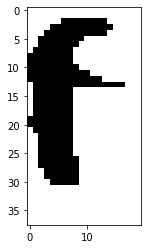

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/573bn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/573bn_5.png


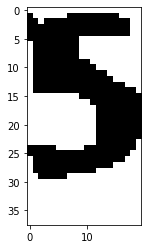

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/573bn_7.png


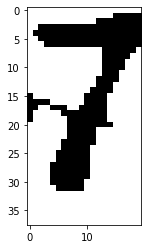

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/573bn_3.png


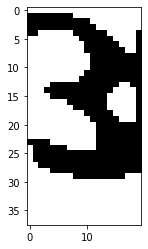

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/573bn_b.png


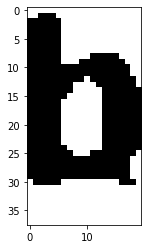

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/573bn_n.png


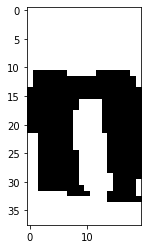

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5p8fm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5p8fm_5.png


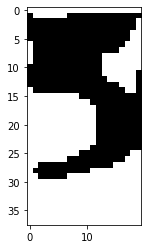

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5p8fm_p.png


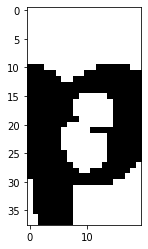

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/5p8fm_8.png


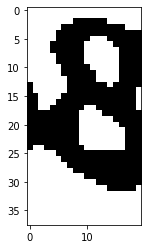

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5p8fm_f.png


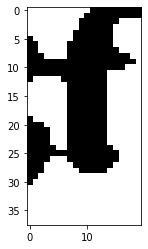

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5p8fm_m.png


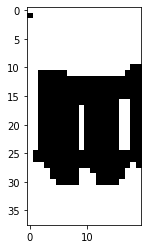

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n56m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n56m_8.png


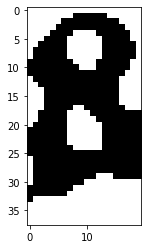

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n56m_n.png


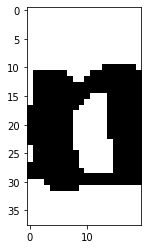

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8n56m_5.png


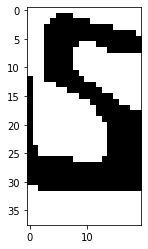

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8n56m_6.png


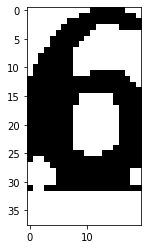

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8n56m_m.png


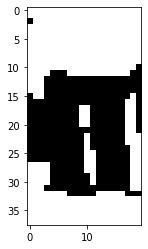

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/feyc8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/feyc8_f.png


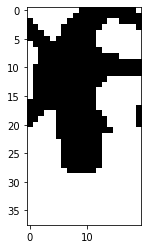

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/feyc8_e.png


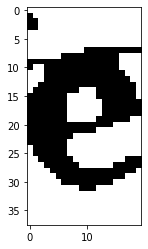

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/feyc8_y.png


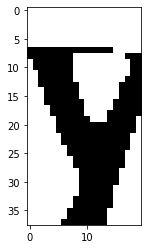

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/feyc8_c.png


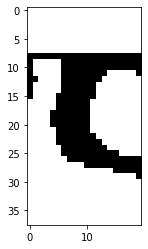

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/feyc8_8.png


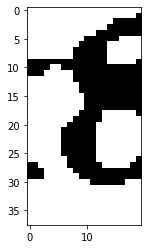

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7bb7b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7bb7b_7.png


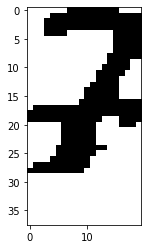

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7bb7b_b.png


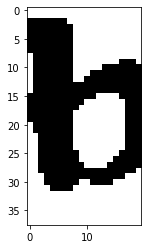

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7bb7b_b.png


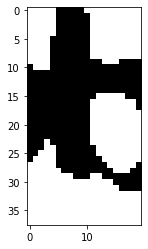

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7bb7b_7.png


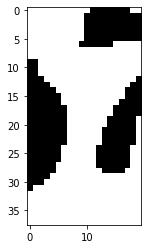

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7bb7b_b.png


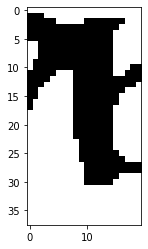

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d7en3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d7en3_d.png


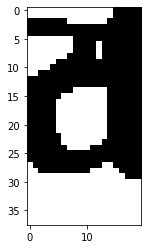

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d7en3_7.png


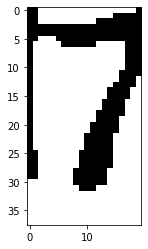

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/d7en3_e.png


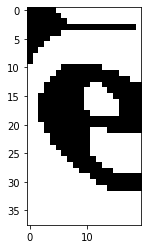

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d7en3_n.png


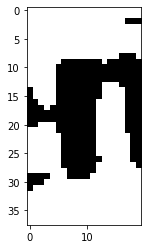

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d7en3_3.png


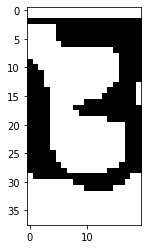

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8npd5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8npd5_8.png


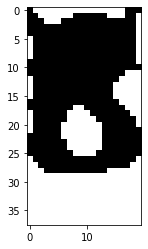

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8npd5_n.png


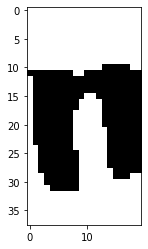

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8npd5_p.png


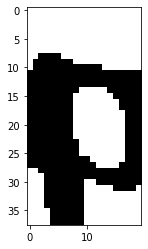

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8npd5_d.png


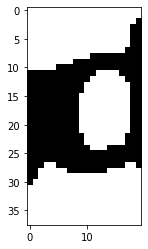

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8npd5_5.png


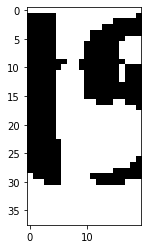

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d378n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d378n_d.png


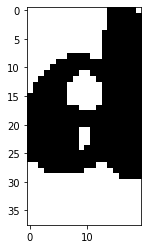

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d378n_3.png


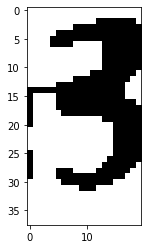

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d378n_7.png


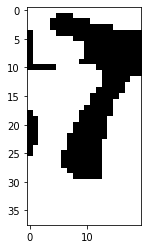

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d378n_8.png


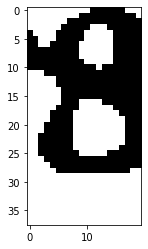

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d378n_n.png


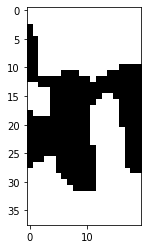

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4nnf3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4nnf3_4.png


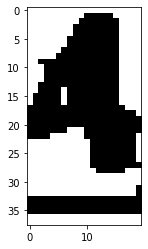

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4nnf3_n.png


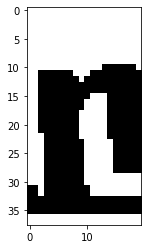

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4nnf3_n.png


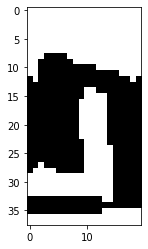

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4nnf3_f.png


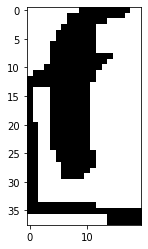

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4nnf3_3.png


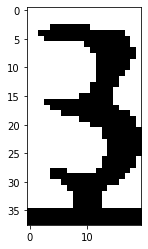

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dce8y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dce8y_d.png


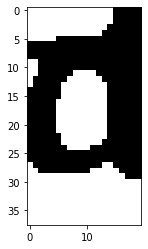

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dce8y_c.png


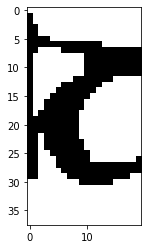

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/dce8y_e.png


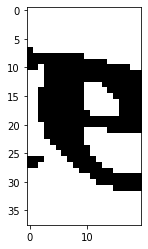

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dce8y_8.png


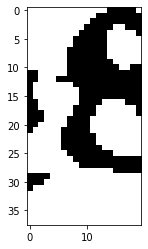

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dce8y_y.png


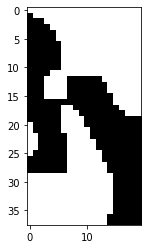

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cd4eg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cd4eg_c.png


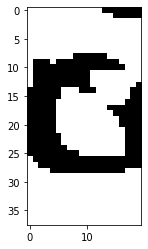

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cd4eg_d.png


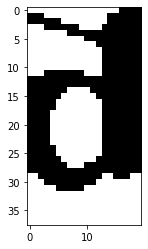

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/cd4eg_4.png


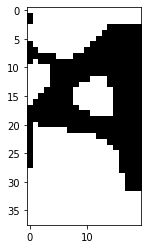

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cd4eg_e.png


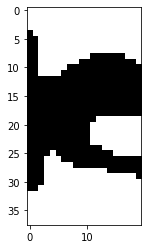

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cd4eg_g.png


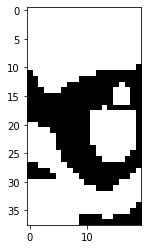

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8e32m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8e32m_8.png


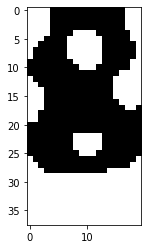

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8e32m_e.png


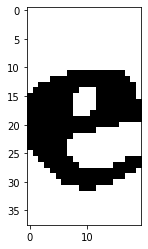

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8e32m_3.png


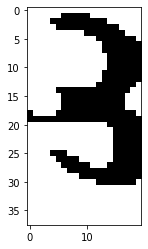

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8e32m_2.png


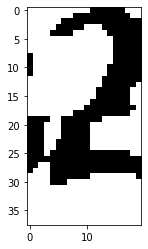

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8e32m_m.png


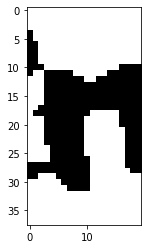

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c3n8x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c3n8x_c.png


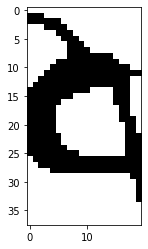

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c3n8x_3.png


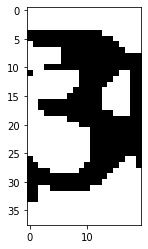

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c3n8x_n.png


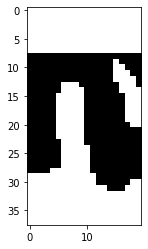

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c3n8x_8.png


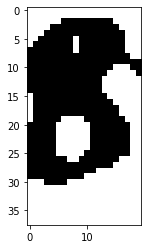

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/c3n8x_x.png


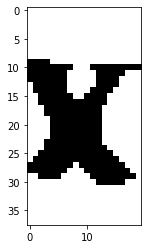

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e3ndn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e3ndn_e.png


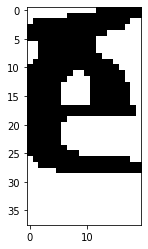

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/e3ndn_3.png


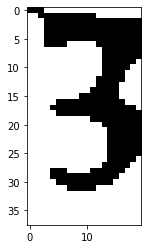

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e3ndn_n.png


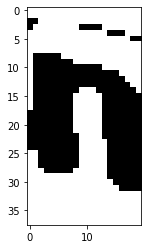

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e3ndn_d.png


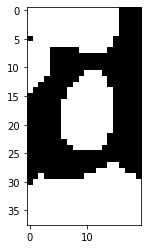

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e3ndn_n.png


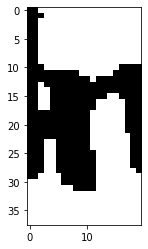

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/byfgn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/byfgn_b.png


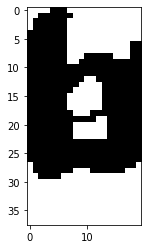

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/byfgn_y.png


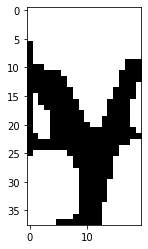

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/byfgn_f.png


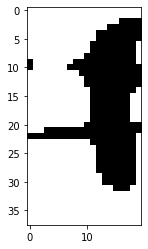

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/byfgn_g.png


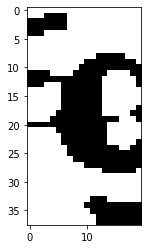

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/byfgn_n.png


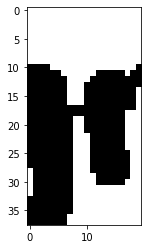

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cdmn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cdmn8_c.png


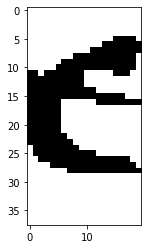

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cdmn8_d.png


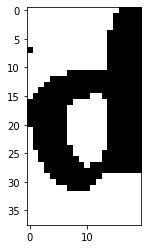

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cdmn8_m.png


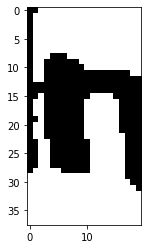

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cdmn8_n.png


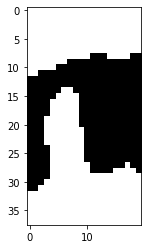

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/cdmn8_8.png


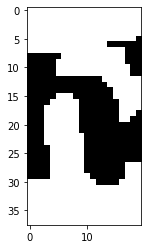

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n65n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n65n_8.png


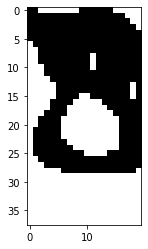

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n65n_n.png


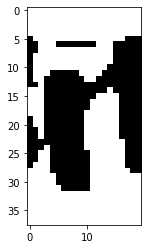

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8n65n_6.png


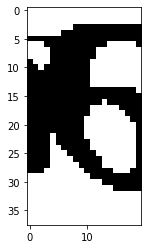

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8n65n_5.png


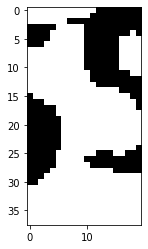

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n65n_n.png


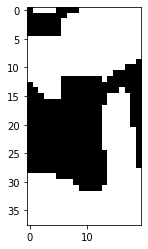

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cc845.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cc845_c.png


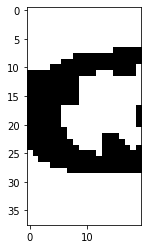

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cc845_c.png


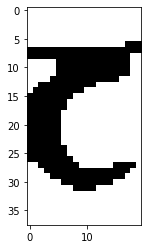

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/cc845_8.png


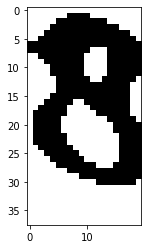

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/cc845_4.png


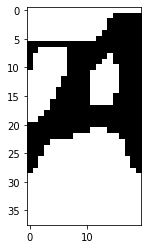

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cc845_5.png


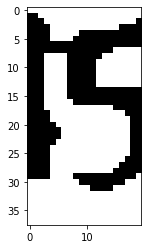

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5yxgp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5yxgp_5.png


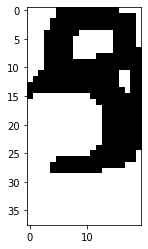

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/5yxgp_y.png


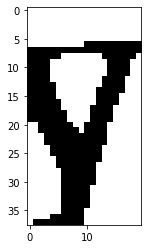

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5yxgp_x.png


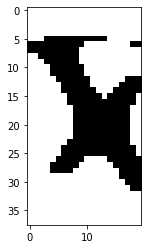

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5yxgp_g.png


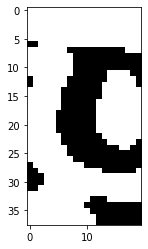

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5yxgp_p.png


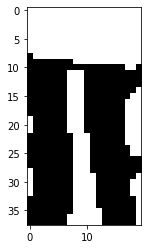

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c2g4d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c2g4d_c.png


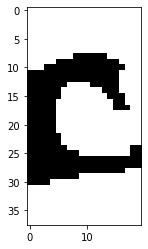

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c2g4d_2.png


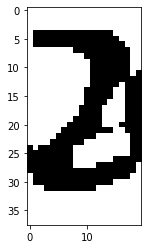

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/c2g4d_g.png


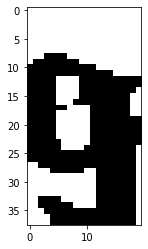

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c2g4d_4.png


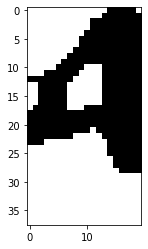

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/c2g4d_d.png


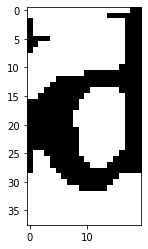

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d22n7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d22n7_d.png


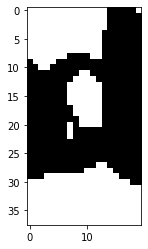

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22n7_2.png


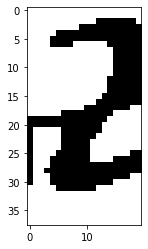

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22n7_2.png


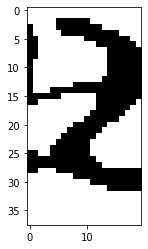

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d22n7_n.png


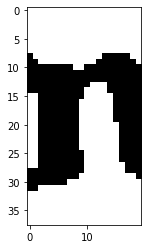

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d22n7_7.png


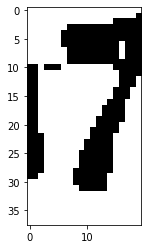

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/488de.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/488de_4.png


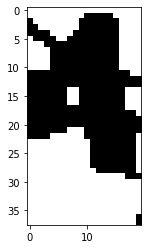

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/488de_8.png


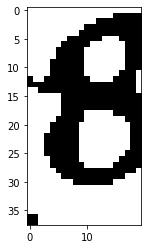

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/488de_8.png


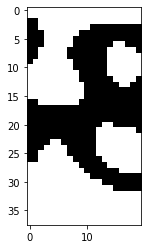

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/488de_d.png


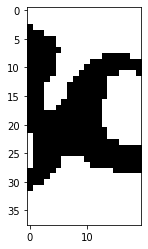

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/488de_e.png


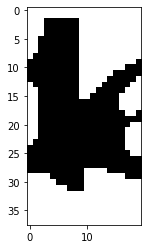

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dfnx4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dfnx4_d.png


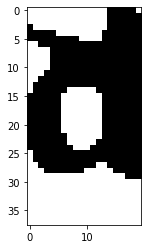

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/dfnx4_f.png


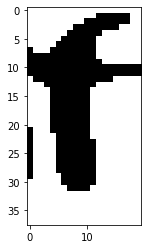

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dfnx4_n.png


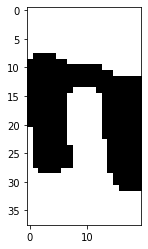

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dfnx4_x.png


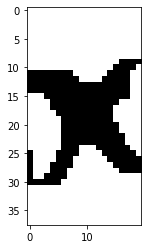

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/dfnx4_4.png


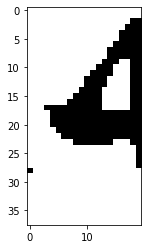

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d7c5x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d7c5x_d.png


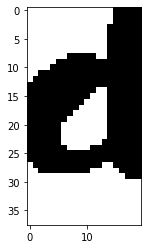

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d7c5x_7.png


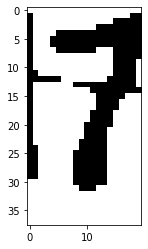

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d7c5x_c.png


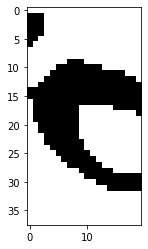

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/d7c5x_5.png


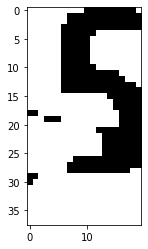

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/d7c5x_x.png


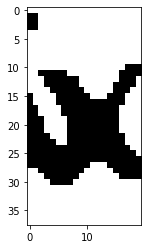

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6f2yc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6f2yc_6.png


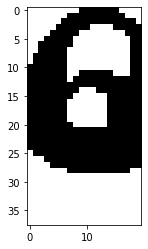

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6f2yc_f.png


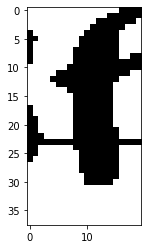

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/6f2yc_2.png


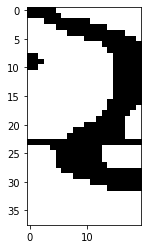

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6f2yc_y.png


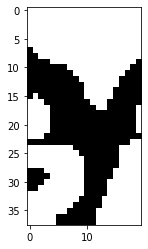

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6f2yc_c.png


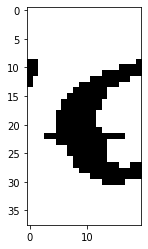

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bm3p8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bm3p8_b.png


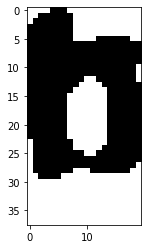

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bm3p8_m.png


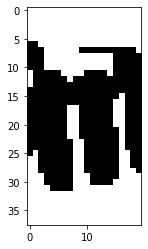

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/bm3p8_3.png


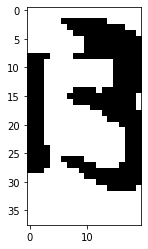

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/bm3p8_p.png


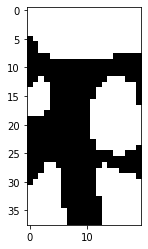

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/bm3p8_8.png


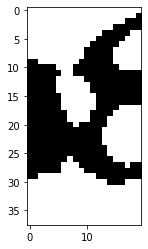

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bw44w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bw44w_b.png


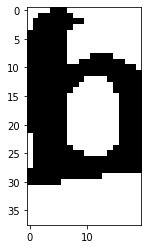

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bw44w_w.png


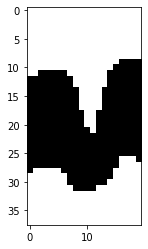

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bw44w_4.png


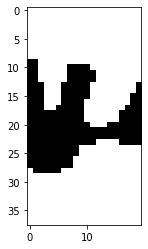

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bw44w_4.png


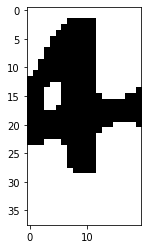

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bw44w_w.png


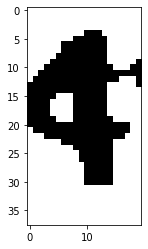

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6cwxe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6cwxe_6.png


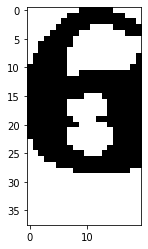

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6cwxe_c.png


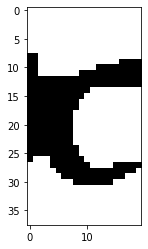

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6cwxe_w.png


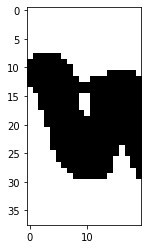

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6cwxe_x.png


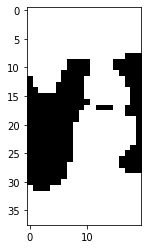

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6cwxe_e.png


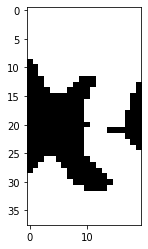

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6fn84.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6fn84_6.png


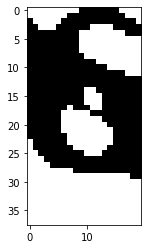

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6fn84_f.png


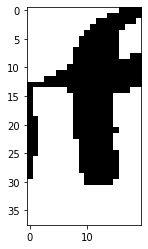

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6fn84_n.png


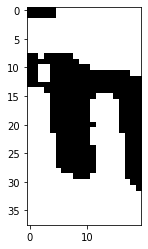

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/6fn84_8.png


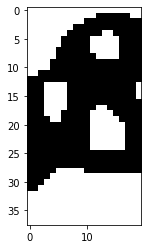

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6fn84_4.png


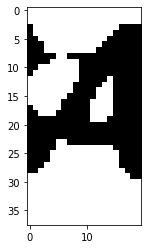

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6dd2y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6dd2y_6.png


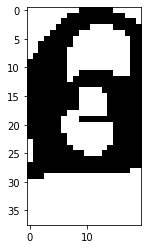

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6dd2y_d.png


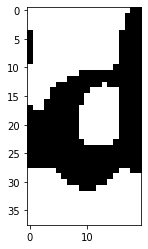

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6dd2y_d.png


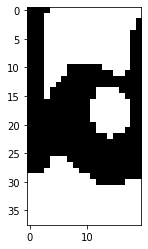

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/6dd2y_2.png


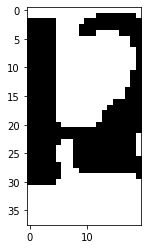

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6dd2y_y.png


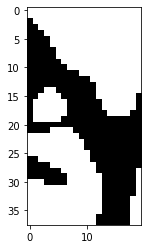

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/68x48.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/68x48_6.png


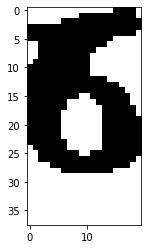

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/68x48_8.png


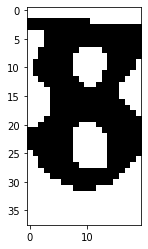

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/68x48_x.png


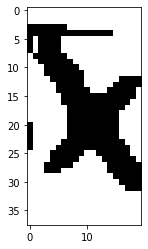

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/68x48_4.png


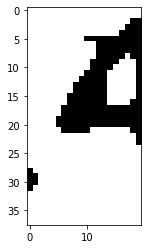

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/68x48_8.png


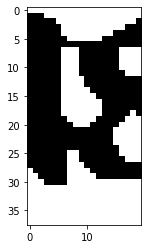

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f8f8g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f8f8g_f.png


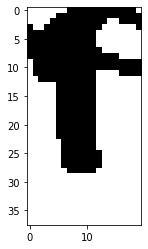

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f8f8g_8.png


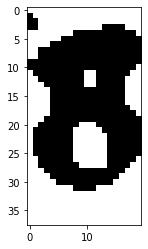

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f8f8g_f.png


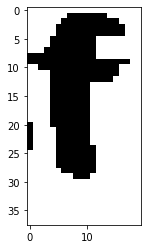

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f8f8g_8.png


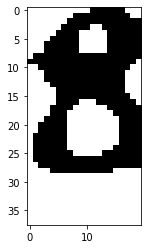

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/f8f8g_g.png


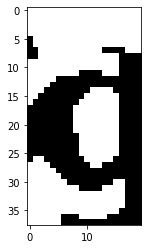

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cnwyc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cnwyc_c.png


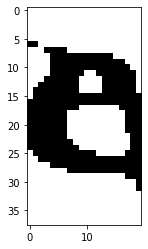

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cnwyc_n.png


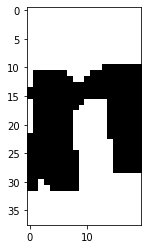

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cnwyc_w.png


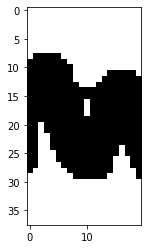

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cnwyc_y.png


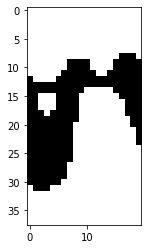

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cnwyc_c.png


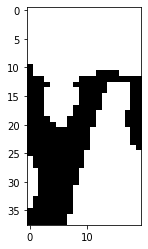

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c55c6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c55c6_c.png


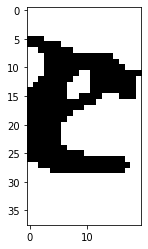

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c55c6_5.png


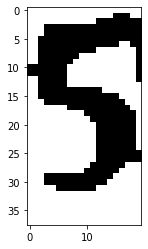

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c55c6_5.png


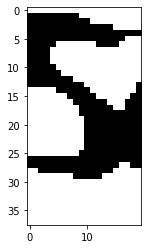

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c55c6_c.png


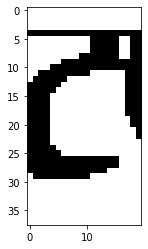

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c55c6_6.png


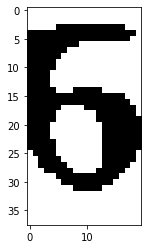

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8684m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8684m_8.png


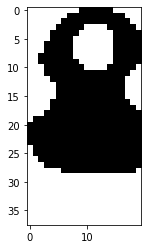

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8684m_6.png


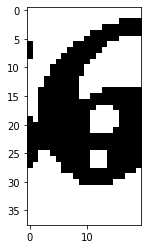

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8684m_8.png


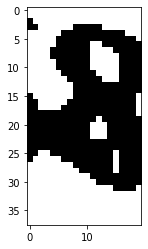

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8684m_4.png


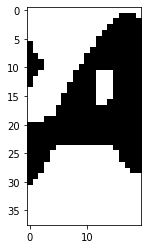

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8684m_m.png


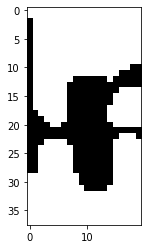

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7gnge.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7gnge_7.png


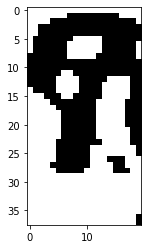

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7gnge_g.png


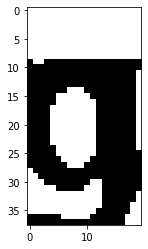

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7gnge_n.png


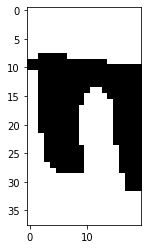

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7gnge_g.png


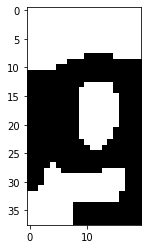

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/7gnge_e.png


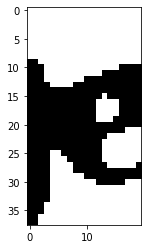

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g3ex3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g3ex3_g.png


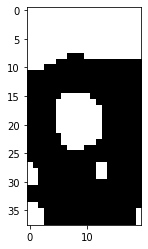

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/g3ex3_3.png


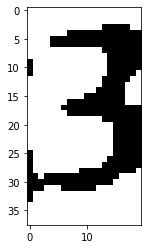

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/g3ex3_e.png


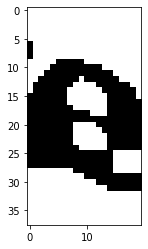

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/g3ex3_x.png


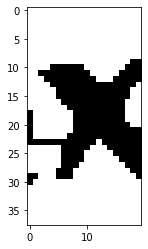

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/g3ex3_3.png


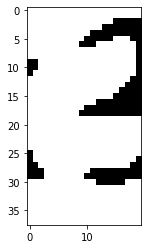

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/478nx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/478nx_4.png


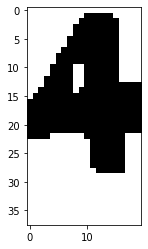

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/478nx_7.png


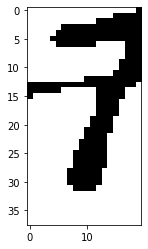

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/478nx_8.png


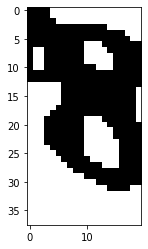

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/478nx_n.png


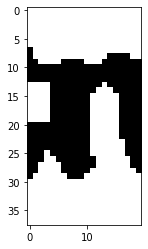

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/478nx_x.png


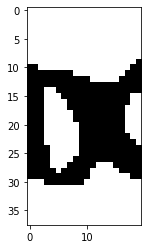

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fc6xb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fc6xb_f.png


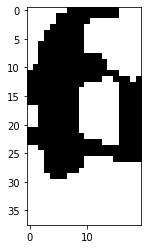

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fc6xb_c.png


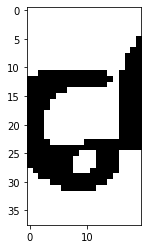

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/fc6xb_6.png


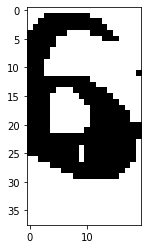

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/fc6xb_x.png


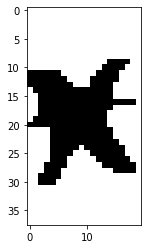

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fc6xb_b.png


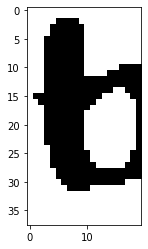

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cpe63.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cpe63_c.png


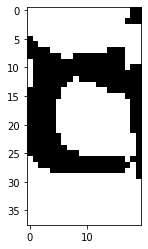

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/cpe63_p.png


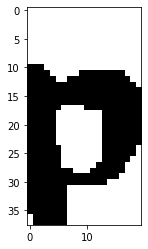

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cpe63_e.png


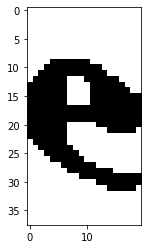

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cpe63_6.png


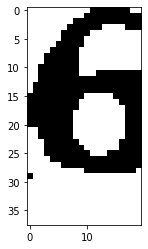

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/cpe63_3.png


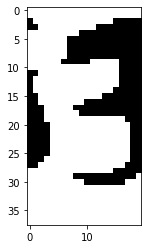

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/edg3p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/edg3p_e.png


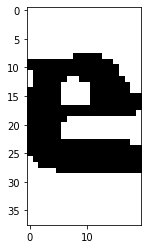

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/edg3p_d.png


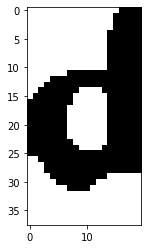

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/edg3p_g.png


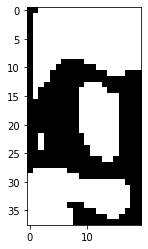

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/edg3p_3.png


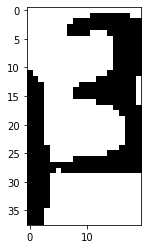

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/edg3p_p.png


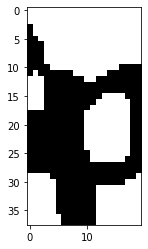

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dnxdp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dnxdp_d.png


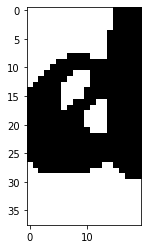

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dnxdp_n.png


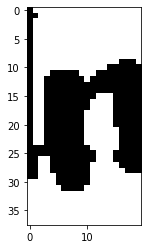

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dnxdp_x.png


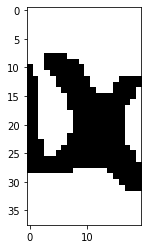

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dnxdp_d.png


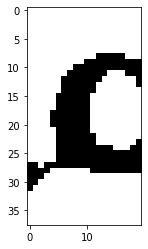

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dnxdp_p.png


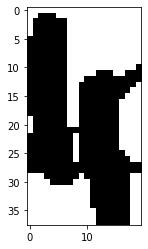

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/823p2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/823p2_8.png


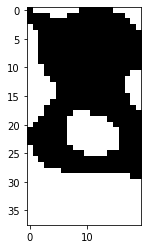

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/823p2_2.png


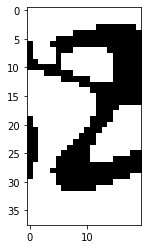

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/823p2_3.png


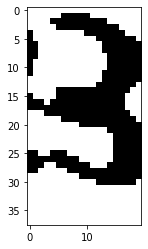

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/823p2_p.png


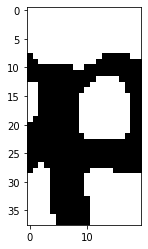

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/823p2_2.png


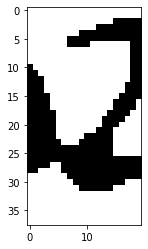

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5n732.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5n732_5.png


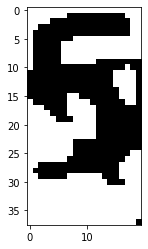

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5n732_n.png


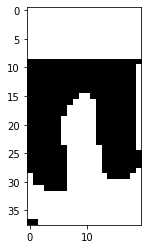

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5n732_7.png


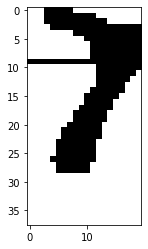

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5n732_3.png


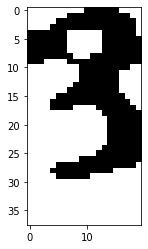

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5n732_2.png


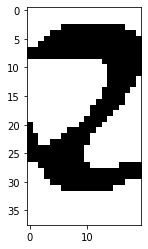

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6wg4n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6wg4n_6.png


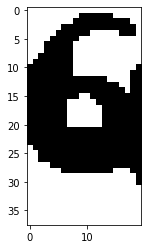

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6wg4n_w.png


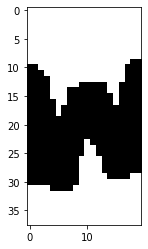

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6wg4n_g.png


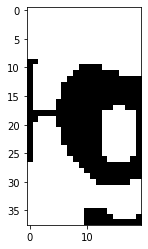

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6wg4n_4.png


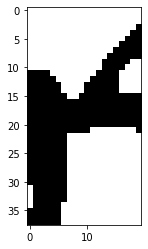

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6wg4n_n.png


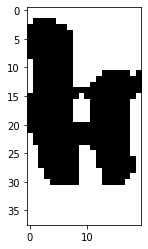

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4ycex.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4ycex_4.png


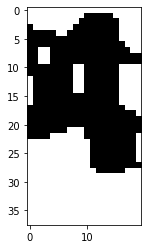

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4ycex_y.png


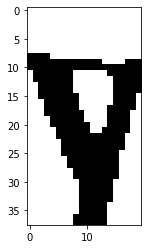

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4ycex_c.png


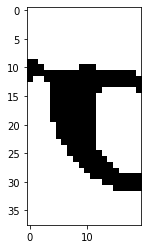

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/4ycex_e.png


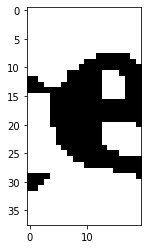

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/4ycex_x.png


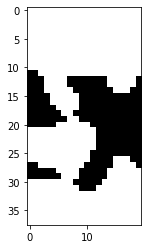

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7dgc2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7dgc2_7.png


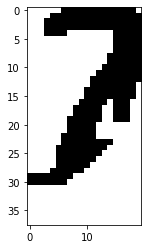

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7dgc2_d.png


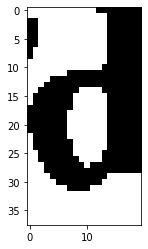

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7dgc2_g.png


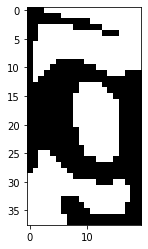

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7dgc2_c.png


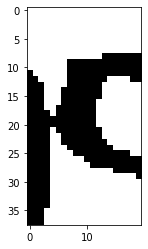

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7dgc2_2.png


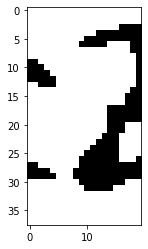

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7wn74.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7wn74_7.png


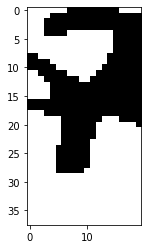

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7wn74_w.png


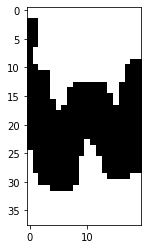

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7wn74_n.png


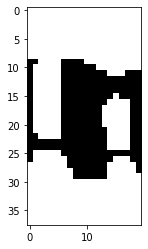

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7wn74_7.png


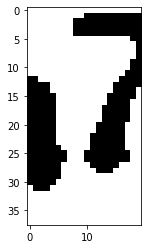

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7wn74_4.png


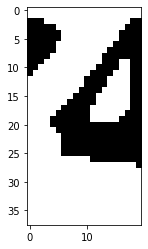

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/edwny.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/edwny_e.png


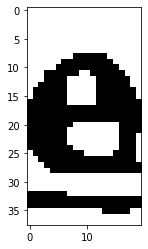

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/edwny_d.png


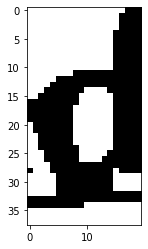

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/edwny_w.png


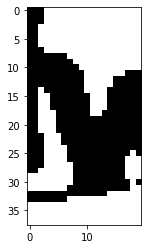

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/edwny_n.png


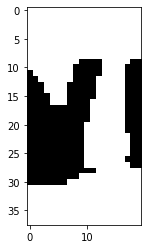

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/edwny_y.png


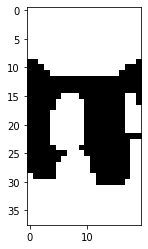

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dnne7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dnne7_d.png


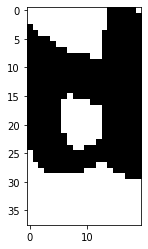

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dnne7_n.png


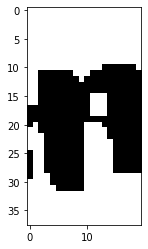

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dnne7_n.png


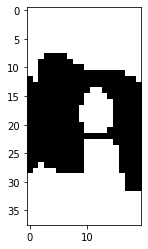

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/dnne7_e.png


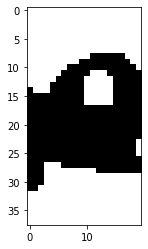

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/dnne7_7.png


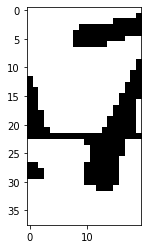

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bwmee.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bwmee_b.png


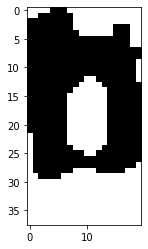

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bwmee_w.png


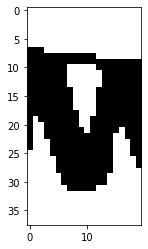

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bwmee_m.png


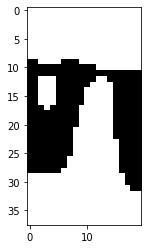

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/bwmee_e.png


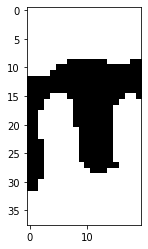

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/bwmee_e.png


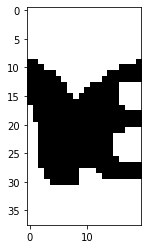

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/de7f8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/de7f8_d.png


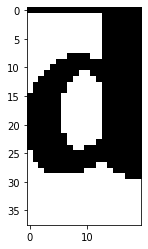

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/de7f8_e.png


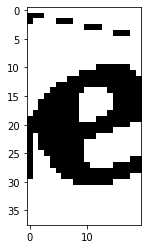

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/de7f8_7.png


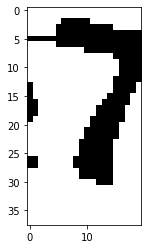

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/de7f8_f.png


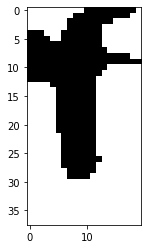

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/de7f8_8.png


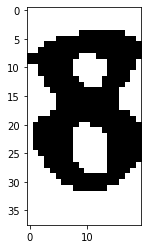

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bpwd7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bpwd7_b.png


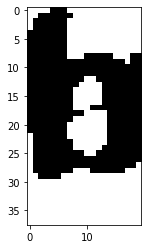

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/bpwd7_p.png


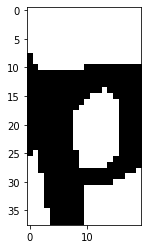

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bpwd7_w.png


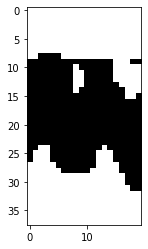

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bpwd7_d.png


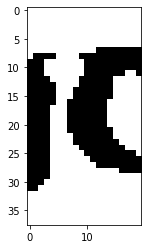

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/bpwd7_7.png


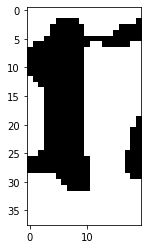

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/74eyg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/74eyg_7.png


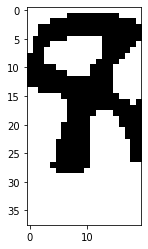

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/74eyg_4.png


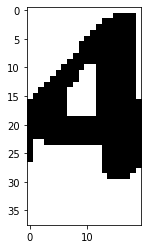

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/74eyg_e.png


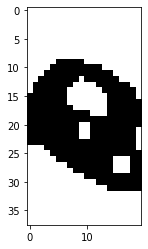

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/74eyg_y.png


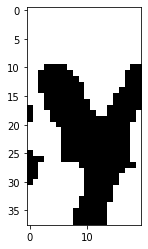

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/74eyg_g.png


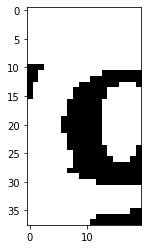

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7dxbd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7dxbd_7.png


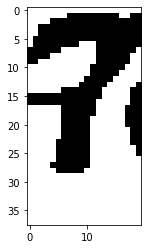

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7dxbd_d.png


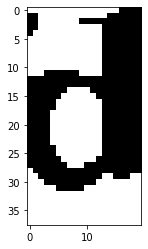

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7dxbd_x.png


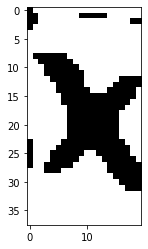

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7dxbd_b.png


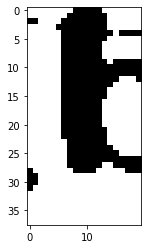

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7dxbd_d.png


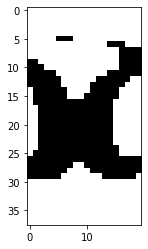

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f6bpw.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f6bpw_f.jpg


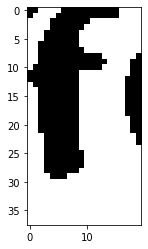

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/f6bpw_6.jpg


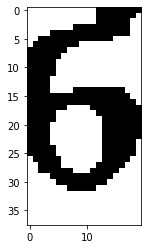

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/f6bpw_b.jpg


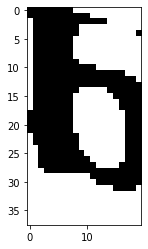

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/f6bpw_p.jpg


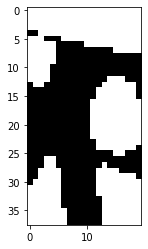

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/f6bpw_w.jpg


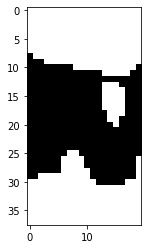

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d22y5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d22y5_d.png


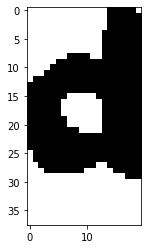

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22y5_2.png


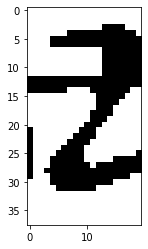

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22y5_2.png


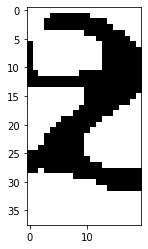

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d22y5_y.png


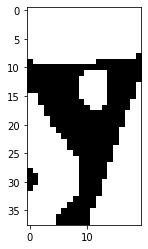

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/d22y5_5.png


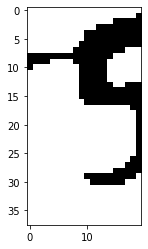

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6g45w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6g45w_6.png


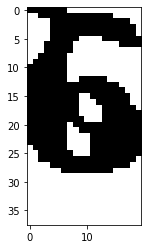

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6g45w_g.png


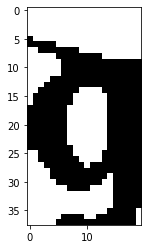

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6g45w_4.png


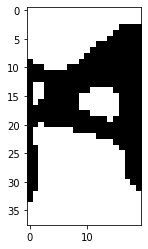

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6g45w_5.png


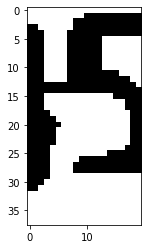

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6g45w_w.png


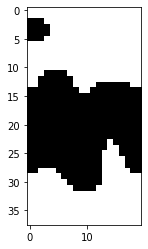

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/658xe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/658xe_6.png


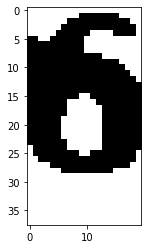

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/658xe_5.png


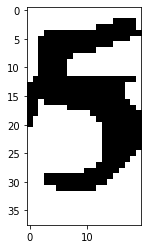

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/658xe_8.png


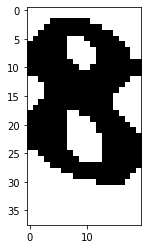

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/658xe_x.png


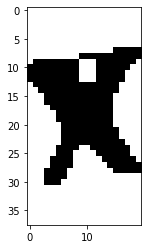

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/658xe_e.png


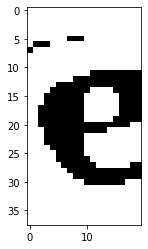

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cfc56.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfc56_c.png


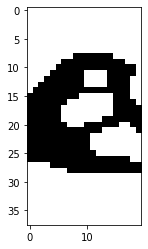

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cfc56_f.png


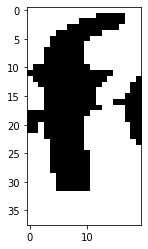

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfc56_c.png


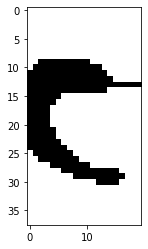

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cfc56_5.png


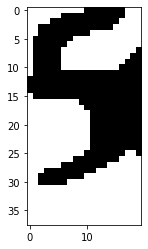

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cfc56_6.png


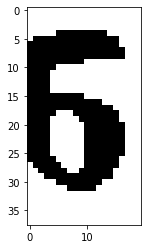

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/en4n4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/en4n4_e.png


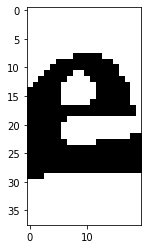

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/en4n4_n.png


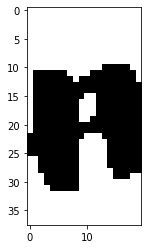

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/en4n4_4.png


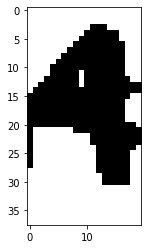

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/en4n4_n.png


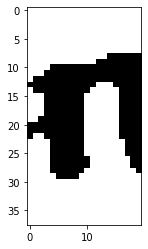

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/en4n4_4.png


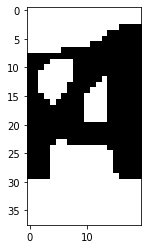

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5mfff.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5mfff_5.png


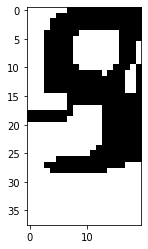

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5mfff_m.png


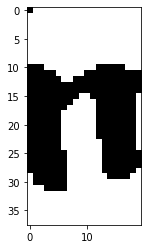

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5mfff_f.png


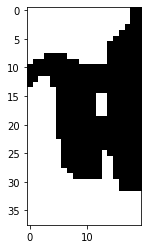

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5mfff_f.png


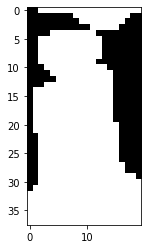

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5mfff_f.png


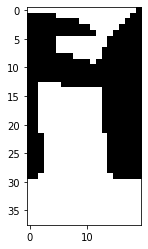

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/85622.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/85622_8.png


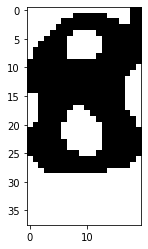

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/85622_5.png


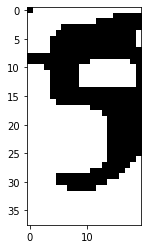

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/85622_6.png


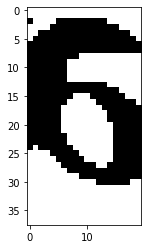

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/85622_2.png


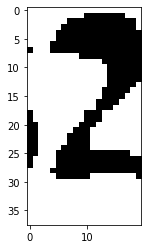

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/85622_2.png


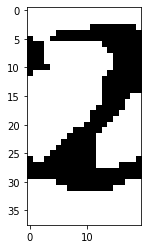

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bn5mw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bn5mw_b.png


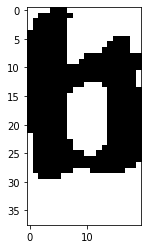

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bn5mw_n.png


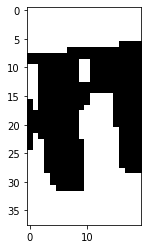

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bn5mw_5.png


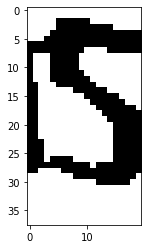

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bn5mw_m.png


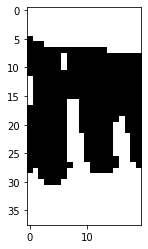

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bn5mw_w.png


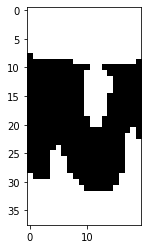

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/677g3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/677g3_6.png


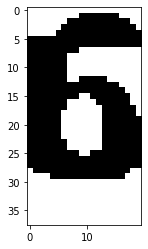

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/677g3_7.png


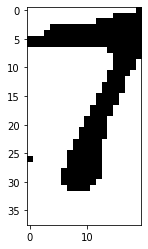

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/677g3_7.png


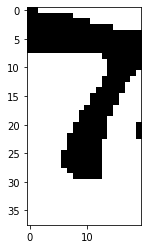

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/677g3_g.png


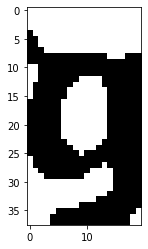

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/677g3_3.png


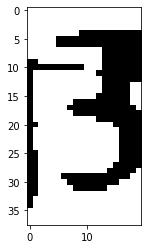

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/defyx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/defyx_d.png


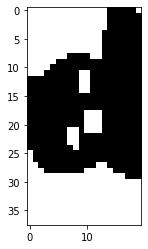

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/defyx_e.png


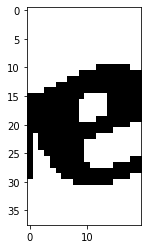

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/defyx_f.png


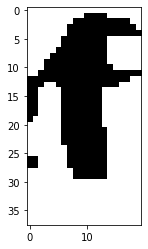

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/defyx_y.png


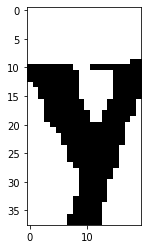

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/defyx_x.png


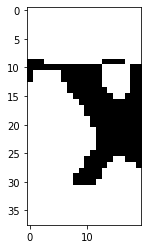

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bgem5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bgem5_b.png


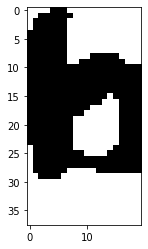

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/bgem5_g.png


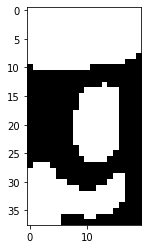

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/bgem5_e.png


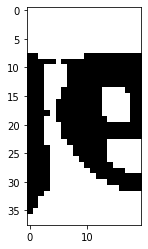

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bgem5_m.png


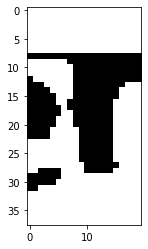

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bgem5_5.png


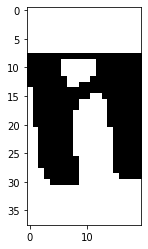

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b28g8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b28g8_b.png


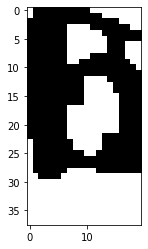

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/b28g8_2.png


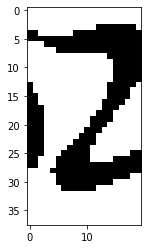

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/b28g8_8.png


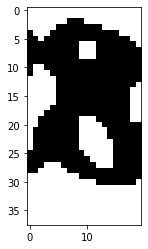

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/b28g8_g.png


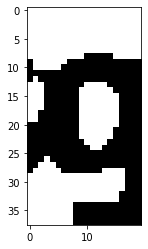

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/b28g8_8.png


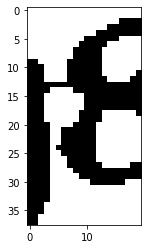

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bx5ed.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bx5ed_b.jpg


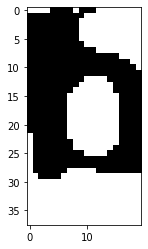

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/bx5ed_x.jpg


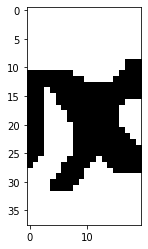

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bx5ed_5.jpg


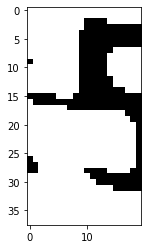

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/bx5ed_e.jpg


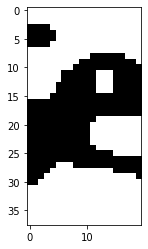

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bx5ed_d.jpg


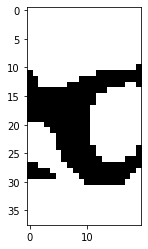

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/832f3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/832f3_8.png


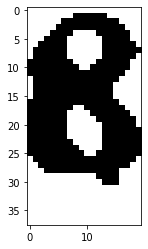

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/832f3_3.png


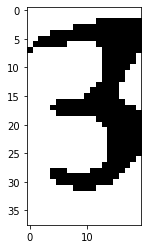

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/832f3_2.png


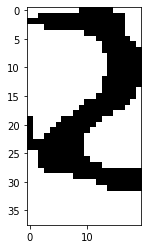

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/832f3_f.png


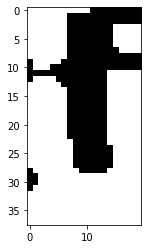

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/832f3_3.png


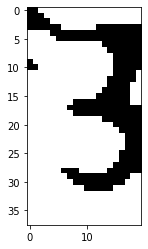

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fw3b2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fw3b2_f.png


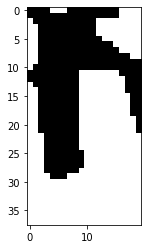

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fw3b2_w.png


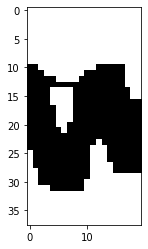

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fw3b2_3.png


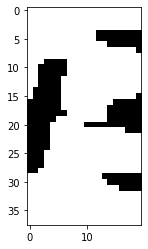

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fw3b2_b.png


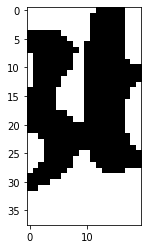

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fw3b2_2.png


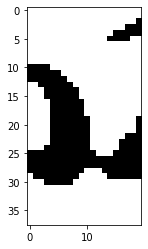

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7wyp4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7wyp4_7.png


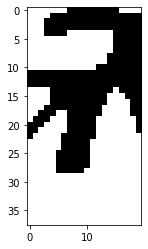

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7wyp4_w.png


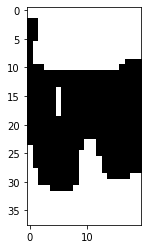

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7wyp4_y.png


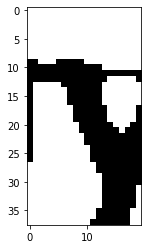

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7wyp4_p.png


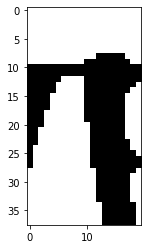

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7wyp4_4.png


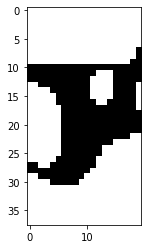

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4w76g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4w76g_4.png


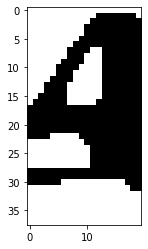

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4w76g_w.png


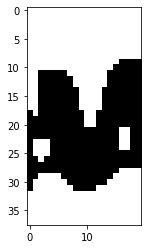

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/4w76g_7.png


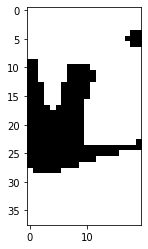

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/4w76g_6.png


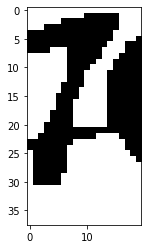

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4w76g_g.png


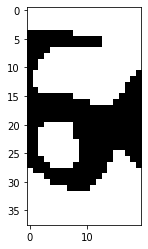

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bny4w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bny4w_b.png


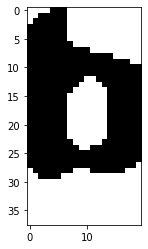

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bny4w_n.png


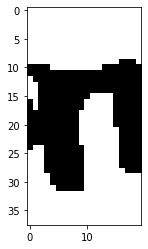

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/bny4w_y.png


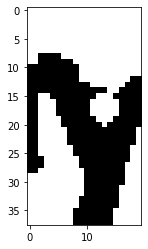

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bny4w_4.png


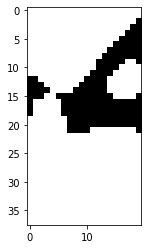

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bny4w_w.png


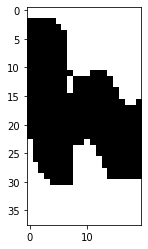

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/57b27.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/57b27_5.png


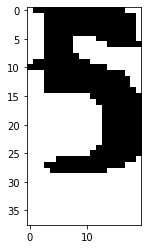

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/57b27_7.png


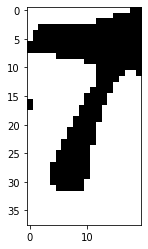

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/57b27_b.png


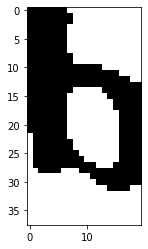

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/57b27_2.png


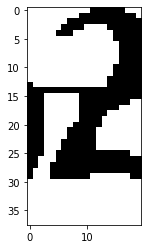

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/57b27_7.png


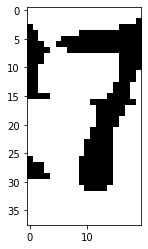

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5bgp2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5bgp2_5.png


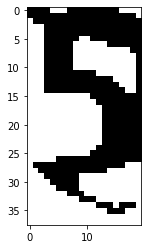

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5bgp2_b.png


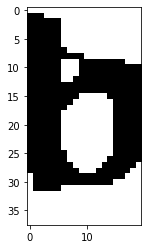

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5bgp2_g.png


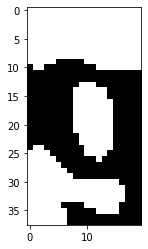

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5bgp2_p.png


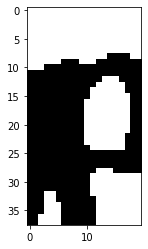

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5bgp2_2.png


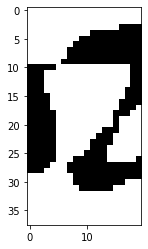

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fp762.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fp762_f.png


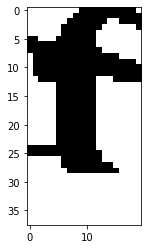

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fp762_p.png


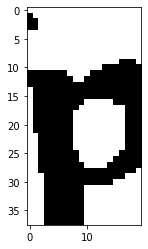

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/fp762_7.png


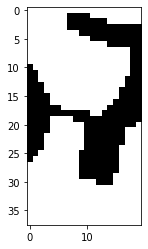

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/fp762_6.png


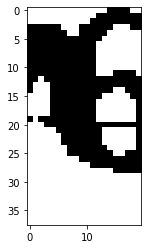

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fp762_2.png


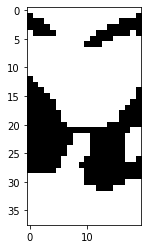

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6n6gg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6n6gg_6.png


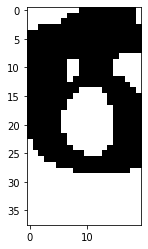

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6n6gg_n.png


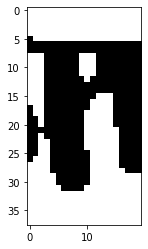

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6n6gg_6.png


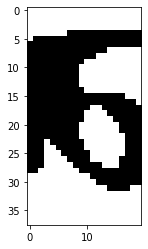

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6n6gg_g.png


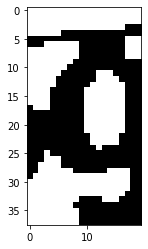

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6n6gg_g.png


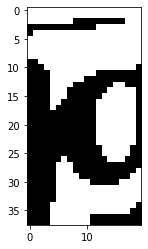

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/664nf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/664nf_6.png


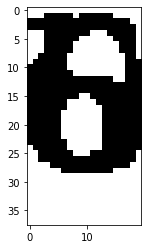

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/664nf_6.png


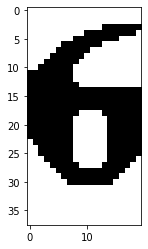

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/664nf_4.png


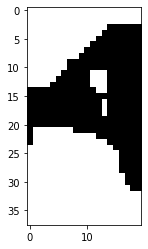

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/664nf_n.png


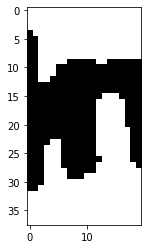

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/664nf_f.png


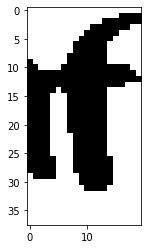

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8xef7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8xef7_8.png


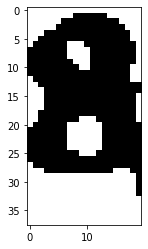

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/8xef7_x.png


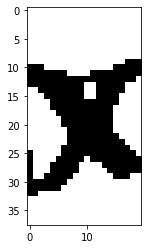

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8xef7_e.png


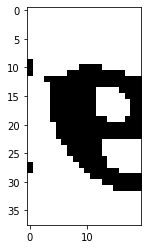

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8xef7_f.png


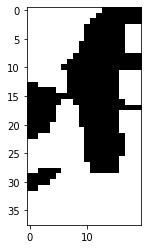

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8xef7_7.png


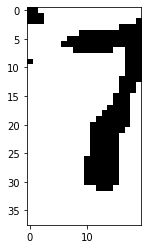

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8y63f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8y63f_8.png


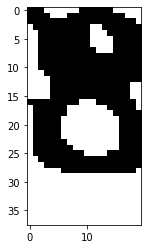

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8y63f_y.png


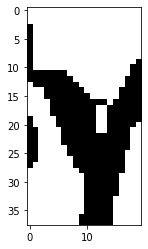

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8y63f_6.png


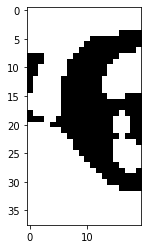

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8y63f_3.png


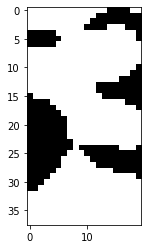

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8y63f_f.png


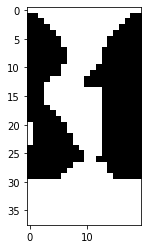

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fg38b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fg38b_f.png


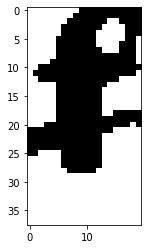

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fg38b_g.png


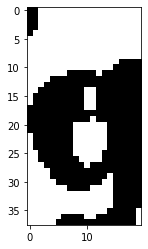

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fg38b_3.png


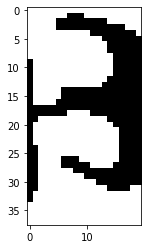

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/fg38b_8.png


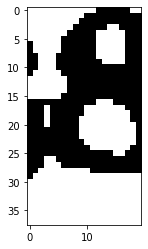

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fg38b_b.png


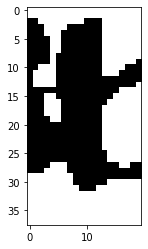

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5f3gf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5f3gf_5.png


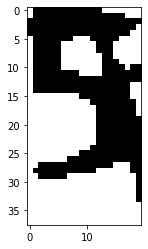

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5f3gf_f.png


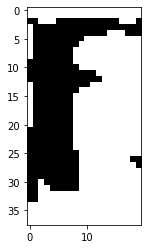

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5f3gf_3.png


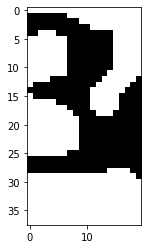

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5f3gf_g.png


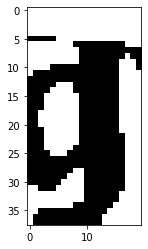

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5f3gf_f.png


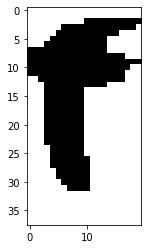

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e72cd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e72cd_e.png


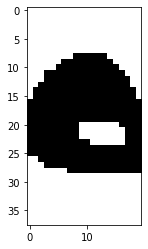

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e72cd_7.png


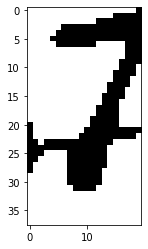

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e72cd_2.png


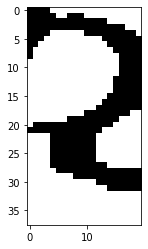

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/e72cd_c.png


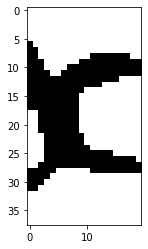

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e72cd_d.png


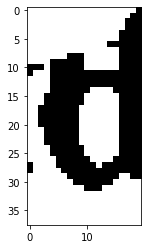

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dnmd8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dnmd8_d.png


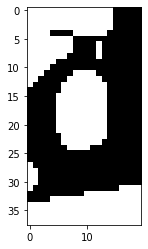

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dnmd8_n.png


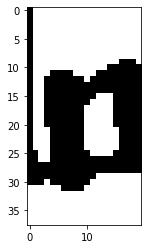

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dnmd8_m.png


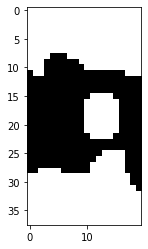

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dnmd8_d.png


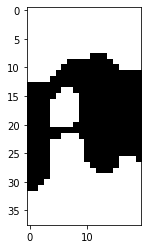

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dnmd8_8.png


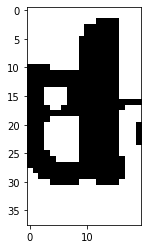

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5xd2e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5xd2e_5.png


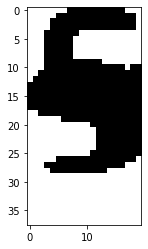

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5xd2e_x.png


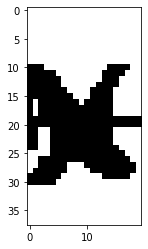

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5xd2e_d.png


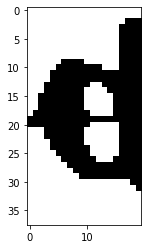

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5xd2e_2.png


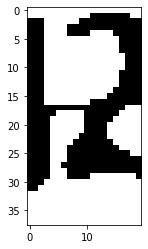

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5xd2e_e.png


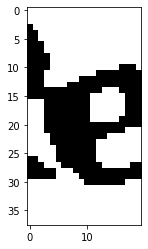

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/de45x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/de45x_d.png


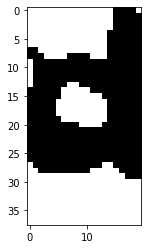

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/de45x_e.png


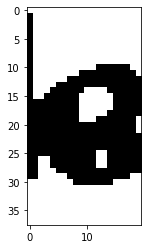

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/de45x_4.png


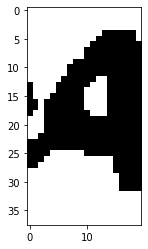

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/de45x_5.png


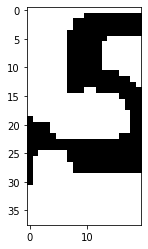

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/de45x_x.png


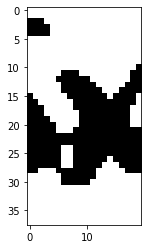

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/76353.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/76353_7.png


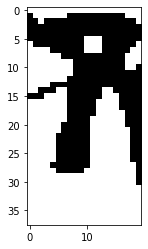

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/76353_6.png


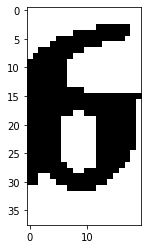

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/76353_3.png


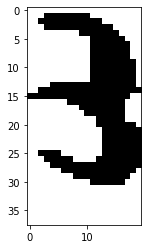

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/76353_5.png


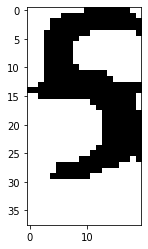

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/76353_3.png


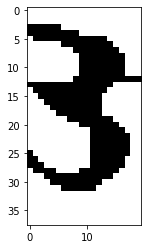

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d236n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d236n_d.png


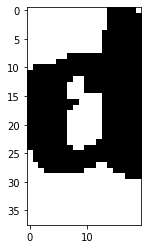

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d236n_2.png


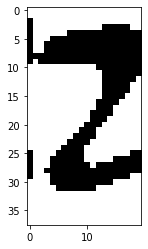

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d236n_3.png


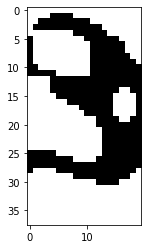

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d236n_6.png


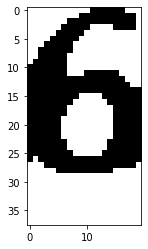

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d236n_n.png


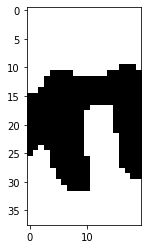

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5x7x5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5x7x5_5.png


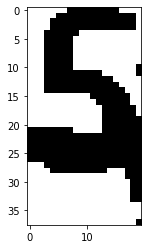

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5x7x5_x.png


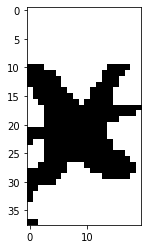

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5x7x5_7.png


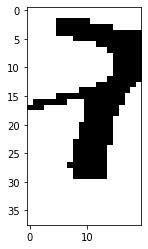

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5x7x5_x.png


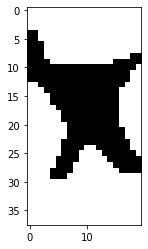

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5x7x5_5.png


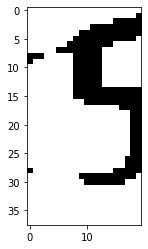

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5pm6b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5pm6b_5.png


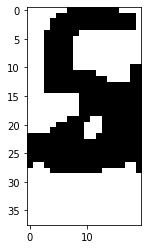

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5pm6b_p.png


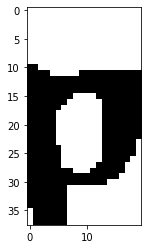

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5pm6b_m.png


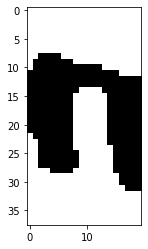

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/5pm6b_6.png


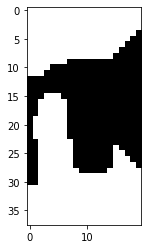

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5pm6b_b.png


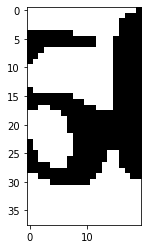

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f35xp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f35xp_f.png


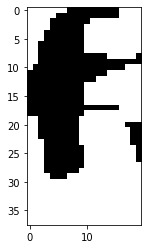

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f35xp_3.png


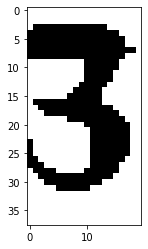

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f35xp_5.png


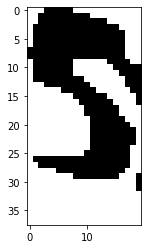

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/f35xp_x.png


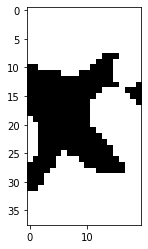

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/f35xp_p.png


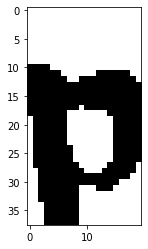

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e84n2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e84n2_e.png


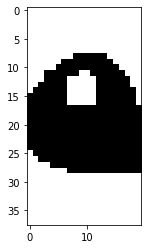

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/e84n2_8.png


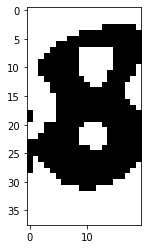

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e84n2_4.png


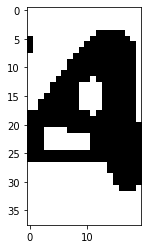

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e84n2_n.png


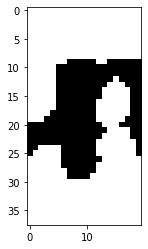

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e84n2_2.png


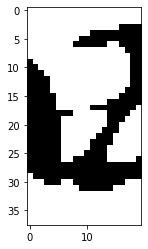

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bf52c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bf52c_b.png


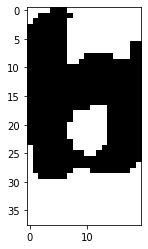

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bf52c_f.png


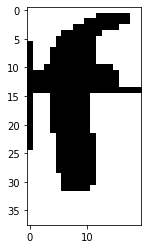

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bf52c_5.png


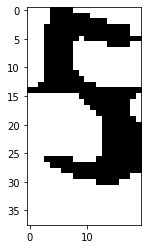

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/bf52c_2.png


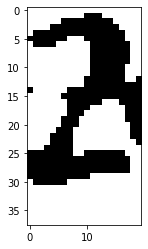

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bf52c_c.png


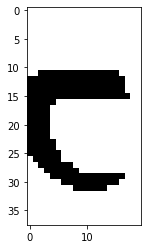

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4egem.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4egem_4.png


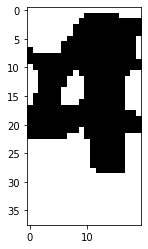

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/4egem_e.png


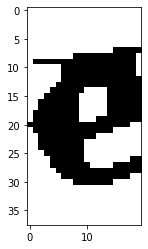

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4egem_g.png


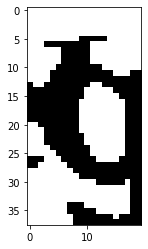

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/4egem_e.png


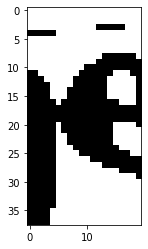

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4egem_m.png


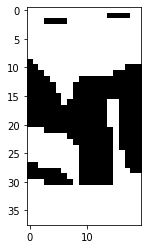

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddcdd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcdd_d.png


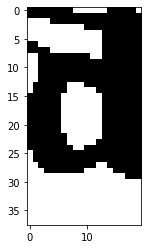

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcdd_d.png


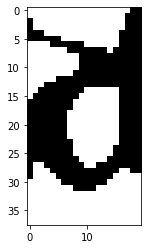

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ddcdd_c.png


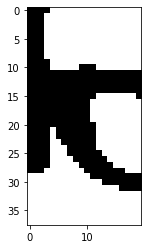

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcdd_d.png


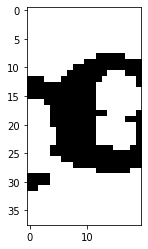

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcdd_d.png


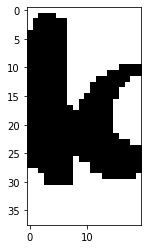

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e8e5e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e8e5e_e.png


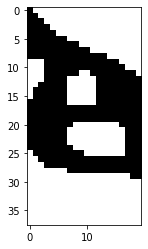

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/e8e5e_8.png


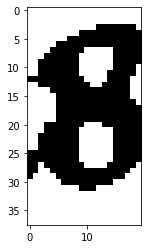

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e8e5e_e.png


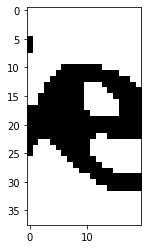

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/e8e5e_5.png


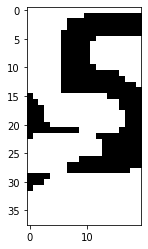

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e8e5e_e.png


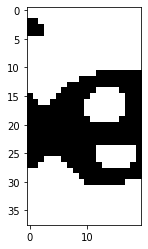

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5bb66.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5bb66_5.png


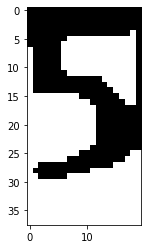

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5bb66_b.png


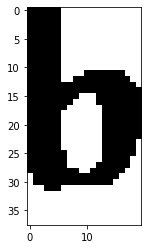

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5bb66_b.png


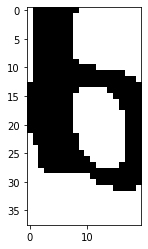

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/5bb66_6.png


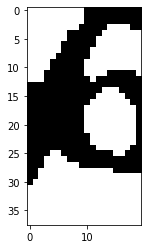

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/5bb66_6.png


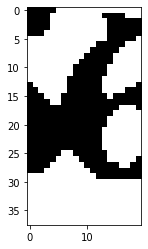

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dw8d3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dw8d3_d.png


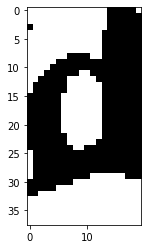

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dw8d3_w.png


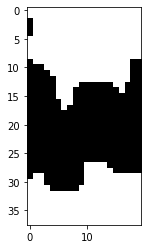

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dw8d3_8.png


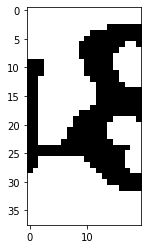

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dw8d3_d.png


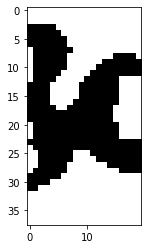

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dw8d3_3.png


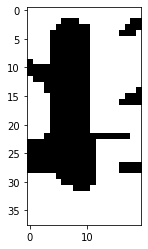

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6c3n6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6c3n6_6.png


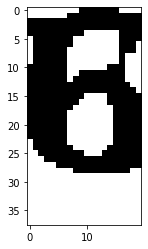

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6c3n6_c.png


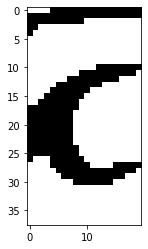

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6c3n6_3.png


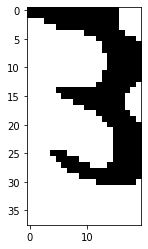

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6c3n6_n.png


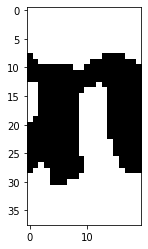

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6c3n6_6.png


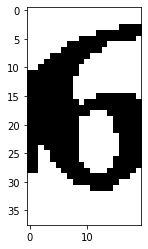

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cd6p4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cd6p4_c.png


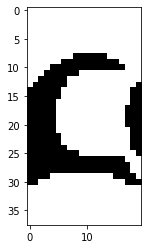

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cd6p4_d.png


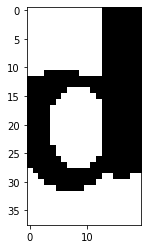

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cd6p4_6.png


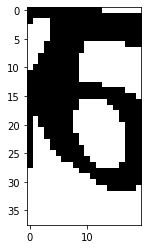

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/cd6p4_p.png


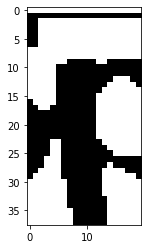

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/cd6p4_4.png


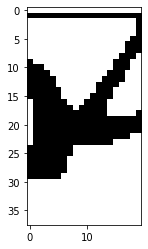

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4b2pw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4b2pw_4.png


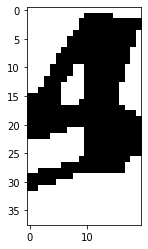

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/4b2pw_b.png


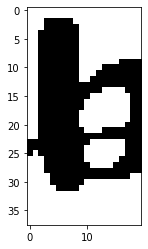

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/4b2pw_2.png


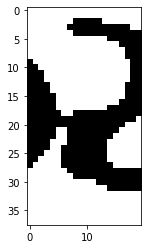

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/4b2pw_p.png


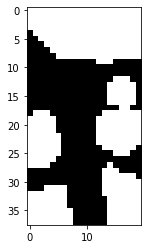

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4b2pw_w.png


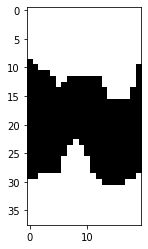

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f228n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f228n_f.png


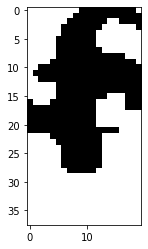

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f228n_2.png


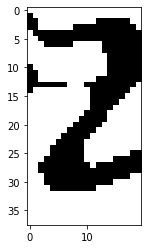

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f228n_2.png


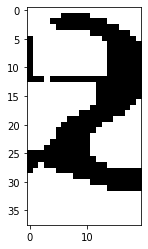

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f228n_8.png


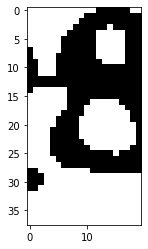

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f228n_n.png


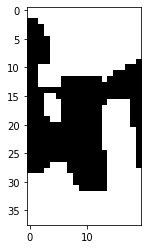

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8gmc4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8gmc4_8.png


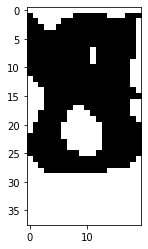

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8gmc4_g.png


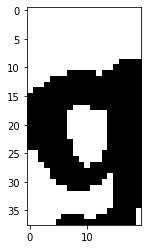

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8gmc4_m.png


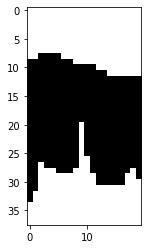

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8gmc4_c.png


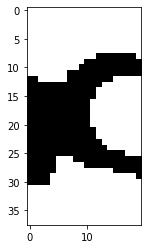

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8gmc4_4.png


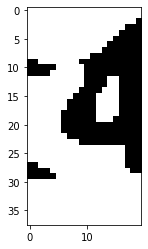

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c3572.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c3572_c.png


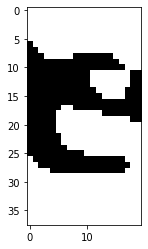

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c3572_3.png


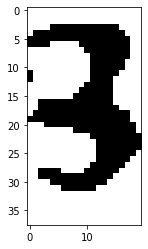

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c3572_5.png


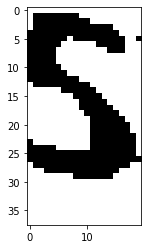

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c3572_7.png


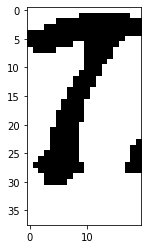

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c3572_2.png


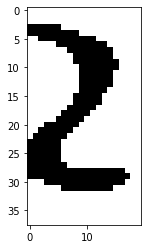

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bw6n6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bw6n6_b.png


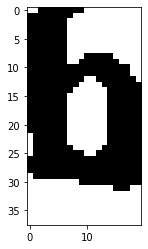

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bw6n6_w.png


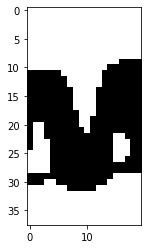

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/bw6n6_6.png


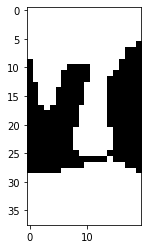

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bw6n6_n.png


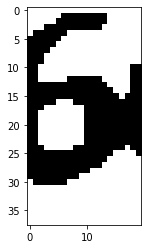

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/bw6n6_6.png


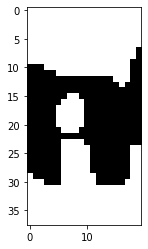

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4c8n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4c8n8_4.png


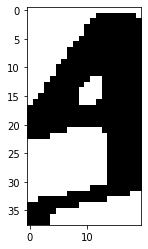

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4c8n8_c.png


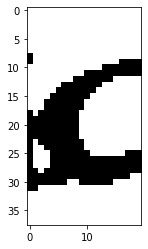

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/4c8n8_8.png


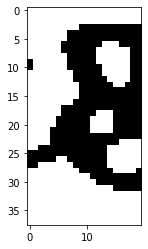

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4c8n8_n.png


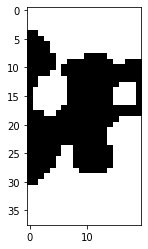

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/4c8n8_8.png


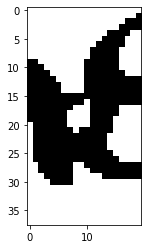

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fg8n4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fg8n4_f.png


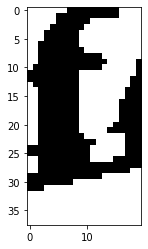

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fg8n4_g.png


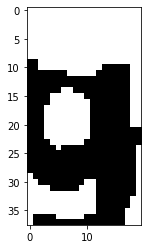

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/fg8n4_8.png


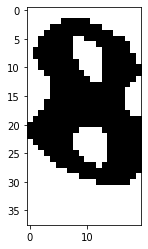

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fg8n4_n.png


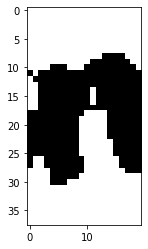

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/fg8n4_4.png


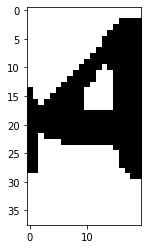

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/44ype.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44ype_4.png


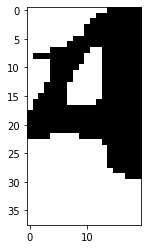

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44ype_4.png


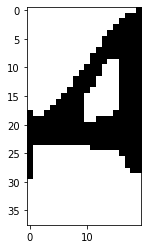

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/44ype_y.png


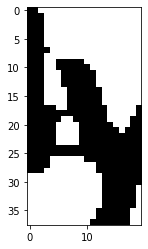

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/44ype_p.png


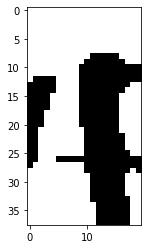

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/44ype_e.png


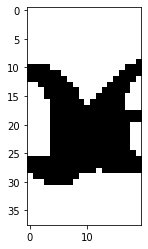

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cfc2y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfc2y_c.png


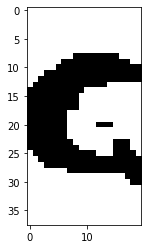

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cfc2y_f.png


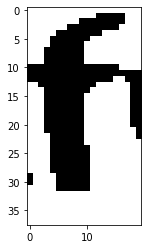

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfc2y_c.png


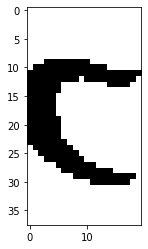

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/cfc2y_2.png


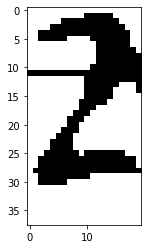

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cfc2y_y.png


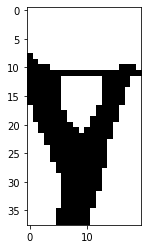

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7fde7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7fde7_7.png


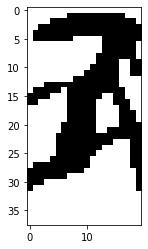

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7fde7_f.png


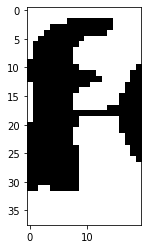

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7fde7_d.png


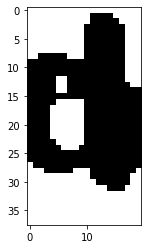

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/7fde7_e.png


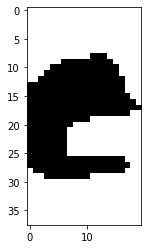

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7fde7_7.png


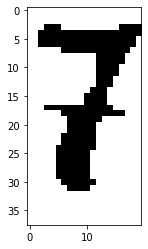

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bxxfc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bxxfc_b.png


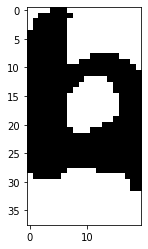

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/bxxfc_x.png


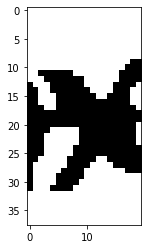

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/bxxfc_x.png


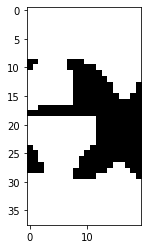

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bxxfc_f.png


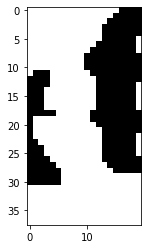

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bxxfc_c.png


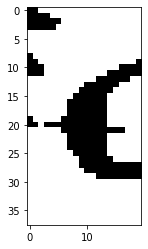

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6m5eg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6m5eg_6.png


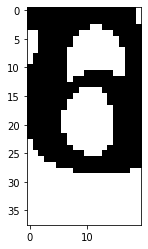

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6m5eg_m.png


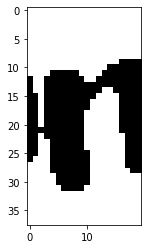

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6m5eg_5.png


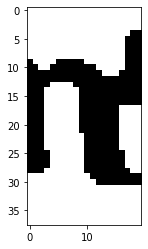

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6m5eg_e.png


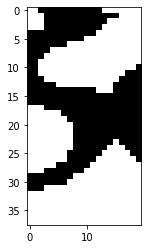

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6m5eg_g.png


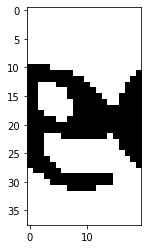

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cnmnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cnmnn_c.png


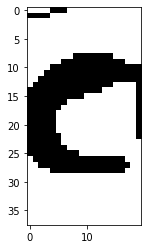

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cnmnn_n.png


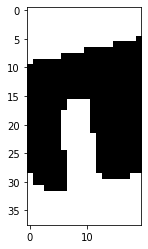

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cnmnn_m.png


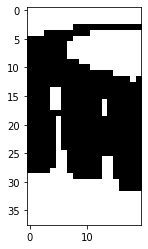

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cnmnn_n.png


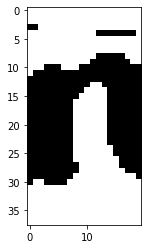

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cnmnn_n.png


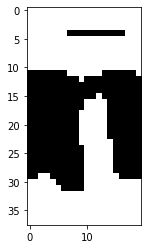

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c8n8c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c8n8c_c.png


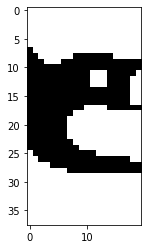

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c8n8c_8.png


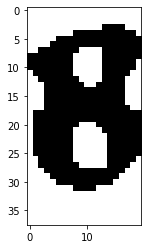

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c8n8c_n.png


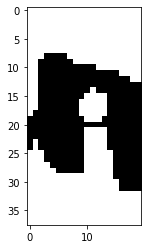

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c8n8c_8.png


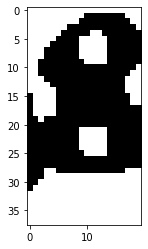

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c8n8c_c.png


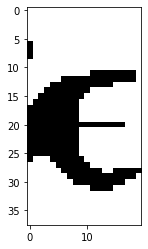

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ffnxn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffnxn_f.png


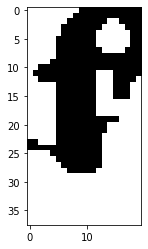

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffnxn_f.png


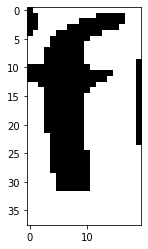

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ffnxn_n.png


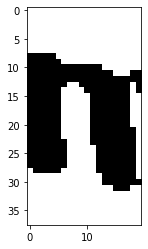

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ffnxn_x.png


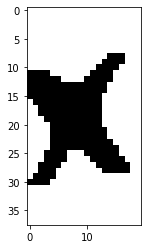

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ffnxn_n.png


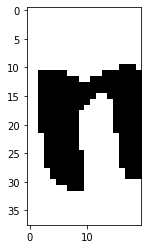

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fbp2c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fbp2c_f.png


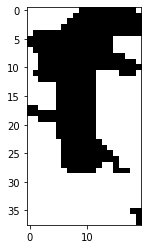

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fbp2c_b.png


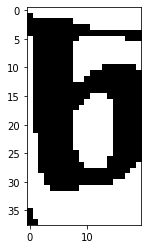

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fbp2c_p.png


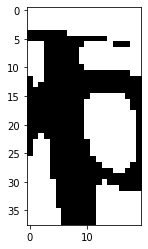

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fbp2c_2.png


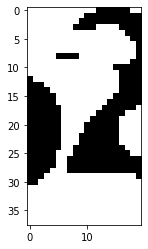

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fbp2c_c.png


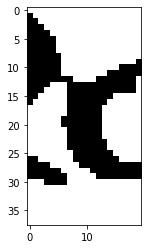

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fp382.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fp382_f.png


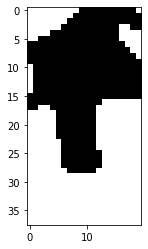

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fp382_p.png


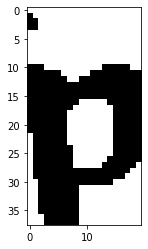

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fp382_3.png


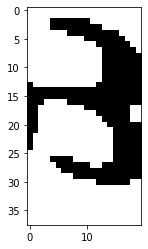

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/fp382_8.png


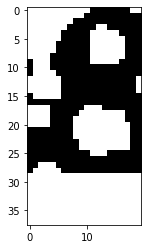

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fp382_2.png


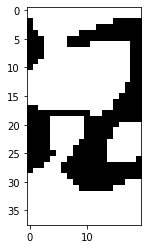

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b43nw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b43nw_b.png


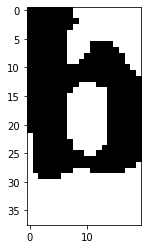

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b43nw_4.png


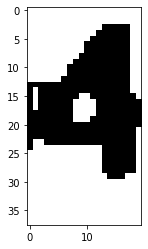

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/b43nw_3.png


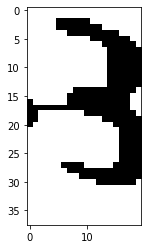

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b43nw_n.png


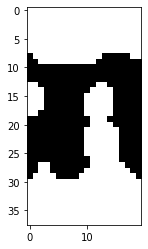

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/b43nw_w.png


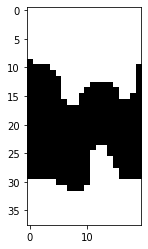

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6n443.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6n443_6.png


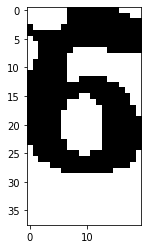

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6n443_n.png


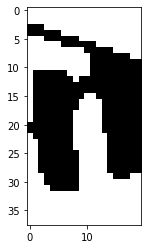

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6n443_4.png


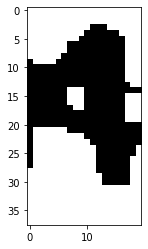

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6n443_4.png


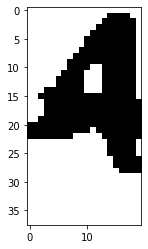

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6n443_3.png


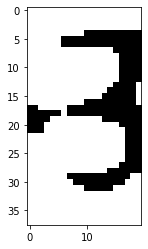

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5nnff.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5nnff_5.png


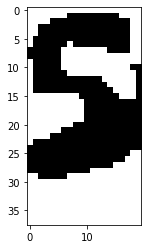

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nnff_n.png


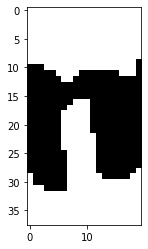

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nnff_n.png


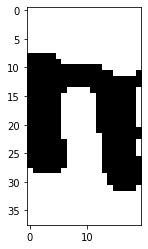

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5nnff_f.png


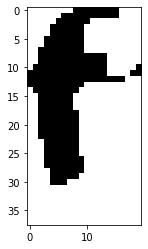

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5nnff_f.png


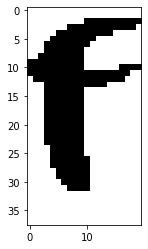

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6b46g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6b46g_6.png


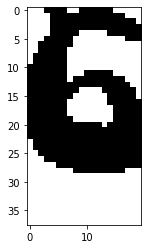

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6b46g_b.png


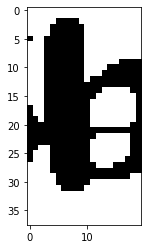

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6b46g_4.png


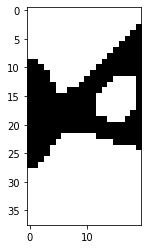

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6b46g_6.png


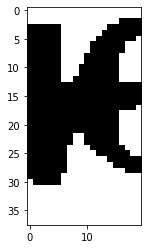

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6b46g_g.png


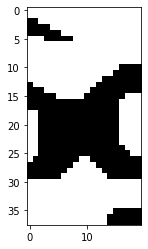

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/53wp3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/53wp3_5.png


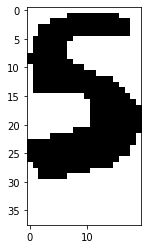

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/53wp3_3.png


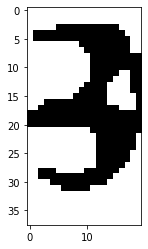

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/53wp3_w.png


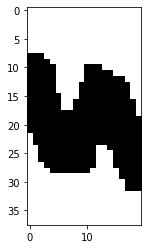

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/53wp3_p.png


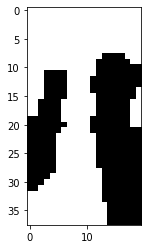

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/53wp3_3.png


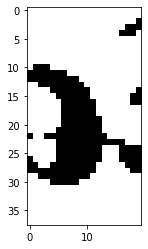

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e6m6p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e6m6p_e.png


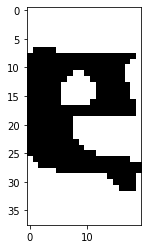

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e6m6p_6.png


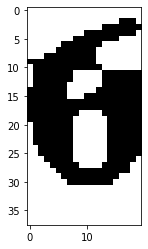

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/e6m6p_m.png


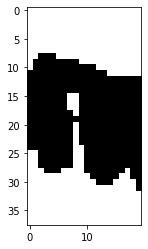

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e6m6p_6.png


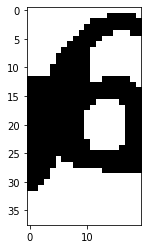

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/e6m6p_p.png


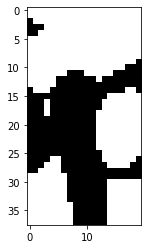

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8d4wm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8d4wm_8.png


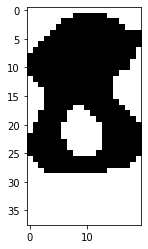

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8d4wm_d.png


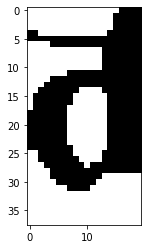

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8d4wm_4.png


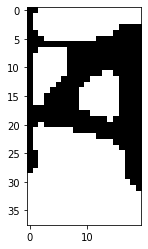

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8d4wm_w.png


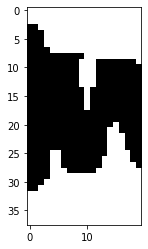

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8d4wm_m.png


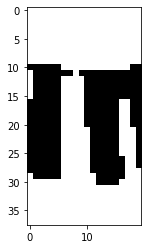

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4m2w5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4m2w5_4.png


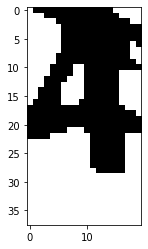

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4m2w5_m.png


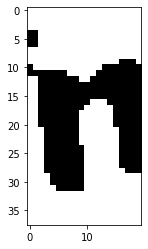

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/4m2w5_2.png


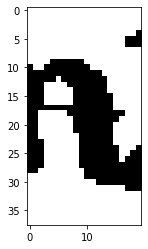

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4m2w5_w.png


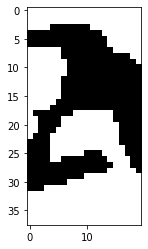

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/4m2w5_5.png


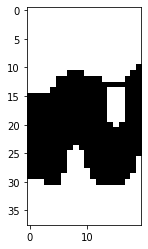

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4gycb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4gycb_4.png


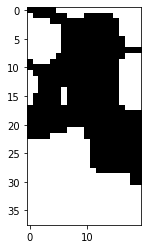

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4gycb_g.png


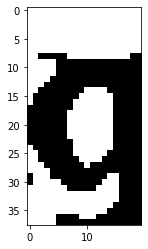

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4gycb_y.png


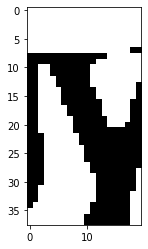

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4gycb_c.png


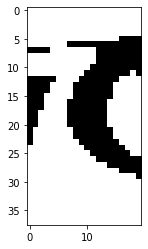

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/4gycb_b.png


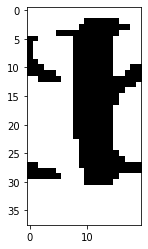

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6xen4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6xen4_6.png


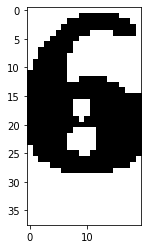

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6xen4_x.png


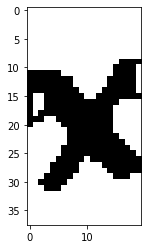

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6xen4_e.png


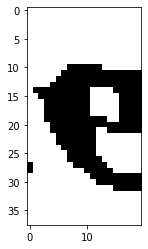

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6xen4_n.png


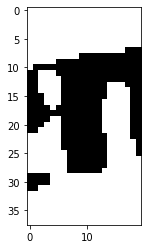

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6xen4_4.png


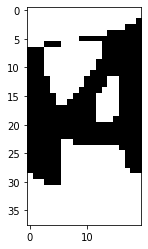

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4743p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4743p_4.png


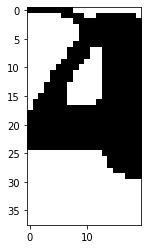

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/4743p_7.png


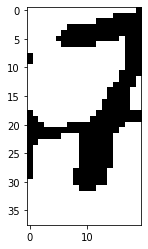

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4743p_4.png


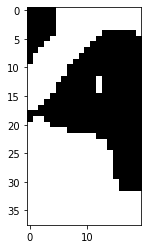

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4743p_3.png


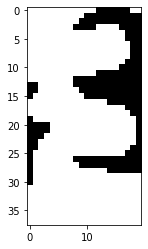

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/4743p_p.png


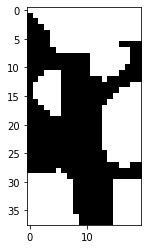

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ec6pm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ec6pm_e.png


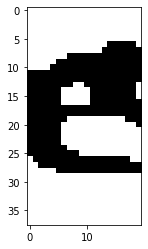

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ec6pm_c.png


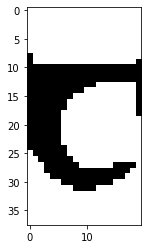

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/ec6pm_6.png


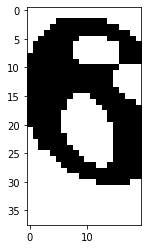

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ec6pm_p.png


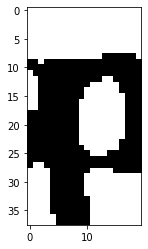

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ec6pm_m.png


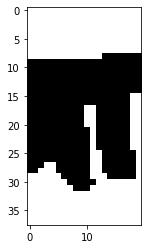

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/66wp5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/66wp5_6.png


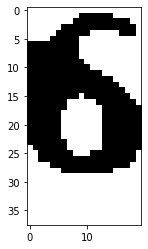

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/66wp5_6.png


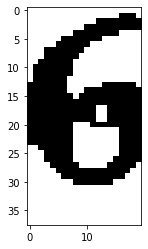

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/66wp5_w.png


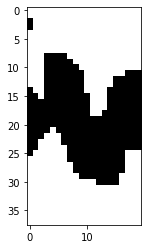

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/66wp5_p.png


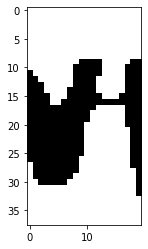

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/66wp5_5.png


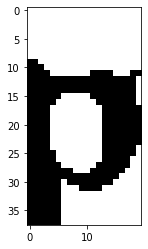

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b84xc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b84xc_b.png


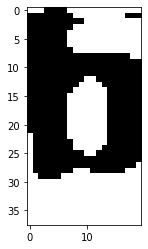

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/b84xc_8.png


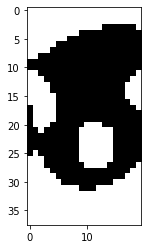

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b84xc_4.png


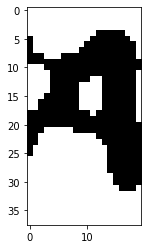

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/b84xc_x.png


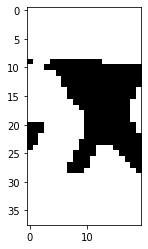

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/b84xc_c.png


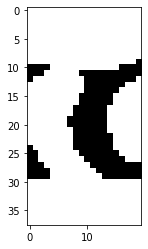

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e76n4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e76n4_e.png


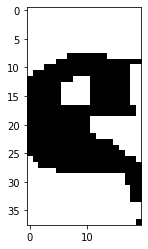

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e76n4_7.png


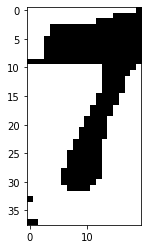

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e76n4_6.png


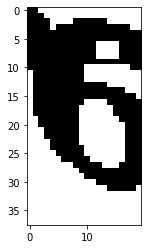

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e76n4_n.png


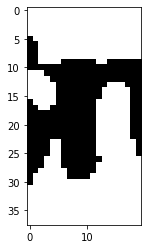

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e76n4_4.png


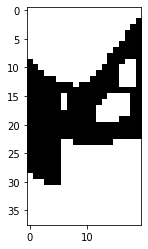

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5p3mm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5p3mm_5.png


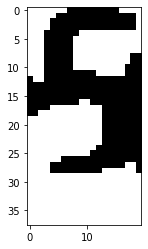

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5p3mm_p.png


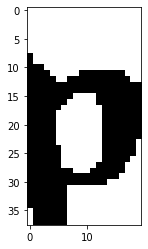

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5p3mm_3.png


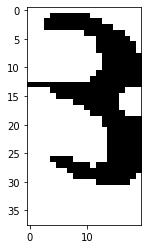

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5p3mm_m.png


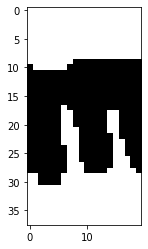

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5p3mm_m.png


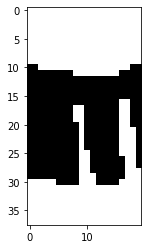

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e8dxn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e8dxn_e.png


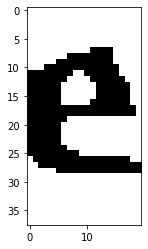

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/e8dxn_8.png


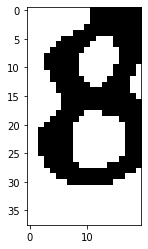

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e8dxn_d.png


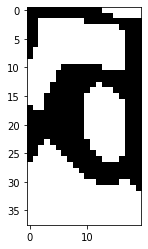

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/e8dxn_x.png


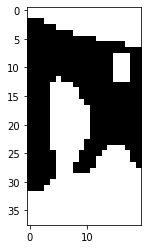

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/e8dxn_n.png


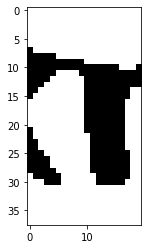

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dmxp8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dmxp8_d.png


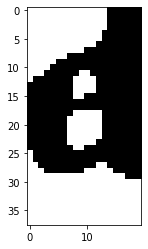

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dmxp8_m.png


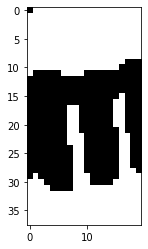

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dmxp8_x.png


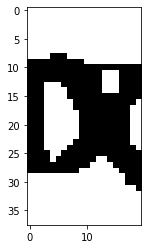

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dmxp8_p.png


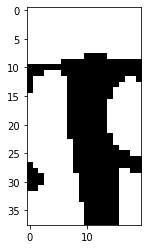

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dmxp8_8.png


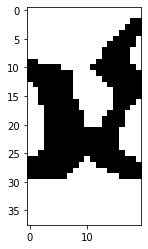

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c6we6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c6we6_c.png


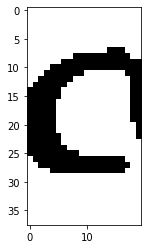

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c6we6_6.png


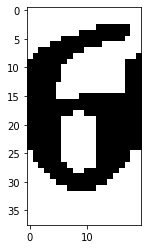

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/c6we6_w.png


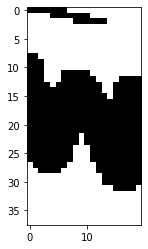

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/c6we6_e.png


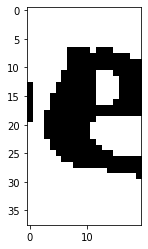

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c6we6_6.png


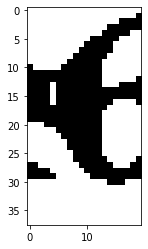

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4nc37.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4nc37_4.png


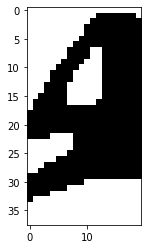

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4nc37_n.png


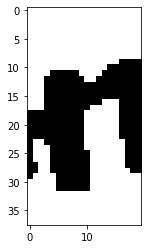

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4nc37_c.png


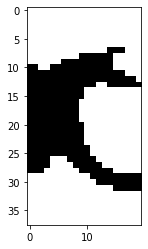

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4nc37_3.png


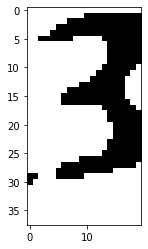

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/4nc37_7.png


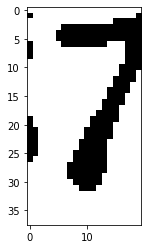

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dpbyd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dpbyd_d.png


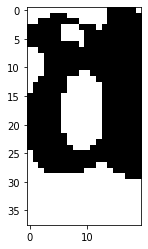

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dpbyd_p.png


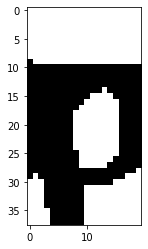

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/dpbyd_b.png


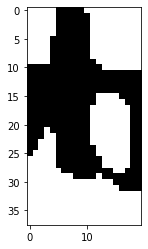

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dpbyd_y.png


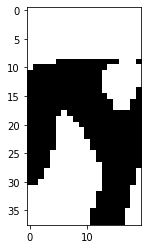

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dpbyd_d.png


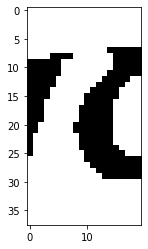

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cy3nw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cy3nw_c.png


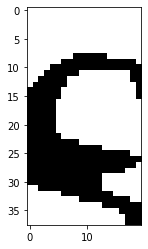

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cy3nw_y.png


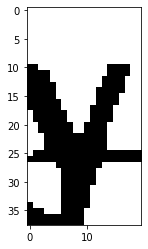

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/cy3nw_3.png


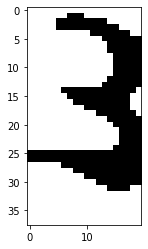

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cy3nw_n.png


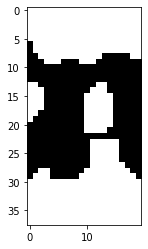

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cy3nw_w.png


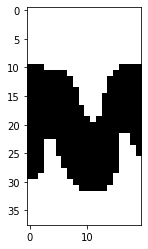

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/55w5c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/55w5c_5.png


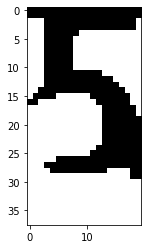

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/55w5c_5.png


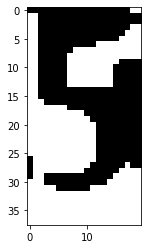

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/55w5c_w.png


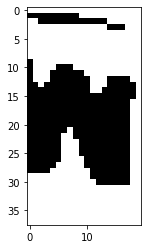

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/55w5c_5.png


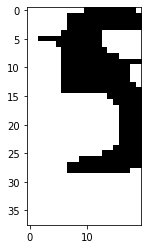

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/55w5c_c.png


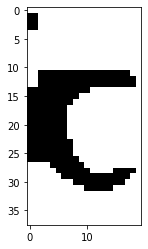

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d75b5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d75b5_d.png


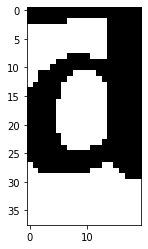

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d75b5_7.png


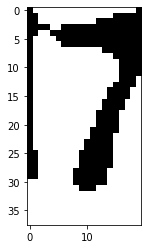

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/d75b5_5.png


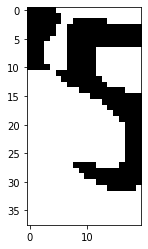

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/d75b5_b.png


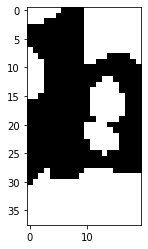

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/d75b5_5.png


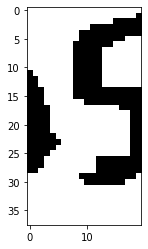

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4w6mw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4w6mw_4.png


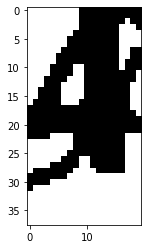

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4w6mw_w.png


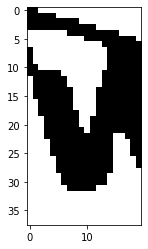

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/4w6mw_6.png


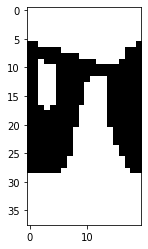

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/4w6mw_m.png


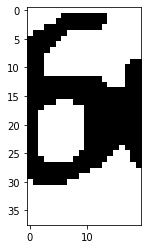

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4w6mw_w.png


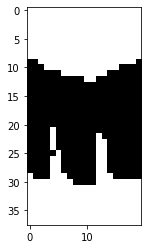

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5expp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5expp_5.png


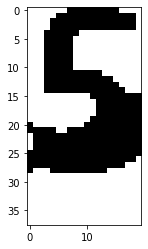

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5expp_e.png


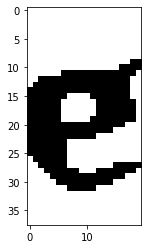

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5expp_x.png


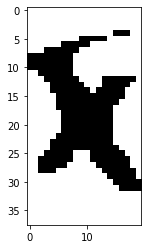

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5expp_p.png


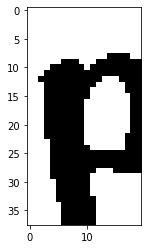

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5expp_p.png


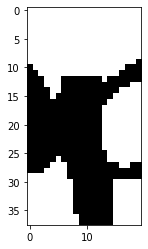

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dw3nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dw3nn_d.png


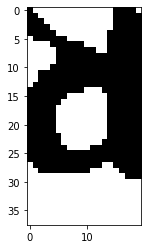

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dw3nn_w.png


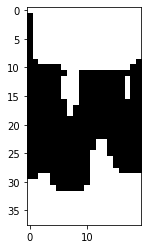

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dw3nn_3.png


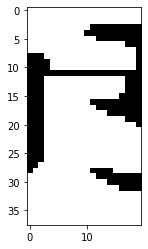

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dw3nn_n.png


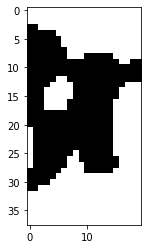

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dw3nn_n.png


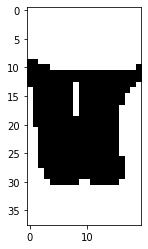

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/enn7n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/enn7n_e.png


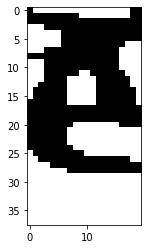

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/enn7n_n.png


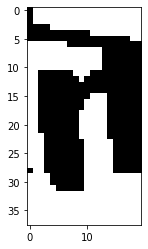

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/enn7n_n.png


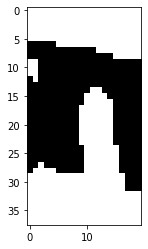

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/enn7n_7.png


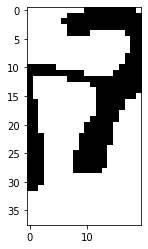

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/enn7n_n.png


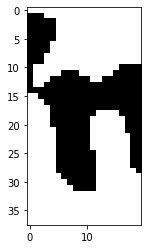

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dc436.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dc436_d.png


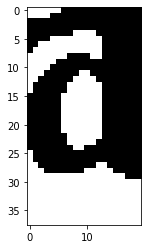

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dc436_c.png


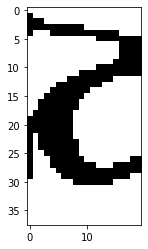

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/dc436_4.png


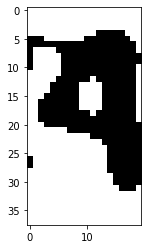

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dc436_3.png


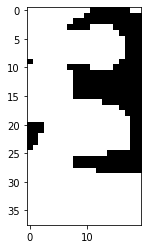

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/dc436_6.png


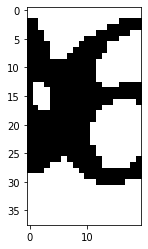

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7dyww.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7dyww_7.png


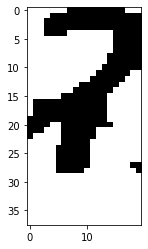

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7dyww_d.png


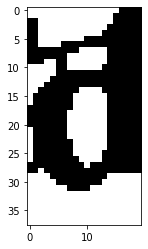

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7dyww_y.png


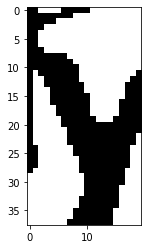

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7dyww_w.png


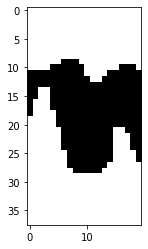

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7dyww_w.png


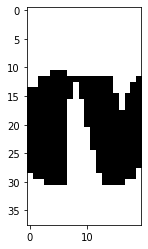

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6end3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6end3_6.png


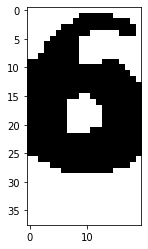

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6end3_e.png


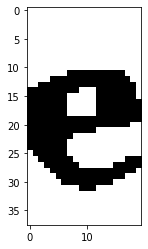

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6end3_n.png


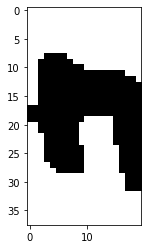

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6end3_d.png


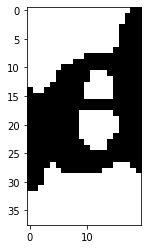

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6end3_3.png


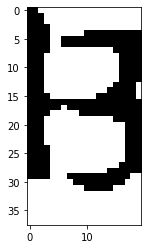

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fnbfw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fnbfw_f.png


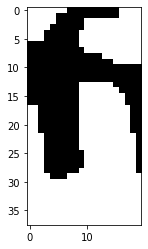

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fnbfw_n.png


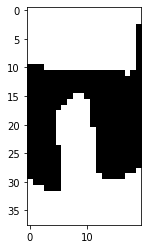

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fnbfw_b.png


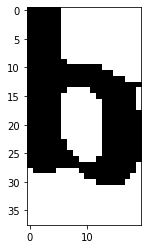

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fnbfw_f.png


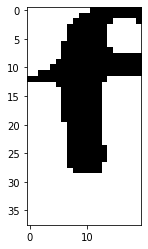

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fnbfw_w.png


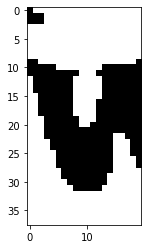

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6wb76.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6wb76_6.png


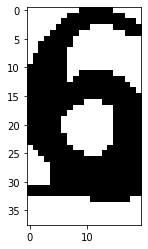

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6wb76_w.png


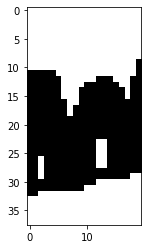

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6wb76_b.png


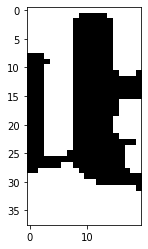

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/6wb76_7.png


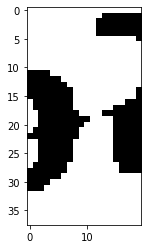

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6wb76_6.png


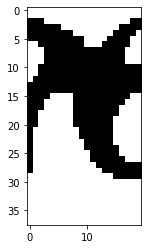

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/62nb3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/62nb3_6.png


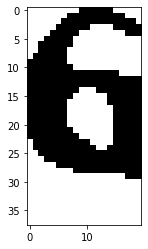

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/62nb3_2.png


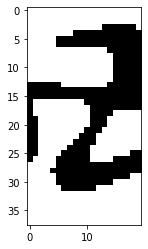

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/62nb3_n.png


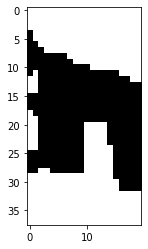

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/62nb3_b.png


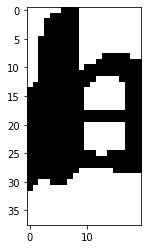

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/62nb3_3.png


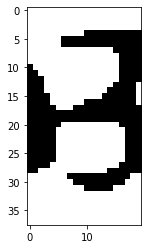

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dn2ym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dn2ym_d.png


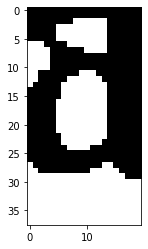

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dn2ym_n.png


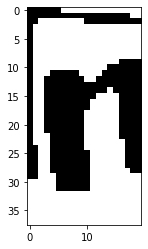

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/dn2ym_2.png


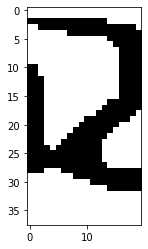

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dn2ym_y.png


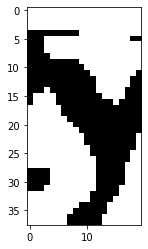

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dn2ym_m.png


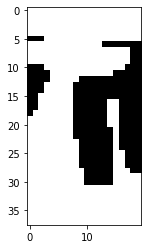

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ef4np.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ef4np_e.png


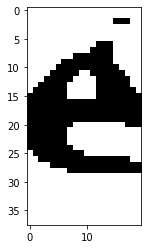

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ef4np_f.png


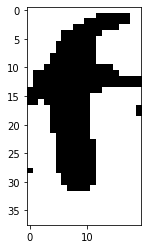

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/ef4np_4.png


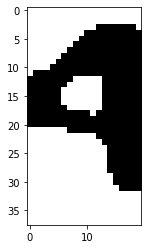

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ef4np_n.png


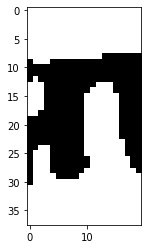

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ef4np_p.png


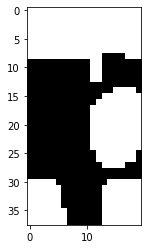

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cwdnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cwdnx_c.png


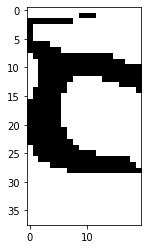

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cwdnx_w.png


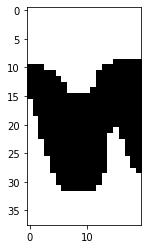

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cwdnx_d.png


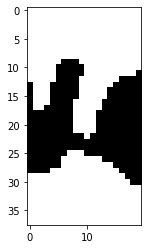

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cwdnx_n.png


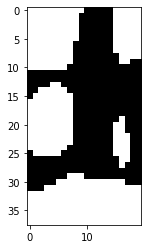

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/cwdnx_x.png


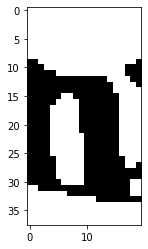

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6xxdx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6xxdx_6.png


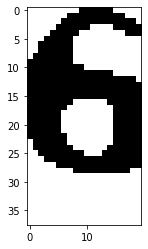

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6xxdx_x.png


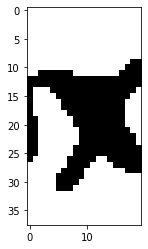

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6xxdx_x.png


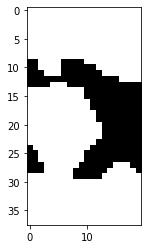

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6xxdx_d.png


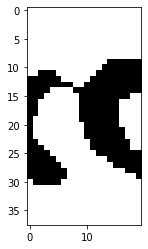

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6xxdx_x.png


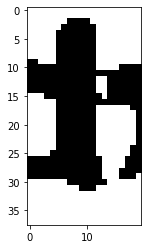

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8npe3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8npe3_8.png


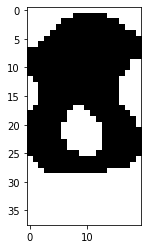

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8npe3_n.png


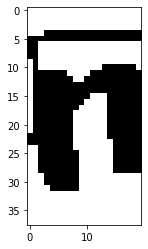

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8npe3_p.png


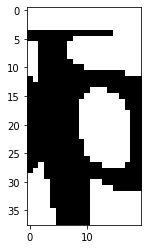

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8npe3_e.png


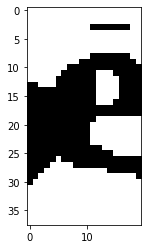

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8npe3_3.png


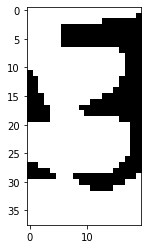

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e46yw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e46yw_e.png


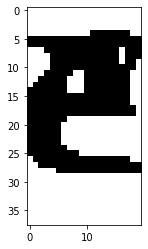

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e46yw_4.png


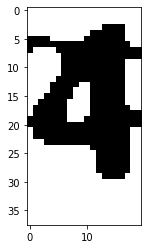

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e46yw_6.png


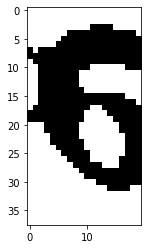

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/e46yw_y.png


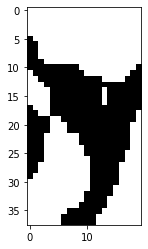

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/e46yw_w.png


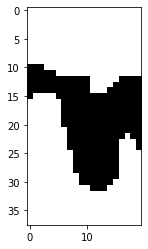

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dy3cx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dy3cx_d.png


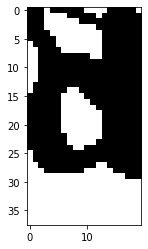

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dy3cx_y.png


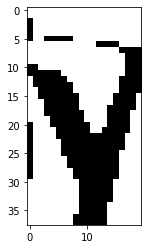

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dy3cx_3.png


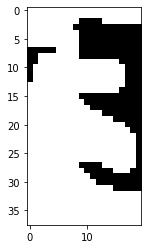

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dy3cx_c.png


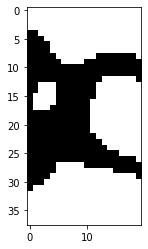

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dy3cx_x.png


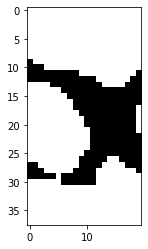

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ffd6p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffd6p_f.png


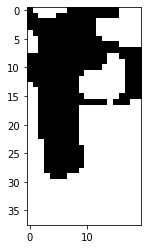

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ffd6p_f.png


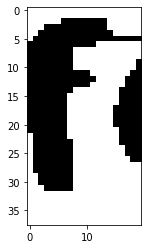

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ffd6p_d.png


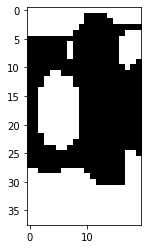

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/ffd6p_6.png


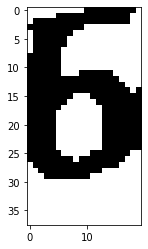

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ffd6p_p.png


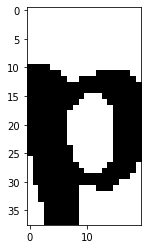

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f2m8n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f2m8n_f.png


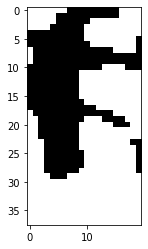

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f2m8n_2.png


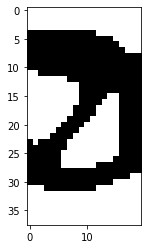

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/f2m8n_m.png


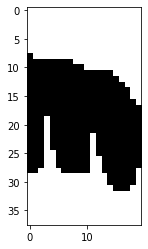

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f2m8n_8.png


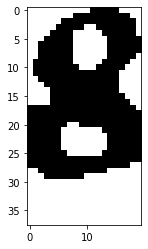

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f2m8n_n.png


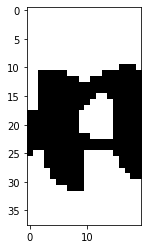

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7d44m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7d44m_7.png


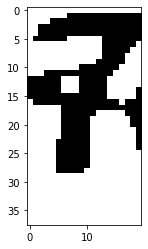

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7d44m_d.png


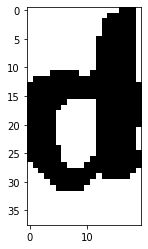

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7d44m_4.png


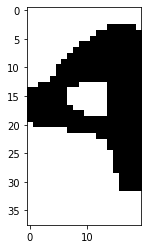

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7d44m_4.png


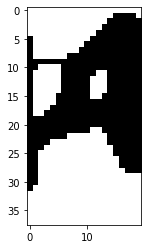

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7d44m_m.png


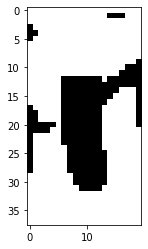

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7b4bm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7b4bm_7.png


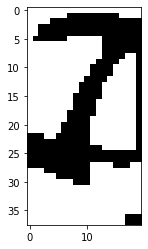

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7b4bm_b.png


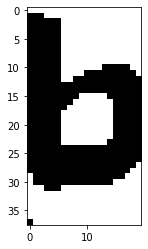

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7b4bm_4.png


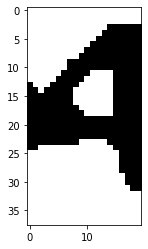

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7b4bm_b.png


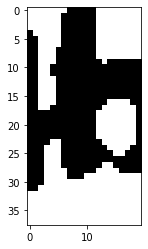

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7b4bm_m.png


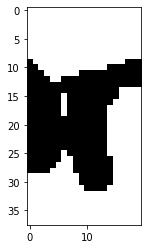

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/88bgx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/88bgx_8.png


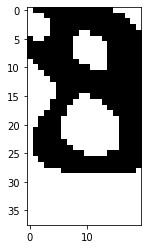

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/88bgx_8.png


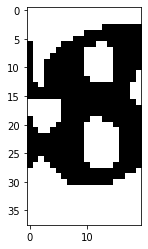

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/88bgx_b.png


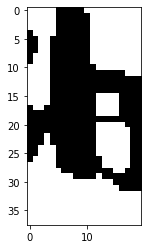

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/88bgx_g.png


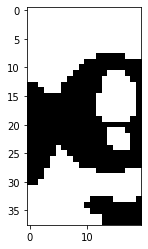

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/88bgx_x.png


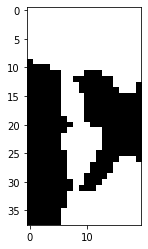

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c4bny.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c4bny_c.png


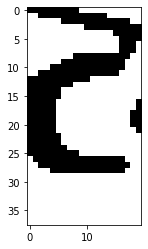

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c4bny_4.png


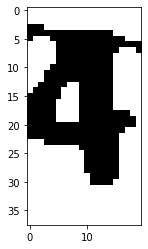

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c4bny_b.png


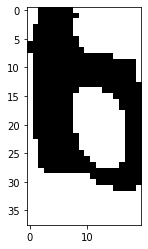

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c4bny_n.png


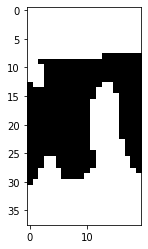

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/c4bny_y.png


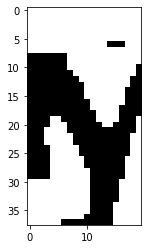

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8pfxx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8pfxx_8.png


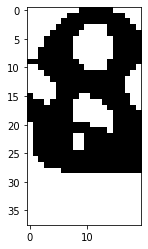

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8pfxx_p.png


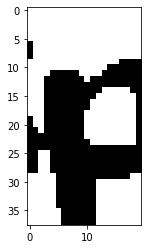

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8pfxx_f.png


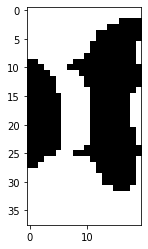

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/8pfxx_x.png


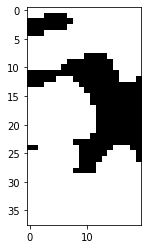

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/8pfxx_x.png


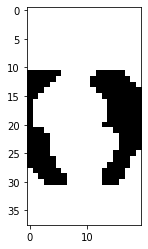

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fp5wn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fp5wn_f.png


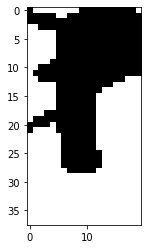

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fp5wn_p.png


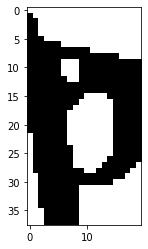

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/fp5wn_5.png


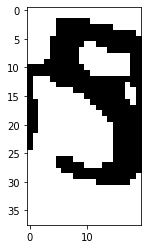

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fp5wn_w.png


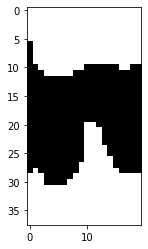

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fp5wn_n.png


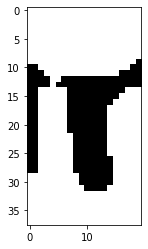

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bw5nf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bw5nf_b.png


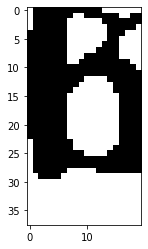

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bw5nf_w.png


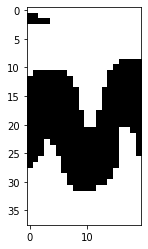

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/bw5nf_5.png


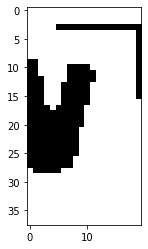

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bw5nf_n.png


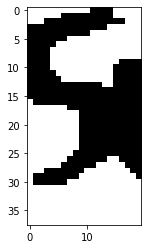

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/bw5nf_f.png


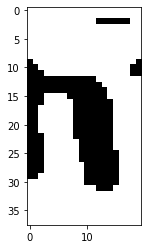

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5fyem.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5fyem_5.png


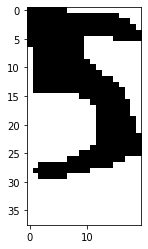

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5fyem_f.png


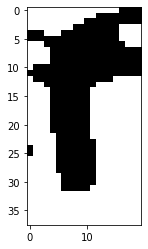

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/5fyem_y.png


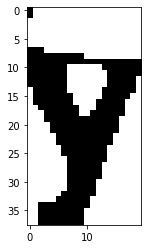

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5fyem_e.png


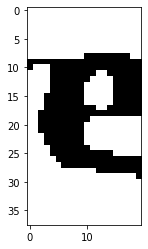

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5fyem_m.png


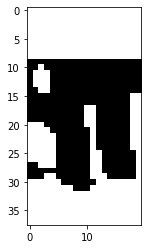

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6ydyp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ydyp_6.png


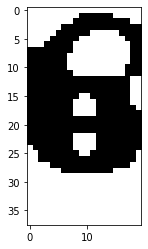

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6ydyp_y.png


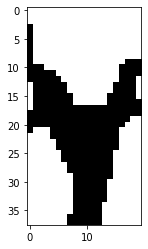

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6ydyp_d.png


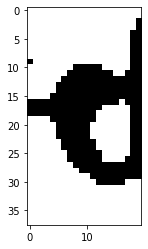

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6ydyp_y.png


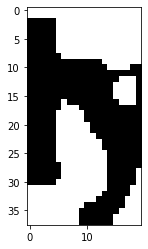

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6ydyp_p.png


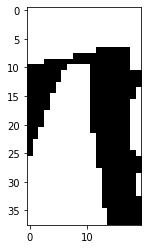

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/467d5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/467d5_4.png


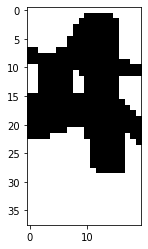

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/467d5_6.png


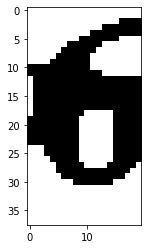

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/467d5_7.png


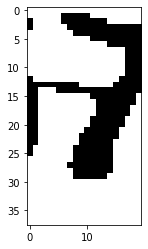

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/467d5_d.png


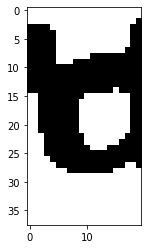

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/467d5_5.png


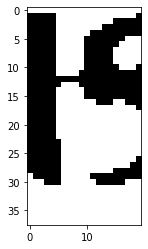

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7e2y7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7e2y7_7.png


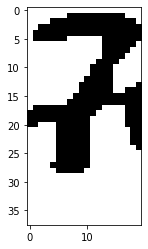

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/7e2y7_e.png


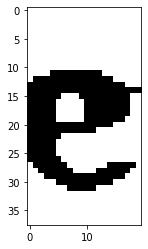

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7e2y7_2.png


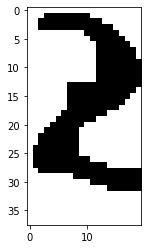

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7e2y7_y.png


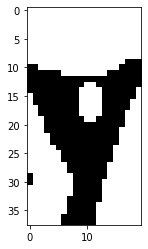

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7e2y7_7.png


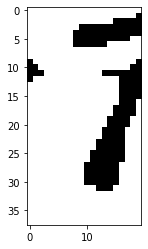

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8c2wy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8c2wy_8.png


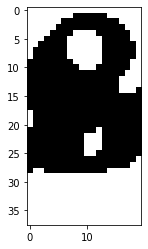

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8c2wy_c.png


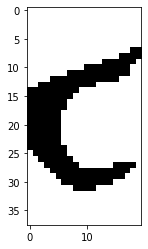

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8c2wy_2.png


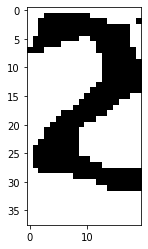

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8c2wy_w.png


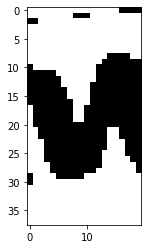

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8c2wy_y.png


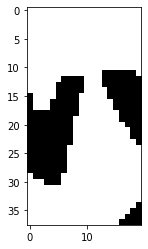

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b5fm7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b5fm7_b.png


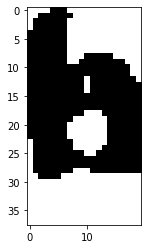

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b5fm7_5.png


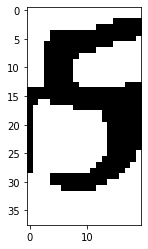

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/b5fm7_f.png


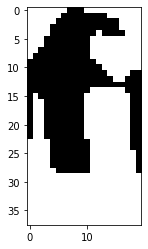

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/b5fm7_m.png


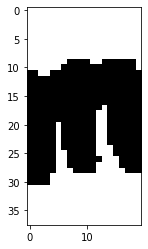

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/b5fm7_7.png


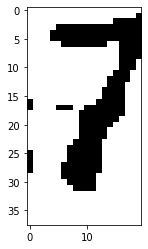

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b35f6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b35f6_b.png


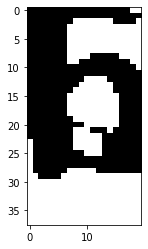

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/b35f6_3.png


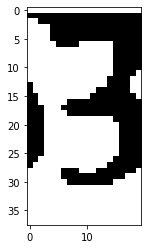

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b35f6_5.png


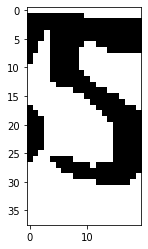

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/b35f6_f.png


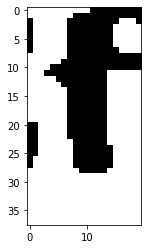

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/b35f6_6.png


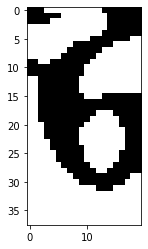

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7yf62.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7yf62_7.png


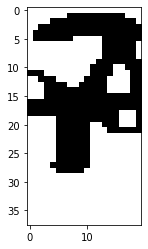

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7yf62_y.png


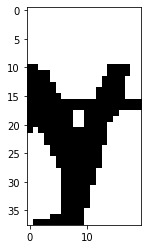

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7yf62_f.png


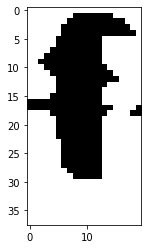

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/7yf62_6.png


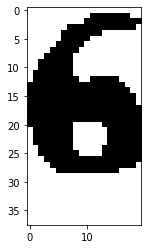

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7yf62_2.png


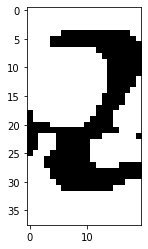

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/efg72.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efg72_e.png


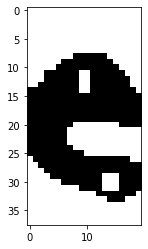

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efg72_f.png


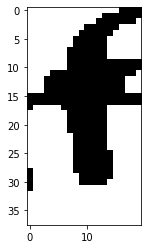

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/efg72_g.png


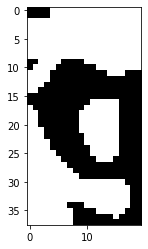

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/efg72_7.png


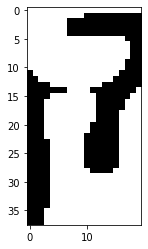

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/efg72_2.png


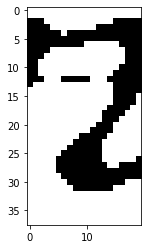

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7y2x4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7y2x4_7.png


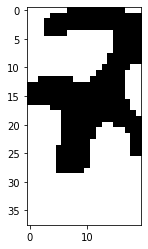

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7y2x4_y.png


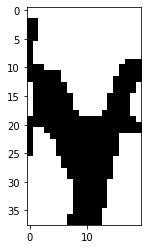

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7y2x4_2.png


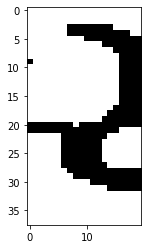

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7y2x4_x.png


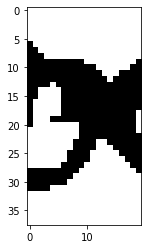

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7y2x4_4.png


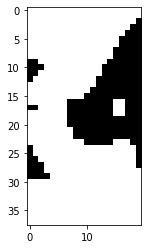

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6fgdw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6fgdw_6.png


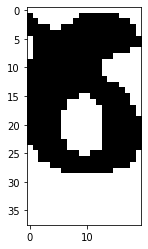

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6fgdw_f.png


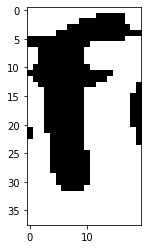

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6fgdw_g.png


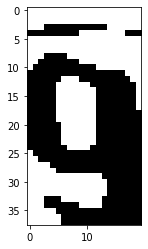

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6fgdw_d.png


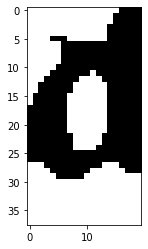

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6fgdw_w.png


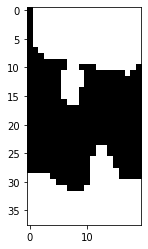

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6pfy4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6pfy4_6.png


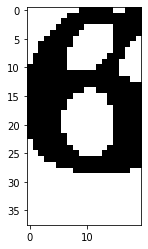

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6pfy4_p.png


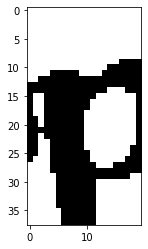

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/6pfy4_f.png


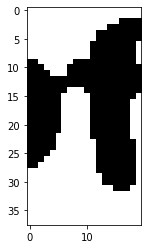

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/6pfy4_y.png


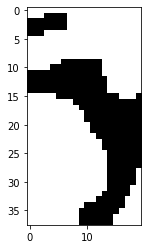

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/6pfy4_4.png


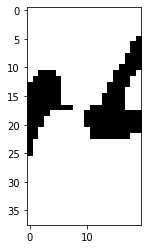

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bp2d4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bp2d4_b.png


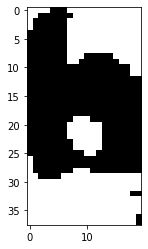

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/bp2d4_p.png


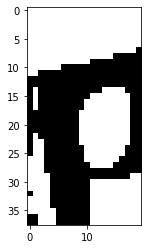

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/bp2d4_2.png


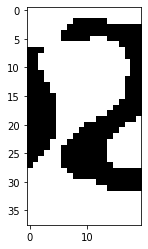

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bp2d4_d.png


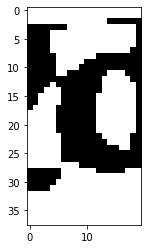

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bp2d4_4.png


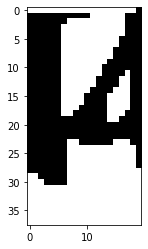

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7gmf3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7gmf3_7.png


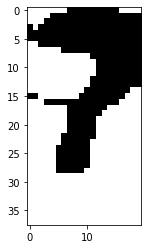

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7gmf3_g.png


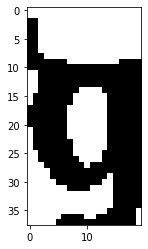

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7gmf3_m.png


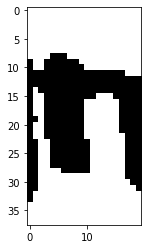

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7gmf3_f.png


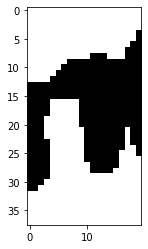

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/7gmf3_3.png


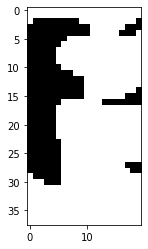

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e3cfe.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e3cfe_e.jpg


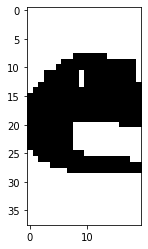

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/e3cfe_3.jpg


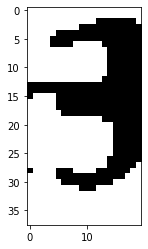

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/e3cfe_c.jpg


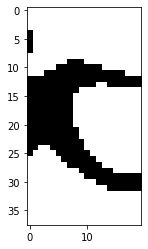

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/e3cfe_f.jpg


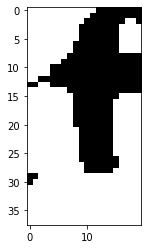

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e3cfe_e.jpg


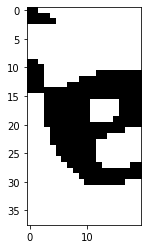

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/574d7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/574d7_5.png


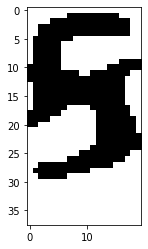

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/574d7_7.png


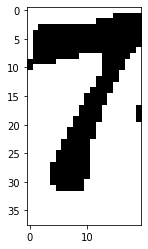

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/574d7_4.png


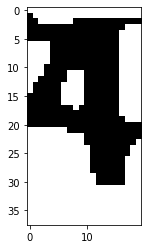

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/574d7_d.png


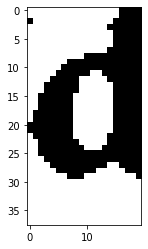

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/574d7_7.png


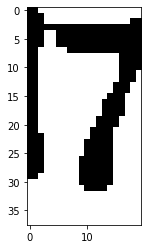

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fy2nd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fy2nd_f.png


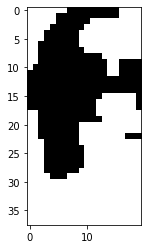

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/fy2nd_y.png


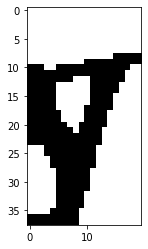

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fy2nd_2.png


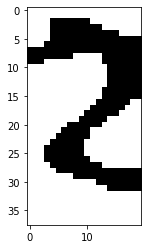

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fy2nd_n.png


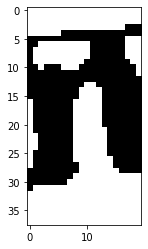

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/fy2nd_d.png


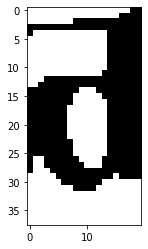

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f74x3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f74x3_f.png


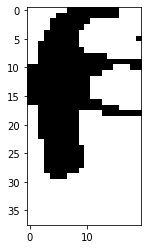

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/f74x3_7.png


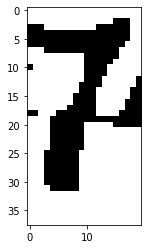

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/f74x3_4.png


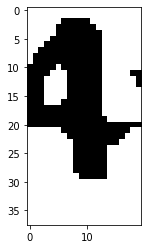

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/f74x3_x.png


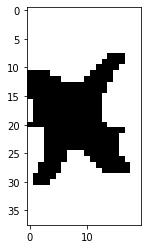

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f74x3_3.png


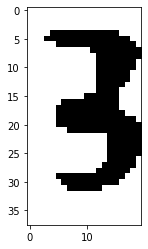

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ecd4w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ecd4w_e.png


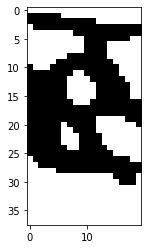

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ecd4w_c.png


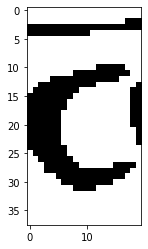

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ecd4w_d.png


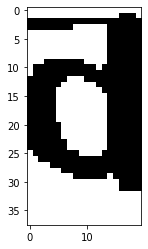

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/ecd4w_4.png


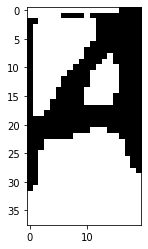

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ecd4w_w.png


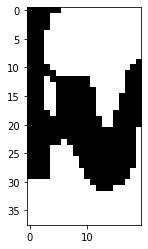

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/87d4c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/87d4c_8.png


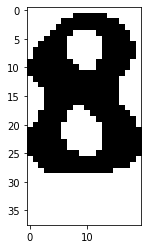

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/87d4c_7.png


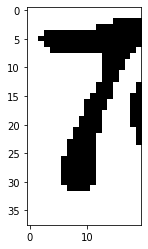

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/87d4c_d.png


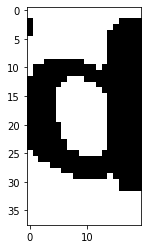

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/87d4c_4.png


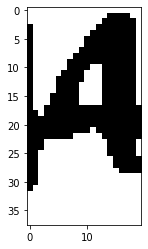

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/87d4c_c.png


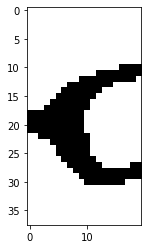

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dyxnc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dyxnc_d.png


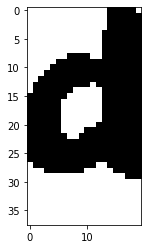

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dyxnc_y.png


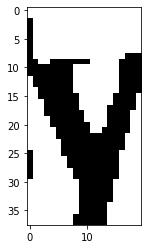

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/dyxnc_x.png


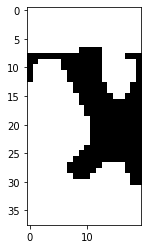

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dyxnc_n.png


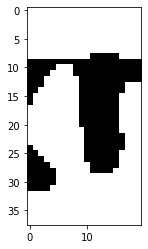

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dyxnc_c.png


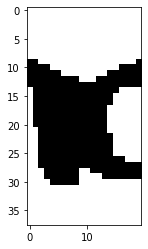

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4n2yg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4n2yg_4.png


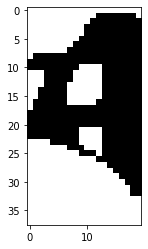

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4n2yg_n.png


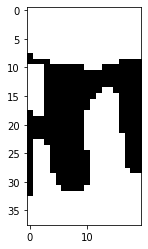

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/4n2yg_2.png


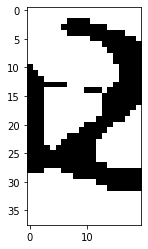

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4n2yg_y.png


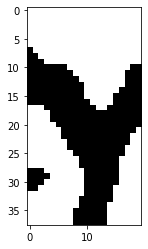

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4n2yg_g.png


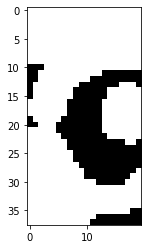

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6p7gx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6p7gx_6.png


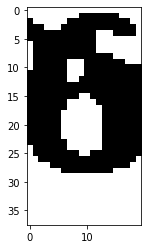

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6p7gx_p.png


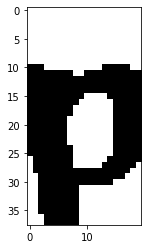

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/6p7gx_7.png


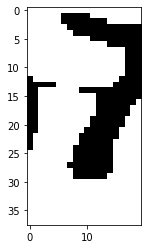

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6p7gx_g.png


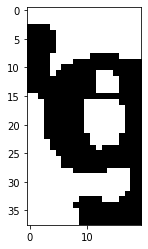

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6p7gx_x.png


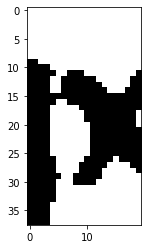

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b4ndb.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b4ndb_b.jpg


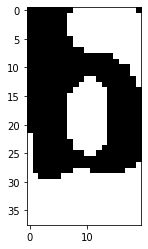

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b4ndb_4.jpg


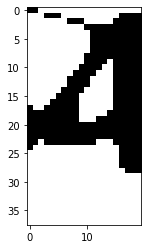

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b4ndb_n.jpg


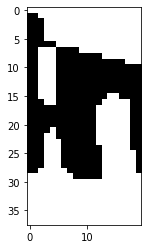

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/b4ndb_d.jpg


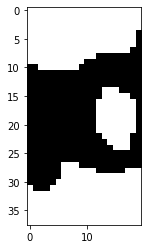

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b4ndb_b.jpg


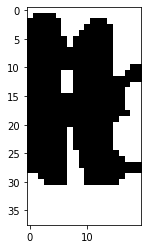

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dw6mn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dw6mn_d.png


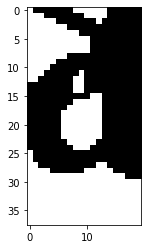

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/dw6mn_w.png


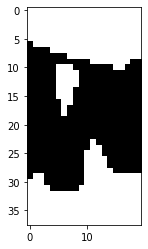

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/dw6mn_6.png


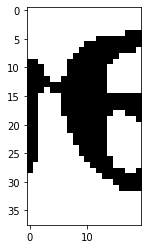

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dw6mn_m.png


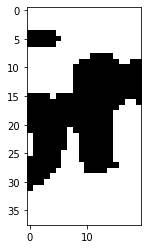

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dw6mn_n.png


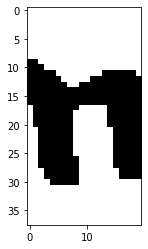

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6pwcn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6pwcn_6.png


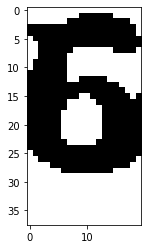

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6pwcn_p.png


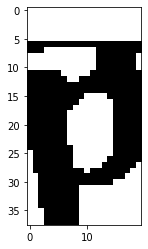

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6pwcn_w.png


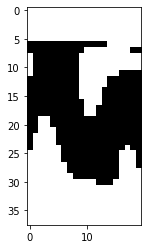

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6pwcn_c.png


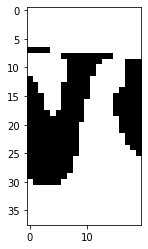

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6pwcn_n.png


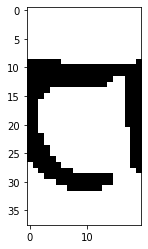

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/76y6f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/76y6f_7.png


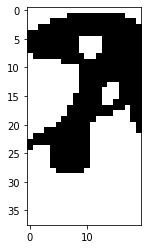

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/76y6f_6.png


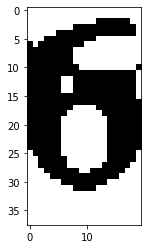

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/76y6f_y.png


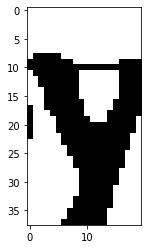

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/76y6f_6.png


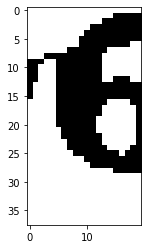

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/76y6f_f.png


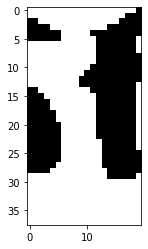

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5xwcg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5xwcg_5.png


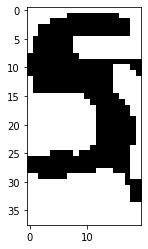

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5xwcg_x.png


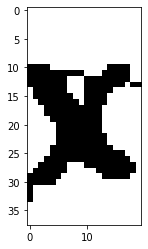

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5xwcg_w.png


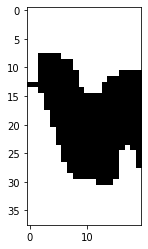

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/5xwcg_c.png


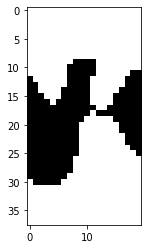

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5xwcg_g.png


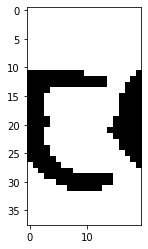

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f6ww8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f6ww8_f.png


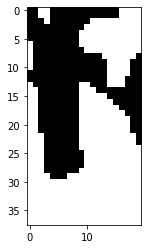

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/f6ww8_6.png


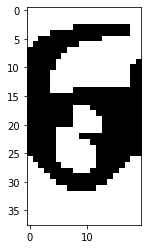

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/f6ww8_w.png


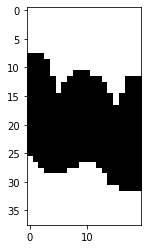

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/f6ww8_w.png


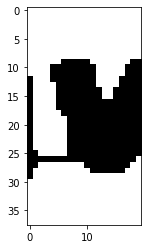

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f6ww8_8.png


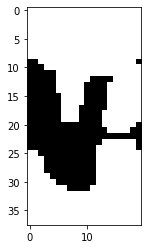

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/85pew.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/85pew_8.jpg


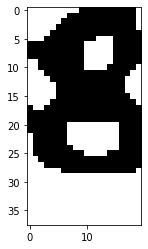

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/85pew_5.jpg


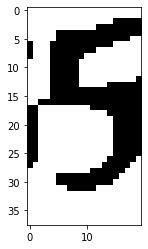

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/85pew_p.jpg


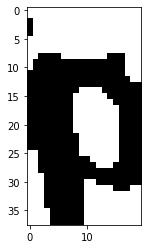

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/85pew_e.jpg


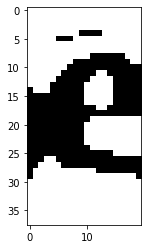

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/85pew_w.jpg


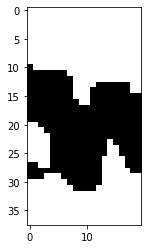

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ewnx8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ewnx8_e.png


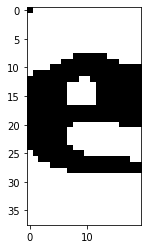

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ewnx8_w.png


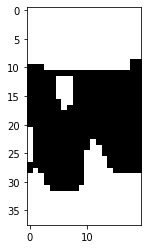

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ewnx8_n.png


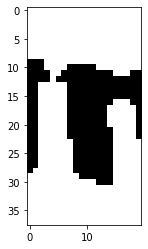

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ewnx8_x.png


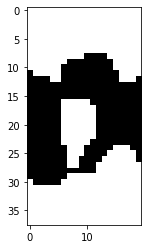

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/ewnx8_8.png


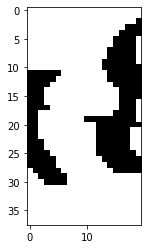

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c2fb7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c2fb7_c.png


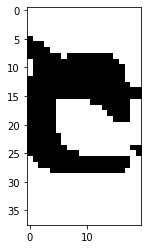

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c2fb7_2.png


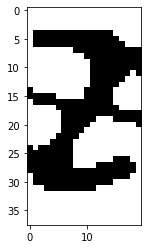

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/c2fb7_f.png


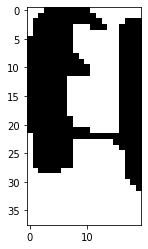

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c2fb7_b.png


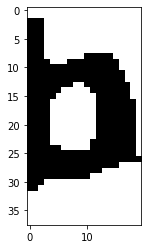

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c2fb7_7.png


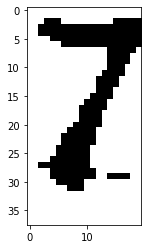

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f4wfn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f4wfn_f.png


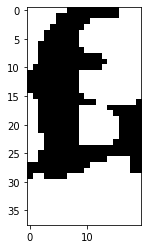

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/f4wfn_4.png


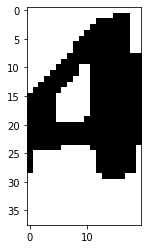

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/f4wfn_w.png


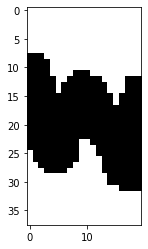

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f4wfn_f.png


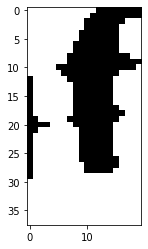

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f4wfn_n.png


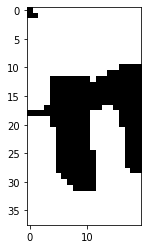

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5ng6e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5ng6e_5.png


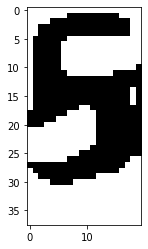

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5ng6e_n.png


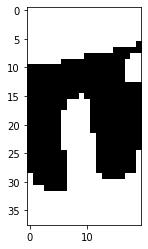

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5ng6e_g.png


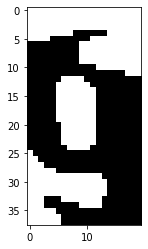

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/5ng6e_6.png


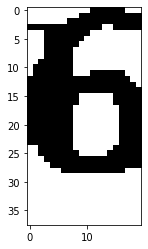

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5ng6e_e.png


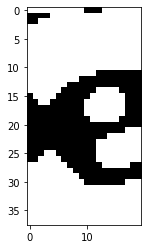

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/enpw2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/enpw2_e.png


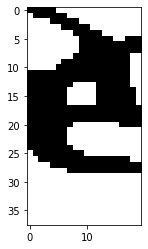

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/enpw2_n.png


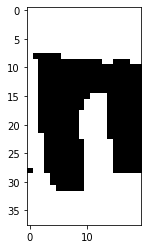

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/enpw2_p.png


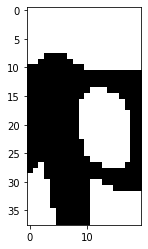

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/enpw2_w.png


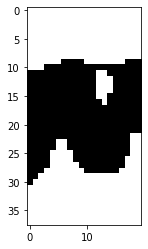

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/enpw2_2.png


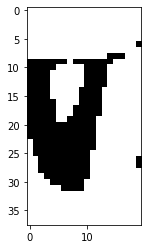

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/efe62.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efe62_e.png


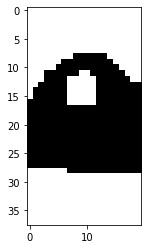

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efe62_f.png


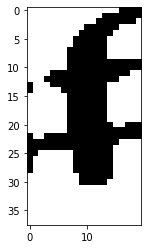

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efe62_e.png


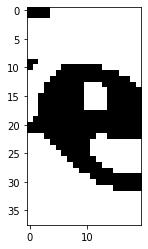

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/efe62_6.png


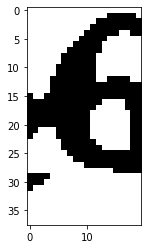

Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/efe62_2.png


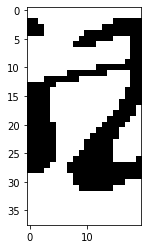

Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/52447.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/52447_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/52447_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/52447_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/52447_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/52447_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d3ycn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d3ycn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d3ycn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d3ycn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d3ycn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d3ycn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddnpf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddnpf_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddnpf_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ddnpf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ddnpf_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ddnpf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bdbb3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bdbb3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bdbb3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bdbb3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bdbb3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/bdbb3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dcnp8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dcnp8_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dcnp8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dcnp8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dcnp8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/dcnp8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddxpp.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddxpp_d.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddxpp_d.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ddxpp_x.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ddxpp_p.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ddxpp_p.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c43b4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c43b4_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c43b4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c43b4_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c43b4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c43b4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/78eec.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/78eec_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/78eec_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/78eec_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/78eec_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/78eec_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7cgym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7cgym_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7cgym_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7cgym_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7cgym_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7cgym_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d3c7y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d3c7y_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/d3c7y_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d3c7y_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/d3c7y_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/d3c7y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d8dce.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d8dce_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d8dce_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d8dce_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d8dce_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/d8dce_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/egxmp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/egxmp_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/egxmp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/egxmp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/egxmp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/egxmp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ccf2w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ccf2w_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ccf2w_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ccf2w_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/ccf2w_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ccf2w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/64b3p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/64b3p_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/64b3p_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/64b3p_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/64b3p_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/64b3p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fncnb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fncnb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fncnb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fncnb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fncnb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fncnb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f5e5e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f5e5e_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f5e5e_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/f5e5e_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f5e5e_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/f5e5e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/excmn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/excmn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/excmn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/excmn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/excmn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/excmn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7p852.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7p852_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7p852_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/7p852_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/7p852_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7p852_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/65nmw.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/65nmw_6.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/65nmw_5.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/65nmw_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/65nmw_m.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/65nmw_w.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/84py4.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/84py4_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/84py4_4.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/84py4_p.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/84py4_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/84py4_4.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cb8cf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cb8cf_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/cb8cf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/cb8cf_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cb8cf_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cb8cf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/664dn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/664dn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/664dn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/664dn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/664dn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/664dn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d2n8x.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d2n8x_d.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d2n8x_2.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d2n8x_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/d2n8x_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/d2n8x_x.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7dwx4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7dwx4_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7dwx4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7dwx4_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7dwx4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7dwx4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dgcm4.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dgcm4_d.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/dgcm4_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dgcm4_c.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/dgcm4_m.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/dgcm4_4.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8nn73.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8nn73_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8nn73_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8nn73_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8nn73_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/8nn73_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f4fn2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f4fn2_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/f4fn2_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f4fn2_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f4fn2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f4fn2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5ywwf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5ywwf_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/5ywwf_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5ywwf_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5ywwf_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5ywwf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/62fgn.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/62fgn_6.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/62fgn_2.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/62fgn_f.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/62fgn_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/62fgn_n.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5mnpd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5mnpd_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5mnpd_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5mnpd_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5mnpd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5mnpd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f858x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f858x_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f858x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f858x_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f858x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/f858x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7gp47.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7gp47_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7gp47_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7gp47_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/7gp47_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7gp47_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bd3b7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bd3b7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bd3b7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/bd3b7_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bd3b7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/bd3b7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d6fcn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d6fcn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d6fcn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/d6fcn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d6fcn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d6fcn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f2fge.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f2fge_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/f2fge_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f2fge_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/f2fge_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/f2fge_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7gce6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7gce6_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7gce6_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7gce6_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/7gce6_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/7gce6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f75cx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f75cx_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/f75cx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f75cx_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/f75cx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/f75cx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5mf7c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5mf7c_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5mf7c_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5mf7c_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5mf7c_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/5mf7c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dbpcd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dbpcd_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/dbpcd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dbpcd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/dbpcd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dbpcd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7fmcy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7fmcy_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7fmcy_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7fmcy_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7fmcy_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7fmcy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/78dw6.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/78dw6_7.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/78dw6_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/78dw6_d.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/78dw6_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/78dw6_6.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e7x45.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e7x45_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/e7x45_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/e7x45_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e7x45_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/e7x45_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7w67m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7w67m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7w67m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/7w67m_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7w67m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7w67m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8wy7d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8wy7d_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8wy7d_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8wy7d_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8wy7d_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8wy7d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4exnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4exnn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/4exnn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/4exnn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4exnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4exnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fgb36.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fgb36_f.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fgb36_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fgb36_b.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fgb36_3.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/fgb36_6.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6e2dg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6e2dg_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6e2dg_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/6e2dg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6e2dg_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6e2dg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6dmx7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6dmx7_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/6dmx7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6dmx7_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6dmx7_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/6dmx7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c8fxy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c8fxy_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c8fxy_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/c8fxy_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/c8fxy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/c8fxy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8w875.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8w875_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8w875_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8w875_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8w875_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8w875_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6bnnm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6bnnm_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6bnnm_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6bnnm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6bnnm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6bnnm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/662bw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/662bw_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/662bw_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/662bw_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/662bw_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/662bw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6bxwg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6bxwg_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6bxwg_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/6bxwg_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/6bxwg_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6bxwg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dbny3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dbny3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/dbny3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dbny3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dbny3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/dbny3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c7gb3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c7gb3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c7gb3_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/c7gb3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c7gb3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c7gb3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7nnnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7nnnx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7nnnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7nnnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7nnnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7nnnx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8bbm4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8bbm4_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8bbm4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8bbm4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8bbm4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8bbm4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8bbw8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8bbw8_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8bbw8_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8bbw8_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/8bbw8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8bbw8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4gb3f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4gb3f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4gb3f_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/4gb3f_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4gb3f_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4gb3f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/64m82.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/64m82_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/64m82_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/64m82_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/64m82_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/64m82_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5nxnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5nxnn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nxnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5nxnn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nxnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5nxnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c353e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c353e_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c353e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c353e_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/c353e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/c353e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/728n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/728n8_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/728n8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/728n8_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/728n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/728n8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5npdn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5npdn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5npdn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5npdn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5npdn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5npdn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7f8b3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7f8b3_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7f8b3_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/7f8b3_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7f8b3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/7f8b3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c482b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c482b_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c482b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c482b_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c482b_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/c482b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/67dey.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/67dey_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/67dey_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/67dey_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/67dey_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/67dey_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bmxpe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bmxpe_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/bmxpe_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/bmxpe_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/bmxpe_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/bmxpe_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bdg84.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bdg84_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/bdg84_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/bdg84_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/bdg84_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bdg84_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8gmnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8gmnx_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8gmnx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8gmnx_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8gmnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/8gmnx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/47e4p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/47e4p_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/47e4p_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/47e4p_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/47e4p_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/47e4p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b6f2p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b6f2p_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/b6f2p_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/b6f2p_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/b6f2p_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/b6f2p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5bnd7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5bnd7_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5bnd7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5bnd7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5bnd7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5bnd7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cewnm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cewnm_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cewnm_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cewnm_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cewnm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cewnm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b4d7c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b4d7c_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b4d7c_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/b4d7c_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/b4d7c_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/b4d7c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4ynf3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4ynf3_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4ynf3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4ynf3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4ynf3_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4ynf3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8g4yp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8g4yp_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8g4yp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8g4yp_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8g4yp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8g4yp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f83pn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f83pn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f83pn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f83pn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/f83pn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/f83pn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fp3wy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fp3wy_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fp3wy_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fp3wy_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fp3wy_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/fp3wy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cpc8c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cpc8c_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/cpc8c_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cpc8c_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/cpc8c_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cpc8c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d66cn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d66cn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d66cn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/d66cn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/d66cn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/d66cn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ewyg7.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ewyg7_e.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ewyg7_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ewyg7_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ewyg7_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ewyg7_7.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b5dn4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b5dn4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b5dn4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/b5dn4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b5dn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b5dn4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5325m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5325m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5325m_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5325m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5325m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5325m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cgcgb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cgcgb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cgcgb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cgcgb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/cgcgb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/cgcgb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/68wfd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/68wfd_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/68wfd_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/68wfd_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/68wfd_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/68wfd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/byc82.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/byc82_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/byc82_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/byc82_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/byc82_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/byc82_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/exycn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/exycn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/exycn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/exycn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/exycn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/exycn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cfn53.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfn53_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cfn53_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cfn53_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/cfn53_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/cfn53_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7bwm2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7bwm2_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/7bwm2_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7bwm2_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7bwm2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/7bwm2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e46pd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e46pd_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e46pd_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e46pd_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/e46pd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e46pd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c4527.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c4527_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/c4527_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/c4527_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c4527_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c4527_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8ypdn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8ypdn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/8ypdn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8ypdn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8ypdn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8ypdn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/be6np.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/be6np_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/be6np_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/be6np_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/be6np_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/be6np_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dyp7n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dyp7n_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/dyp7n_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/dyp7n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/dyp7n_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dyp7n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/44xe8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44xe8_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/44xe8_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/44xe8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/44xe8_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/44xe8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/befbd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/befbd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/befbd_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/befbd_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/befbd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/befbd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4cn7b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4cn7b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/4cn7b_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/4cn7b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/4cn7b_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/4cn7b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e2d66.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e2d66_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e2d66_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/e2d66_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e2d66_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/e2d66_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/85dxn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/85dxn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/85dxn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/85dxn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/85dxn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/85dxn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c86md.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c86md_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c86md_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c86md_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/c86md_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/c86md_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cm6yb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cm6yb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/cm6yb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cm6yb_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/cm6yb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/cm6yb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7cdge.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7cdge_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7cdge_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7cdge_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7cdge_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/7cdge_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/57wdp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/57wdp_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/57wdp_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/57wdp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/57wdp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/57wdp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cfw6e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfw6e_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cfw6e_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/cfw6e_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cfw6e_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cfw6e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b5nmm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b5nmm_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b5nmm_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b5nmm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/b5nmm_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/b5nmm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5gcd3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5gcd3_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5gcd3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/5gcd3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5gcd3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5gcd3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddcne.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcne_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddcne_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ddcne_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ddcne_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ddcne_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b4ncn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b4ncn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/b4ncn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b4ncn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/b4ncn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b4ncn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b26nd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b26nd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/b26nd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/b26nd_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b26nd_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/b26nd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5bg8f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5bg8f_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/5bg8f_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5bg8f_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/5bg8f_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/5bg8f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cfp86.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cfp86_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/cfp86_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/cfp86_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/cfp86_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/cfp86_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5x5nx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5x5nx_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5x5nx_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5x5nx_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5x5nx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/5x5nx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f753f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f753f_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/f753f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f753f_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f753f_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f753f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ebcbx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ebcbx_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/ebcbx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ebcbx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/ebcbx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ebcbx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bgb48.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bgb48_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/bgb48_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bgb48_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/bgb48_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/bgb48_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6ecbn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6ecbn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/6ecbn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6ecbn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/6ecbn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6ecbn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5n3w4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5n3w4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5n3w4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5n3w4_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5n3w4_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/5n3w4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/75pfw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/75pfw_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/75pfw_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/75pfw_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/75pfw_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/75pfw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g247w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g247w_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/g247w_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/g247w_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/g247w_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/g247w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6c3p5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6c3p5_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/6c3p5_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6c3p5_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/6c3p5_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/6c3p5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fg7mg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fg7mg_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fg7mg_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/fg7mg_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/fg7mg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fg7mg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/efgx5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/efgx5_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/efgx5_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/efgx5_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/efgx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/efgx5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n4n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n4n8_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n4n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/8n4n8_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n4n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n4n8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7m8px.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7m8px_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7m8px_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/7m8px_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7m8px_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7m8px_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fcmem.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fcmem_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fcmem_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/fcmem_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/fcmem_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/fcmem_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7xcyd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7xcyd_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/7xcyd_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/7xcyd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/7xcyd_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/7xcyd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/76n7p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/76n7p_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/76n7p_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/76n7p_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/76n7p_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/76n7p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/6gnm3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/6gnm3_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/6gnm3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/6gnm3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/6gnm3_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/6gnm3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f364x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f364x_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f364x_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/f364x_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/f364x_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/f364x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/bcwnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/bcwnn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/bcwnn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/bcwnn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bcwnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/bcwnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ep85x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ep85x_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ep85x_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/ep85x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/ep85x_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ep85x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5wddw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5wddw_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5wddw_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5wddw_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/5wddw_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/5wddw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/be3bp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/be3bp_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/be3bp_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/be3bp_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/be3bp_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/be3bp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/by5y3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/by5y3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/by5y3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/by5y3_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/by5y3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/by5y3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e25xg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e25xg_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e25xg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/e25xg_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/e25xg_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/e25xg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4f8yp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4f8yp_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4f8yp_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/4f8yp_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/4f8yp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/4f8yp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/b5pnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/b5pnn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/b5pnn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/b5pnn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b5pnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/b5pnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c7nn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c7nn8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/c7nn8_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c7nn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c7nn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c7nn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8fexn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8fexn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8fexn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8fexn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/8fexn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8fexn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/eng53.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/eng53_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/eng53_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/eng53_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/eng53_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/eng53_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5np4m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5np4m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5np4m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5np4m_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/5np4m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5np4m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/537nf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/537nf_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/537nf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/537nf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/537nf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/537nf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/d22bd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d22bd_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22bd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/d22bd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/d22bd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/d22bd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5n728.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5n728_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5n728_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/5n728_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/5n728_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/5n728_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4dw3w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4dw3w_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/4dw3w_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4dw3w_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/4dw3w_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/4dw3w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8db67.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8db67_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/8db67_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/8db67_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/8db67_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8db67_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e2mg2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e2mg2_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e2mg2_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/e2mg2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/e2mg2_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/e2mg2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fwxdp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fwxdp_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fwxdp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/fwxdp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/fwxdp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fwxdp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/55y2m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/55y2m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/55y2m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/55y2m_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/55y2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/55y2m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/53mn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/53mn8_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/53mn8_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/53mn8_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/53mn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/53mn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dn26n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dn26n_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dn26n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/dn26n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/dn26n_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dn26n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/678w3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/678w3_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/678w3_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/678w3_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/678w3_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/678w3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/77n6g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77n6g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77n6g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/77n6g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/77n6g_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/77n6g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cdcb3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cdcb3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/cdcb3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cdcb3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/cdcb3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/cdcb3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8gecm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8gecm_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8gecm_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/8gecm_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/8gecm_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/8gecm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7g3nf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7g3nf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7g3nf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/7g3nf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7g3nf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7g3nf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/77387.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77387_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77387_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/77387_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/77387_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/77387_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5mgn4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5mgn4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/5mgn4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/5mgn4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5mgn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/5mgn4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/56m6y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/56m6y_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/56m6y_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/56m6y_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/56m6y_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/56m6y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/4dgf7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/4dgf7_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/4dgf7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/4dgf7_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/4dgf7_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/4dgf7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/5ep3n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/5ep3n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/5ep3n_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/5ep3n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/5ep3n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/5ep3n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c6f8g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c6f8g_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/c6f8g_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/c6f8g_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c6f8g_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/c6f8g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/dbfen.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/dbfen_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/dbfen_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/dbfen_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/dbfen_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/dbfen_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n2pg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n2pg_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n2pg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/8n2pg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8n2pg_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8n2pg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7pn5g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7pn5g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7pn5g_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7pn5g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/7pn5g_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7pn5g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7mgmf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7mgmf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7mgmf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/7mgmf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7mgmf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/7mgmf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/65ebm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/65ebm_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/65ebm_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/65ebm_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/65ebm_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/65ebm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/e43ym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/e43ym_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/e43ym_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/e43ym_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/e43ym_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/e43ym_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ddpyb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddpyb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ddpyb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ddpyb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ddpyb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/ddpyb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fc2ff.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fc2ff_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/fc2ff_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/fc2ff_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fc2ff_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fc2ff_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fxpw3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fxpw3_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/fxpw3_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fxpw3_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/fxpw3_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/fxpw3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/57gnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/57gnx_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/57gnx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/57gnx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/57gnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/57gnx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fdpgd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fdpgd_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/fdpgd_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/fdpgd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/fdpgd_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/fdpgd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/fyfbn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fyfbn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/fyfbn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/fyfbn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/fyfbn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/fyfbn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/7wnpm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/7wnpm_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/7wnpm_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/7wnpm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/7wnpm_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/7wnpm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/c2yn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/c2yn8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/c2yn8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/c2yn8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/c2yn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/c2yn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ef4mn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ef4mn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ef4mn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/ef4mn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ef4mn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ef4mn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/cnex4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/cnex4_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/cnex4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/cnex4_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/cnex4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/cnex4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8gf7n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8gf7n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/8gf7n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/8gf7n_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/8gf7n_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8gf7n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/8n5pn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/8n5pn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n5pn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/8n5pn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/8n5pn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/8n5pn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/f85y3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/f85y3_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/f85y3_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/f85y3_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/f85y3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/f85y3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pnmxf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pnmxf_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pnmxf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pnmxf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/pnmxf_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pnmxf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gng6e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gng6e_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gng6e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gng6e_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/gng6e_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/gng6e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gc83b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gc83b_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gc83b_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/gc83b_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gc83b_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/gc83b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pxne8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pxne8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/pxne8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pxne8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pxne8_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/pxne8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mmg38.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmg38_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmg38_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/mmg38_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/mmg38_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/mmg38_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nn6w6.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn6w6_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn6w6_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/nn6w6_6.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nn6w6_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/nn6w6_6.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gdng3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gdng3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/gdng3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gdng3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gdng3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gdng3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nnn57.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn57_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn57_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn57_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nnn57_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/nnn57_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mmc5n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmc5n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmc5n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mmc5n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/mmc5n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/mmc5n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nb45d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nb45d_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nb45d_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nb45d_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nb45d_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/nb45d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m22e3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m22e3_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/m22e3_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/m22e3_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/m22e3_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/m22e3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mx8bb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mx8bb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mx8bb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/mx8bb_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mx8bb_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mx8bb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g7wxw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g7wxw_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/g7wxw_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/g7wxw_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/g7wxw_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/g7wxw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfcwy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfcwy_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nfcwy_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nfcwy_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nfcwy_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/nfcwy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gwnm6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gwnm6_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/gwnm6_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gwnm6_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gwnm6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/gwnm6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pm363.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pm363_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pm363_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/pm363_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/pm363_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/pm363_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nny5e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nny5e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nny5e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/nny5e_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nny5e_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/nny5e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/md344.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/md344_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/md344_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/md344_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/md344_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/md344_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mcc2x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mcc2x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mcc2x_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mcc2x_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/mcc2x_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mcc2x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pwn5e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pwn5e_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pwn5e_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pwn5e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pwn5e_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pwn5e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxxf8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxxf8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxxf8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxxf8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nxxf8_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nxxf8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n8wxm.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n8wxm_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/n8wxm_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/n8wxm_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/n8wxm_x.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/n8wxm_m.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ppwyd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ppwyd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ppwyd_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ppwyd_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ppwyd_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ppwyd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p2ym2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p2ym2_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/p2ym2_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/p2ym2_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/p2ym2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/p2ym2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p5nce.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p5nce_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/p5nce_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/p5nce_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/p5nce_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/p5nce_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pmd3w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pmd3w_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pmd3w_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/pmd3w_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/pmd3w_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pmd3w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p7fyp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p7fyp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/p7fyp_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/p7fyp_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/p7fyp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p7fyp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pyefb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pyefb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/pyefb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pyefb_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pyefb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/pyefb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbf8m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nbf8m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nbf8m_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nbf8m_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nbf8m_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nbf8m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pyf65.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pyf65_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/pyf65_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pyf65_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/pyf65_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pyf65_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n4xx5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n4xx5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n4xx5_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/n4xx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/n4xx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n4xx5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pcm7f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pcm7f_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pcm7f_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pcm7f_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/pcm7f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pcm7f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nngxc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nngxc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nngxc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nngxc_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nngxc_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nngxc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p4nm4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p4nm4_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/p4nm4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/p4nm4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/p4nm4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/p4nm4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mcg43.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mcg43_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mcg43_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/mcg43_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/mcg43_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/mcg43_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mye68.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mye68_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/mye68_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/mye68_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/mye68_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/mye68_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pm47f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pm47f_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pm47f_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/pm47f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/pm47f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pm47f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gw53m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gw53m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/gw53m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/gw53m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gw53m_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gw53m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ncww7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ncww7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ncww7_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ncww7_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ncww7_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ncww7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mddgb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mddgb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/mddgb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/mddgb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/mddgb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mddgb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pg2yx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pg2yx_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pg2yx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/pg2yx_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/pg2yx_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/pg2yx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mw5p2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mw5p2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mw5p2_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/mw5p2_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mw5p2_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/mw5p2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nwfde.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nwfde_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nwfde_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nwfde_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/nwfde_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/nwfde_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pf5ng.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pf5ng_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pf5ng_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pf5ng_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pf5ng_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pf5ng_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n8ydd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n8ydd_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/n8ydd_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/n8ydd_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/n8ydd_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/n8ydd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pmf5w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pmf5w_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pmf5w_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pmf5w_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pmf5w_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pmf5w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ng756.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ng756_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ng756_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ng756_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/ng756_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/ng756_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ggd7m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ggd7m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ggd7m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ggd7m_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ggd7m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/ggd7m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n3xfg.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n3xfg_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/n3xfg_3.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/n3xfg_x.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n3xfg_f.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/n3xfg_g.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ny3dw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ny3dw_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ny3dw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/ny3dw_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ny3dw_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ny3dw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/men4f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/men4f_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/men4f_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/men4f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/men4f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/men4f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n6nn2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n6nn2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/n6nn2_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n6nn2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n6nn2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/n6nn2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxx25.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxx25_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxx25_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxx25_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/nxx25_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nxx25_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gfxcc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gfxcc_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/gfxcc_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gfxcc_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gfxcc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gfxcc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n4b4m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n4b4m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n4b4m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/n4b4m_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n4b4m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/n4b4m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nwg2m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nwg2m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nwg2m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nwg2m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/nwg2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nwg2m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pme86.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pme86_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pme86_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pme86_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/pme86_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/pme86_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n6f4b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n6f4b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/n6f4b_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n6f4b_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n6f4b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/n6f4b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gc277.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gc277_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gc277_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gc277_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/gc277_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/gc277_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nnp4e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnp4e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnp4e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/nnp4e_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nnp4e_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/nnp4e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ppx77.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ppx77_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ppx77_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/ppx77_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ppx77_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/ppx77_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nmw46.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nmw46_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nmw46_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nmw46_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nmw46_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/nmw46_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nm46n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nm46n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nm46n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nm46n_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/nm46n_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nm46n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfndw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfndw_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nfndw_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfndw_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/nfndw_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nfndw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n8pfe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n8pfe_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/n8pfe_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/n8pfe_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n8pfe_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/n8pfe_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n3bm6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n3bm6_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/n3bm6_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/n3bm6_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/n3bm6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/n3bm6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gxx2p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gxx2p_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gxx2p_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gxx2p_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gxx2p_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/gxx2p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gy433.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gy433_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/gy433_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/gy433_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gy433_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gy433_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mmfm6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmfm6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmfm6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/mmfm6_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmfm6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/mmfm6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m75bf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m75bf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/m75bf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/m75bf_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/m75bf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/m75bf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pp87n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pp87n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pp87n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/pp87n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/pp87n_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pp87n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nnf8b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnf8b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnf8b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nnf8b_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nnf8b_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nnf8b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g7gnf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g7gnf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/g7gnf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g7gnf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/g7gnf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/g7gnf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nybcx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nybcx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/nybcx_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nybcx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nybcx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nybcx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mbf58.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mbf58_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mbf58_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/mbf58_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/mbf58_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/mbf58_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7dyb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7dyb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/n7dyb_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/n7dyb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/n7dyb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/n7dyb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mwdf6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mwdf6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mwdf6_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/mwdf6_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/mwdf6_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/mwdf6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gn2d3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gn2d3_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gn2d3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gn2d3_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/gn2d3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gn2d3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pdcp4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pdcp4_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/pdcp4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pdcp4_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pdcp4_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/pdcp4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pdw38.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pdw38_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/pdw38_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pdw38_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/pdw38_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/pdw38_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m4g8g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m4g8g_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/m4g8g_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/m4g8g_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/m4g8g_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/m4g8g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mxyxw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mxyxw_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mxyxw_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/mxyxw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mxyxw_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mxyxw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfcb5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfcb5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nfcb5_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nfcb5_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nfcb5_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nfcb5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7enn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7enn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/n7enn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/n7enn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7enn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7enn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p2x7x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p2x7x_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/p2x7x_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/p2x7x_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/p2x7x_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/p2x7x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nn4wx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn4wx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn4wx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nn4wx_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nn4wx_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nn4wx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nnfx3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnfx3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnfx3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nnfx3_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nnfx3_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/nnfx3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n5cm7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n5cm7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n5cm7_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/n5cm7_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/n5cm7_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/n5cm7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gnc3n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gnc3n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gnc3n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gnc3n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gnc3n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gnc3n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gp7c5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gp7c5_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/gp7c5_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/gp7c5_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gp7c5_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/gp7c5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pnnwy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pnnwy_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pnnwy_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pnnwy_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pnnwy_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/pnnwy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nf8b8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nf8b8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nf8b8_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nf8b8_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nf8b8_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nf8b8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gp22x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gp22x_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/gp22x_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gp22x_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gp22x_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gp22x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7g4f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7g4f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/n7g4f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/n7g4f_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n7g4f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n7g4f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7ff2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n7ff2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/n7ff2_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n7ff2_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/n7ff2_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/n7ff2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ny8np.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ny8np_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ny8np_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/ny8np_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ny8np_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ny8np_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n4cpy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n4cpy_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n4cpy_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/n4cpy_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/n4cpy_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/n4cpy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/myc3c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/myc3c_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/myc3c_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/myc3c_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/myc3c_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/myc3c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nmy2x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nmy2x_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nmy2x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/nmy2x_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/nmy2x_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nmy2x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nf2n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nf2n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nf2n8_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/nf2n8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nf2n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nf2n8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/px2xp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/px2xp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/px2xp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/px2xp_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/px2xp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/px2xp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ny5dp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ny5dp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ny5dp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/ny5dp_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ny5dp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/ny5dp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n5w5g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n5w5g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n5w5g_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/n5w5g_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n5w5g_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/n5w5g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mb4en.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mb4en_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mb4en_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/mb4en_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/mb4en_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/mb4en_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gfbx6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gfbx6_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/gfbx6_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/gfbx6_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gfbx6_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/gfbx6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mdyp7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mdyp7_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/mdyp7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/mdyp7_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mdyp7_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/mdyp7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nf7bn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nf7bn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nf7bn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/nf7bn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nf7bn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nf7bn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/myf82.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/myf82_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/myf82_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/myf82_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/myf82_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/myf82_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n5n8b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n5n8b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n5n8b_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n5n8b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/n5n8b_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/n5n8b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gm2c2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gm2c2_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gm2c2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gm2c2_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gm2c2_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gm2c2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m67b3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m67b3_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/m67b3_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/m67b3_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/m67b3_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/m67b3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nn6mg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn6mg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nn6mg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/nn6mg_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nn6mg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nn6mg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/my84e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/my84e_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/my84e_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/my84e_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/my84e_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/my84e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mmg2m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmg2m_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmg2m_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/mmg2m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/mmg2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mmg2m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxcmn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxcmn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxcmn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nxcmn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nxcmn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxcmn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n265y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n265y_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/n265y_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/n265y_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/n265y_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/n265y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mdxpn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mdxpn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/mdxpn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mdxpn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mdxpn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/mdxpn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m23bp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m23bp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/m23bp_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/m23bp_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/m23bp_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/m23bp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mc35n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mc35n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mc35n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/mc35n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/mc35n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/mc35n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n3m6x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n3m6x_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/n3m6x_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/n3m6x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/n3m6x_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/n3m6x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pgwnp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pgwnp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pgwnp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/pgwnp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pgwnp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pgwnp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pdyc8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pdyc8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/pdyc8_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/pdyc8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pdyc8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/pdyc8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gd4mf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gd4mf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/gd4mf_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/gd4mf_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gd4mf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/gd4mf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pmg55.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pmg55_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pmg55_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pmg55_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pmg55_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/pmg55_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ndyfe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ndyfe_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/ndyfe_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/ndyfe_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ndyfe_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/ndyfe_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m457d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m457d_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/m457d_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/m457d_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/m457d_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/m457d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nd5wg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nd5wg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/nd5wg_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nd5wg_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nd5wg_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nd5wg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ngn26.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ngn26_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ngn26_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ngn26_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/ngn26_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/ngn26_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gc2wd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gc2wd_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gc2wd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/gc2wd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/gc2wd_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/gc2wd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pbpgc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pbpgc_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/pbpgc_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pbpgc_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pbpgc_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pbpgc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ng2gw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ng2gw_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ng2gw_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/ng2gw_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ng2gw_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/ng2gw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nwncn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nwncn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nwncn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nwncn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nwncn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nwncn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m3b5p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m3b5p_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/m3b5p_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/m3b5p_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/m3b5p_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/m3b5p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n4wwn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n4wwn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/n4wwn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/n4wwn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/n4wwn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/n4wwn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfbg8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfbg8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nfbg8_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nfbg8_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nfbg8_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nfbg8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m74dm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m74dm_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/m74dm_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/m74dm_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/m74dm_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m74dm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g55b4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/g55b4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/g55b4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/g55b4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/g55b4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/g55b4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nnn5p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn5p_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn5p_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nnn5p_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nnn5p_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/nnn5p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gm6nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gm6nn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gm6nn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/gm6nn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gm6nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gm6nn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mp7wp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mp7wp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mp7wp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/mp7wp_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mp7wp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mp7wp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gecmf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gecmf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/gecmf_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/gecmf_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gecmf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/gecmf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gd8fb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gd8fb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/gd8fb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/gd8fb_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/gd8fb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/gd8fb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p2dw7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p2dw7_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/p2dw7_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/p2dw7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/p2dw7_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/p2dw7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pgg3n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pgg3n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pgg3n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pgg3n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/pgg3n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pgg3n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/npxb7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/npxb7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/npxb7_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/npxb7_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/npxb7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/npxb7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mwxwp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mwxwp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mwxwp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/mwxwp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/mwxwp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mwxwp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pf4nb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pf4nb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/pf4nb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/pf4nb_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/pf4nb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/pf4nb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nw5b2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nw5b2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nw5b2_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/nw5b2_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nw5b2_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/nw5b2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mn5c4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mn5c4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/mn5c4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/mn5c4_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/mn5c4_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/mn5c4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/px8n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/px8n8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/px8n8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/px8n8_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/px8n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/px8n8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gwn53.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gwn53_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/gwn53_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gwn53_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/gwn53_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/gwn53_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxn4f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxn4f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nxn4f_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nxn4f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nxn4f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nxn4f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m3wfw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m3wfw_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/3/m3wfw_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/m3wfw_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/m3wfw_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/m3wfw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbwnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nbwnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nbwnn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/nbwnn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nbwnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nbwnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gy8xb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gy8xb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/gy8xb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/gy8xb_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gy8xb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/gy8xb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gbxyy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gbxyy_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/gbxyy_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/gbxyy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/gbxyy_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/gbxyy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gmmne.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/gmmne_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gmmne_m.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/gmmne_m.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/gmmne_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/gmmne_e.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nc4yg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nc4yg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/nc4yg_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/4/nc4yg_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/nc4yg_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nc4yg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pgm2e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pgm2e_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pgm2e_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/pgm2e_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/pgm2e_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pgm2e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m5meg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m5meg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/5/m5meg_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/m5meg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/m5meg_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/m5meg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ncfgb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/ncfgb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/ncfgb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/ncfgb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/ncfgb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/ncfgb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbmx7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nbmx7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/nbmx7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/nbmx7_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/x/nbmx7_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/7/nbmx7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p8wwf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/p8wwf_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/p8wwf_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/p8wwf_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/w/p8wwf_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/p8wwf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pcpg6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pcpg6_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pcpg6_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pcpg6_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/pcpg6_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/6/pcpg6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mbp2y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/m/mbp2y_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/b/mbp2y_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/mbp2y_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/2/mbp2y_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/y/mbp2y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pcede.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/p/pcede_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/c/pcede_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pcede_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/pcede_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/e/pcede_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfd8g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/n/nfd8g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/f/nfd8g_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/d/nfd8g_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/8/nfd8g_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/train/g/nfd8g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gfp54.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gfp54_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gfp54_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/gfp54_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/gfp54_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/gfp54_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbfx5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nbfx5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nbfx5_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/nbfx5_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/nbfx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/nbfx5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mg5nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mg5nn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/mg5nn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/mg5nn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mg5nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mg5nn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n5wbg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n5wbg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/n5wbg_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/n5wbg_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/n5wbg_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/n5wbg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gcx6f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gcx6f_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/gcx6f_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gcx6f_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/gcx6f_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gcx6f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/neecd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/neecd_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/neecd_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/neecd_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/neecd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/neecd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g842c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g842c_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g842c_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/g842c_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/g842c_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/g842c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m4fd8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m4fd8_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m4fd8_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/m4fd8_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/m4fd8_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m4fd8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pn7pn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pn7pn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pn7pn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/pn7pn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pn7pn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pn7pn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gnf85.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gnf85_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gnf85_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gnf85_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/gnf85_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/gnf85_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ndg2b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ndg2b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ndg2b_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ndg2b_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/ndg2b_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/ndg2b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nfg23.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nfg23_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/nfg23_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/nfg23_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/nfg23_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/nfg23_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m2nf4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m2nf4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/m2nf4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/m2nf4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/m2nf4_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m2nf4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g6n7x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g6n7x_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/g6n7x_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/g6n7x_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/g6n7x_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/g6n7x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gymmn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gymmn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/gymmn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/gymmn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/gymmn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gymmn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m448b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m448b_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m448b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m448b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m448b_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/m448b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mm3nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mm3nn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mm3nn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/mm3nn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mm3nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mm3nn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mfb3x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mfb3x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/mfb3x_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/mfb3x_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/mfb3x_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/mfb3x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ndecc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ndecc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ndecc_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ndecc_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ndecc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ndecc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n2c85.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n2c85_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/n2c85_2.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/n2c85_c.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/n2c85_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/n2c85_5.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gcfgp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gcfgp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/gcfgp_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gcfgp_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gcfgp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/gcfgp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gewfy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gewfy_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/gewfy_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/gewfy_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gewfy_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/gewfy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mcyfx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mcyfx_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/mcyfx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/mcyfx_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/mcyfx_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/mcyfx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pwmbn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pwmbn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/pwmbn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pwmbn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/pwmbn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pwmbn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m8m4x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m8m4x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m8m4x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m8m4x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m8m4x_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/m8m4x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/geyn5.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/geyn5_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/geyn5_e.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/geyn5_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/geyn5_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/geyn5_5.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pp546.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pp546_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pp546_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/pp546_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/pp546_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/pp546_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gxxpf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gxxpf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gxxpf_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gxxpf_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/gxxpf_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gxxpf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gnbde.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gnbde_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gnbde_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/gnbde_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/gnbde_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/gnbde_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m2576.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m2576_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/m2576_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/m2576_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/m2576_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/m2576_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pgmn2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pgmn2_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/pgmn2_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pgmn2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pgmn2_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/pgmn2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pybee.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pybee_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/pybee_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/pybee_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/pybee_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/pybee_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gpnxn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gpnxn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/gpnxn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gpnxn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gpnxn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gpnxn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7ebx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n7ebx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/n7ebx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/n7ebx_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/n7ebx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/n7ebx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p8ngx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p8ngx_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/p8ngx_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/p8ngx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/p8ngx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/p8ngx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pg4bf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pg4bf_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/pg4bf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/pg4bf_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/pg4bf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/pg4bf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p57fn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p57fn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/p57fn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/p57fn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/p57fn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/p57fn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gn2xy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gn2xy_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gn2xy_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/gn2xy_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gn2xy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/gn2xy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p5g5m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p5g5m_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/p5g5m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/p5g5m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/p5g5m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/p5g5m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mfc35.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mfc35_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/mfc35_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/mfc35_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/mfc35_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/mfc35_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n2gmg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n2gmg_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/n2gmg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/n2gmg_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/n2gmg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/n2gmg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p6mn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p6mn8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/p6mn8_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/p6mn8_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/p6mn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/p6mn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gpxng.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gpxng_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/gpxng_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/gpxng_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gpxng_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gpxng_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxc83.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nxc83_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/nxc83_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/nxc83_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/nxc83_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/nxc83_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbcgb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nbcgb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nbcgb_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/nbcgb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/nbcgb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nbcgb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gm7n8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gm7n8_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/gm7n8_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/gm7n8_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gm7n8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/gm7n8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pe4xn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pe4xn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/pe4xn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/pe4xn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/pe4xn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pe4xn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mmy5n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mmy5n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mmy5n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/mmy5n_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/mmy5n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mmy5n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m3588.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m3588_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/m3588_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/m3588_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m3588_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m3588_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gnbn4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gnbn4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gnbn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/gnbn4_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gnbn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/gnbn4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pg2pm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pg2pm_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/pg2pm_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/pg2pm_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pg2pm_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pg2pm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ne325.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ne325_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ne325_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/ne325_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/ne325_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/ne325_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ny3nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ny3nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ny3nn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/ny3nn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ny3nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ny3nn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mpmy5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mpmy5_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/mpmy5_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mpmy5_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/mpmy5_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/mpmy5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mxnw4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mxnw4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/mxnw4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mxnw4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/mxnw4_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/mxnw4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pxdwp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pxdwp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/pxdwp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/pxdwp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/pxdwp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pxdwp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mc8w2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mc8w2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/mc8w2_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/mc8w2_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/mc8w2_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/mc8w2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mpxfb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mpxfb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/mpxfb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/mpxfb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/mpxfb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/mpxfb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mnef5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mnef5_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mnef5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/mnef5_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/mnef5_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/mnef5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n3ffn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n3ffn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n3ffn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/n3ffn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/n3ffn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n3ffn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n3x4c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n3x4c_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n3x4c_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/n3x4c_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/n3x4c_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/n3x4c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p8c24.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p8c24_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/p8c24_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/p8c24_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/p8c24_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/p8c24_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g8gnd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g8gnd_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g8gnd_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g8gnd_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/g8gnd_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/g8gnd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p24gn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p24gn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/p24gn_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/p24gn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/p24gn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/p24gn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gny6b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gny6b_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/gny6b_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/gny6b_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/gny6b_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/gny6b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m5ym2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m5ym2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/m5ym2_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/m5ym2_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m5ym2_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/m5ym2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n5x2n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n5x2n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/n5x2n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/n5x2n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/n5x2n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n5x2n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gw468.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gw468_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/gw468_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/gw468_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/gw468_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/gw468_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ng6yp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ng6yp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ng6yp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/ng6yp_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ng6yp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/ng6yp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n336e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n336e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n336e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n336e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/n336e_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/n336e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ncw4g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ncw4g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ncw4g_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/ncw4g_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/ncw4g_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ncw4g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ncyx8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ncyx8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ncyx8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ncyx8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/ncyx8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/ncyx8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mgw3n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mgw3n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/mgw3n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/mgw3n_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/mgw3n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/mgw3n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m6n4x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m6n4x_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/m6n4x_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/m6n4x_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/m6n4x_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/m6n4x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pym7p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pym7p_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/pym7p_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pym7p_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/pym7p_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pym7p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p4pde.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p4pde_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/p4pde_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p4pde_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/p4pde_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/p4pde_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g888x.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g888x_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g888x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g888x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g888x_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/g888x_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/neggn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/neggn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/neggn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/neggn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/neggn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/neggn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pw5nc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pw5nc_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/pw5nc_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/pw5nc_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/pw5nc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/pw5nc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n6xc5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n6xc5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/n6xc5_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/n6xc5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/n6xc5_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/n6xc5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g7fmc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g7fmc_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/g7fmc_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/g7fmc_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/g7fmc_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/g7fmc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gf2g4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gf2g4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gf2g4_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/gf2g4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gf2g4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/gf2g4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n2by7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n2by7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/n2by7_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/n2by7_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/n2by7_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/n2by7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pcmcc.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pcmcc_p.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/pcmcc_c.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pcmcc_m.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/pcmcc_c.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/pcmcc_c.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nxf2c.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nxf2c_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/nxf2c_x.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/nxf2c_f.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/nxf2c_2.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/nxf2c_c.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mggce.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mggce_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/mggce_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/mggce_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/mggce_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/mggce_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/m8gmx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m8gmx_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/m8gmx_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/m8gmx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/m8gmx_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/m8gmx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbp3e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nbp3e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nbp3e_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/nbp3e_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/nbp3e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/nbp3e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ndme7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ndme7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ndme7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/ndme7_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ndme7_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/ndme7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n464c.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n464c_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/n464c_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/n464c_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/n464c_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/n464c_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nb267.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nb267_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nb267_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/nb267_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/nb267_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/nb267_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gegw4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gegw4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/gegw4_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gegw4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/gegw4_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/gegw4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/g78gn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g78gn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/g78gn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/g78gn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/g78gn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/g78gn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/gy5bf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/gy5bf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/gy5bf_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/gy5bf_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/gy5bf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/gy5bf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/pwebm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/pwebm_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/pwebm_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/pwebm_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/pwebm_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/pwebm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ng46m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ng46m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ng46m_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/ng46m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/ng46m_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/ng46m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n373n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n373n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n373n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/n373n_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/n373n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n373n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nm248.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nm248_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/nm248_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/nm248_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/nm248_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/nm248_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n7meb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n7meb_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/n7meb_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/n7meb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/n7meb_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/n7meb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/p2m6n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/p2m6n_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/p2m6n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/p2m6n_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/p2m6n_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/p2m6n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/nbwpn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nbwpn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/nbwpn_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/nbwpn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/nbwpn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/nbwpn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/n8fp6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/n8fp6_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/n8fp6_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/n8fp6_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/n8fp6_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/n8fp6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/mgdwb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/mgdwb_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/mgdwb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/mgdwb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/mgdwb_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/mgdwb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x74b2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x74b2_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x74b2_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x74b2_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/x74b2_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x74b2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yf28d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yf28d_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/yf28d_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/yf28d_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/yf28d_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yf28d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yemy4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yemy4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/yemy4_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/yemy4_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yemy4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yemy4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xngxc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xngxc_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xngxc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xngxc_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xngxc_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xngxc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wc2bd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wc2bd_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wc2bd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/wc2bd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/wc2bd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wc2bd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xfn6n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xfn6n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xfn6n_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xfn6n_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xfn6n_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xfn6n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xfg65.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xfg65_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xfg65_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xfg65_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xfg65_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xfg65_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xe6eb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xe6eb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xe6eb_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xe6eb_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xe6eb_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xe6eb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y48c3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y48c3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y48c3_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y48c3_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/y48c3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y48c3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ypp8f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ypp8f_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/ypp8f_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/ypp8f_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/ypp8f_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/ypp8f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wd2gb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wd2gb_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wd2gb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/wd2gb_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/wd2gb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/wd2gb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xnnc3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xnnc3_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnnc3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnnc3_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xnnc3_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/xnnc3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xbcbx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xbcbx_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xbcbx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xbcbx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xbcbx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xbcbx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yge7c.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yge7c_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/yge7c_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/yge7c_e.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yge7c_7.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/yge7c_c.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y5w28.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y5w28_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y5w28_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/y5w28_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y5w28_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y5w28_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y7x8p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y7x8p_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/y7x8p_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/y7x8p_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y7x8p_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/y7x8p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xxney.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxney_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxney_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xxney_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xxney_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xxney_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y4g3b.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y4g3b_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y4g3b_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/y4g3b_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y4g3b_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/y4g3b_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yew6p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yew6p_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/yew6p_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/yew6p_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/yew6p_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/yew6p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yeyn4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yeyn4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/yeyn4_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yeyn4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/yeyn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yeyn4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ymp7g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ymp7g_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/ymp7g_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/ymp7g_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/ymp7g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ymp7g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w2e87.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w2e87_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/w2e87_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/w2e87_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/w2e87_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/w2e87_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xgcxy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xgcxy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xgcxy_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xgcxy_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xgcxy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xgcxy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y2ye8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y2ye8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y2ye8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y2ye8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/y2ye8_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y2ye8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wbncw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wbncw_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/wbncw_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wbncw_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wbncw_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wbncw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y5n6d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y5n6d_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y5n6d_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/y5n6d_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/y5n6d_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/y5n6d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yd38e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yd38e_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yd38e_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/yd38e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/yd38e_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/yd38e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ygenn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ygenn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ygenn_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ygenn_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ygenn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ygenn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xe8xm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xe8xm_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xe8xm_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/xe8xm_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xe8xm_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xe8xm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ypw3d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ypw3d_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/ypw3d_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/ypw3d_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/ypw3d_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ypw3d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w48cw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w48cw_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w48cw_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/w48cw_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/w48cw_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w48cw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w6yne.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w6yne_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w6yne_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/w6yne_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w6yne_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/w6yne_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xyncc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xyncc_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xyncc_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xyncc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xyncc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xyncc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x5f54.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x5f54_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x5f54_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x5f54_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x5f54_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x5f54_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wm746.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wm746_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wm746_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/wm746_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/wm746_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/wm746_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ywn6f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ywn6f_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/ywn6f_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ywn6f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/ywn6f_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/ywn6f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wddcp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wddcp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wddcp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wddcp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wddcp_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/wddcp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xnd3y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xnd3y_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnd3y_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xnd3y_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/xnd3y_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xnd3y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ycmcw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ycmcw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ycmcw_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/ycmcw_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ycmcw_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/ycmcw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wfy5m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wfy5m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/wfy5m_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/wfy5m_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/wfy5m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wfy5m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w52fn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w52fn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/w52fn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/w52fn_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/w52fn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w52fn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w2yp7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w2yp7_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/w2yp7_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/w2yp7_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/w2yp7_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/w2yp7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yw7ny.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yw7ny_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/yw7ny_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yw7ny_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/yw7ny_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yw7ny_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x2cnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x2cnn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x2cnn_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/x2cnn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x2cnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x2cnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w6pxy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w6pxy_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w6pxy_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/w6pxy_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/w6pxy_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/w6pxy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y33nm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y33nm_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y33nm_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y33nm_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/y33nm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/y33nm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wxcn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wxcn8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/wxcn8_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wxcn8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wxcn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/wxcn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w2n7e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w2n7e_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/w2n7e_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w2n7e_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/w2n7e_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/w2n7e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xnn4d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xnn4d_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnn4d_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnn4d_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xnn4d_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xnn4d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ydg8n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ydg8n_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ydg8n_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ydg8n_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/ydg8n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ydg8n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yd3m3.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yd3m3_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yd3m3_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/yd3m3_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/yd3m3_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/yd3m3_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y5dpp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y5dpp_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y5dpp_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/y5dpp_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/y5dpp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/y5dpp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x3deb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x3deb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x3deb_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/x3deb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/x3deb_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/x3deb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yy824.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yy824_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yy824_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/yy824_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/yy824_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yy824_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x4pnp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x4pnp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x4pnp_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/x4pnp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x4pnp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/x4pnp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y2xg4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y2xg4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y2xg4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/y2xg4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/y2xg4_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y2xg4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xmcym.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xmcym_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xmcym_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xmcym_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xmcym_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xmcym_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xxw44.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxw44_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxw44_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/xxw44_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xxw44_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xxw44_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xymfn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xymfn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xymfn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xymfn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xymfn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xymfn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xxbm5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxbm5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xxbm5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xxbm5_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xxbm5_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xxbm5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x775w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x775w_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x775w_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x775w_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x775w_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/x775w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w75w8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w75w8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/w75w8_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/w75w8_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w75w8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/w75w8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x38fn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x38fn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x38fn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/x38fn_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x38fn_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x38fn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wf684.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wf684_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/wf684_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/wf684_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/wf684_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/wf684_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y4ec2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y4ec2_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y4ec2_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/y4ec2_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/y4ec2_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y4ec2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wye85.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wye85_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/wye85_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/wye85_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/wye85_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/wye85_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ycnfc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ycnfc_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ycnfc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/ycnfc_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/ycnfc_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ycnfc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y866y.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y866y_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y866y_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/y866y_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/y866y_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y866y_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wnpec.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wnpec_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wnpec_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/wnpec_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/wnpec_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wnpec_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y2436.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y2436_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y2436_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y2436_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y2436_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/y2436_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yxd7m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yxd7m_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/yxd7m_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yxd7m_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yxd7m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/yxd7m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x7422.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x7422_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x7422_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x7422_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x7422_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x7422_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wwmn6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wwmn6_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wwmn6_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wwmn6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wwmn6_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/wwmn6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x7547.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x7547_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x7547_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x7547_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x7547_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x7547_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yf347.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yf347_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/yf347_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/yf347_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yf347_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yf347_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x76mn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x76mn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x76mn_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/x76mn_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/x76mn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x76mn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yyg5g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yyg5g_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yyg5g_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/yyg5g_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yyg5g_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/yyg5g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x44n4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x44n4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x44n4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x44n4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x44n4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x44n4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w4nfx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w4nfx_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w4nfx_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w4nfx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/w4nfx_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/w4nfx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wdww8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wdww8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wdww8_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wdww8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wdww8_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/wdww8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x347n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x347n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x347n_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x347n_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x347n_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x347n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w4cnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w4cnn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w4cnn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/w4cnn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w4cnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w4cnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w8f36.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w8f36_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/w8f36_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/w8f36_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/w8f36_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w8f36_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xw465.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xw465_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/xw465_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xw465_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xw465_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xw465_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x362g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x362g_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x362g_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/x362g_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x362g_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/x362g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wyc25.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wyc25_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/wyc25_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wyc25_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/wyc25_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/wyc25_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x277e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x277e_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/x277e_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x277e_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x277e_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/x277e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wecfd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wecfd_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/wecfd_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wecfd_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/wecfd_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wecfd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xemyg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xemyg_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xemyg_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xemyg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xemyg_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xemyg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y32yy.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y32yy_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y32yy_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y32yy_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y32yy_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y32yy_y.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w8bnx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w8bnx_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/w8bnx_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/w8bnx_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w8bnx_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/w8bnx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w6ny4.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w6ny4_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w6ny4_6.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/w6ny4_n.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/w6ny4_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w6ny4_4.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xdn65.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xdn65_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xdn65_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xdn65_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xdn65_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xdn65_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wb3ed.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wb3ed_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/wb3ed_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/wb3ed_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/wb3ed_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/wb3ed_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xbem6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xbem6_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xbem6_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xbem6_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xbem6_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xbem6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x8e8n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x8e8n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/x8e8n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/x8e8n_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/x8e8n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x8e8n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w4cdc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w4cdc_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w4cdc_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/w4cdc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/w4cdc_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/w4cdc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xcmbp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xcmbp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xcmbp_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/xcmbp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xcmbp_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/xcmbp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x7746.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x7746_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x7746_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x7746_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x7746_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/x7746_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xcf88.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xcf88_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xcf88_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xcf88_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/xcf88_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/xcf88_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xdcn4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xdcn4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xdcn4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xdcn4_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xdcn4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xdcn4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xf5g7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xf5g7_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xf5g7_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xf5g7_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xf5g7_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/xf5g7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xnfx5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xnfx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xnfx5_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xnfx5_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xnfx5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/xnfx5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y53c2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y53c2_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y53c2_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y53c2_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/y53c2_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/y53c2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x37bf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x37bf_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x37bf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x37bf_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/x37bf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x37bf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x6pdb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x6pdb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/x6pdb_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/x6pdb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/x6pdb_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/x6pdb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yd755.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yd755_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yd755_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yd755_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yd755_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yd755_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yyn57.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yyn57_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yyn57_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/yyn57_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yyn57_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yyn57_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xp24p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xp24p_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/xp24p_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/xp24p_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xp24p_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/xp24p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yf424.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yf424_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/yf424_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yf424_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/yf424_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yf424_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yx2d4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yx2d4_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/yx2d4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/yx2d4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yx2d4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/yx2d4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yfdn7.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yfdn7_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/yfdn7_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/yfdn7_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/yfdn7_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yfdn7_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wgnwp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wgnwp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/wgnwp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wgnwp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wgnwp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/wgnwp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xce8d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xce8d_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xce8d_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/xce8d_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/xce8d_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xce8d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x8xnp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x8xnp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/x8xnp_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x8xnp_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x8xnp_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/x8xnp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x4f7g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x4f7g_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x4f7g_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x4f7g_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/x4f7g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/x4f7g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ygfwe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ygfwe_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ygfwe_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/ygfwe_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/ygfwe_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ygfwe_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wmpmp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wmpmp_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wmpmp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/wmpmp_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wmpmp_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/wmpmp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x3fwf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x3fwf_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/x3fwf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x3fwf_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/x3fwf_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/x3fwf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y3c58.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y3c58_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/y3c58_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/y3c58_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y3c58_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y3c58_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yw8y5.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yw8y5_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/yw8y5_w.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/yw8y5_8.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yw8y5_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yw8y5_5.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wce5n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wce5n_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/wce5n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/wce5n_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/wce5n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wce5n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xyyyw.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xyyyw_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xyyyw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xyyyw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/xyyyw_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/xyyyw_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yg5bb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yg5bb_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/yg5bb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/yg5bb_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/yg5bb_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/yg5bb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ydd3g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ydd3g_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ydd3g_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/ydd3g_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/ydd3g_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ydd3g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/yw667.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/yw667_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/yw667_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/yw667_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/yw667_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/yw667_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y5g87.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y5g87_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y5g87_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/y5g87_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/y5g87_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/y5g87_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ybfx6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ybfx6_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/ybfx6_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/ybfx6_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/ybfx6_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/ybfx6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w4x2m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w4x2m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w4x2m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/w4x2m_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/w4x2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/w4x2m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y7mnm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y7mnm_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/y7mnm_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/y7mnm_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/y7mnm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/y7mnm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y7d75.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y7d75_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/y7d75_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/y7d75_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/y7d75_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/y7d75_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xc68n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xc68n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/xc68n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/xc68n_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/xc68n_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/xc68n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/y4n6m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/y4n6m_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/y4n6m_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/y4n6m_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/y4n6m_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/y4n6m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x458w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x458w_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x458w_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x458w_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/x458w_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/x458w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x5nyn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x5nyn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x5nyn_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x5nyn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/x5nyn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/x5nyn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wm47f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wm47f_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wm47f_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/wm47f_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/wm47f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/wm47f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/ygce8.jpg
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/ygce8_y.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/ygce8_g.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/ygce8_c.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/ygce8_e.jpg


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/ygce8_8.jpg


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x4gg5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x4gg5_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/x4gg5_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/x4gg5_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/x4gg5_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x4gg5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/x6b5m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/x6b5m_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/x6b5m_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/x6b5m_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/x6b5m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/x6b5m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wg625.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wg625_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/wg625_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/wg625_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/wg625_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/wg625_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w7e6m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w7e6m_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/w7e6m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/w7e6m_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w7e6m_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/w7e6m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wnmyn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wnmyn_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wnmyn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/wnmyn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/wnmyn_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wnmyn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xwx7d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xwx7d_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/xwx7d_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xwx7d_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/xwx7d_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/xwx7d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xf4p4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xf4p4_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xf4p4_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xf4p4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/xf4p4_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/xf4p4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/wxy4n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/wxy4n_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/wxy4n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/wxy4n_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/wxy4n_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/wxy4n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/xfgxb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xfgxb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/xfgxb_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/xfgxb_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/xfgxb_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/xfgxb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/w46ep.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/w46ep_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/w46ep_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/w46ep_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/w46ep_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/w46ep_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/23n88.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/23n88_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/23n88_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/23n88_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/23n88_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/23n88_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2g783.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2g783_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2g783_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2g783_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2g783_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/2g783_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/253dc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/253dc_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/253dc_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/253dc_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/253dc_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/253dc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2cg58.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2cg58_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2cg58_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2cg58_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/2cg58_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2cg58_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2356g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2356g_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/2356g_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/2356g_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/2356g_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2356g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/25w53.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25w53_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25w53_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/25w53_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25w53_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/25w53_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/28348.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/28348_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/28348_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/28348_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/28348_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/28348_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/22d5n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/22d5n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/22d5n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/22d5n_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/22d5n_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/22d5n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/23mdg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/23mdg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/23mdg_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/23mdg_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/23mdg_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/23mdg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/28x47.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/28x47_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/28x47_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/28x47_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/28x47_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/28x47_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/25egp.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25egp_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25egp_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/25egp_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/25egp_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/25egp_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/25p2m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25p2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25p2m_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/25p2m_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25p2m_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/25p2m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2cgyx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2cgyx_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2cgyx_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2cgyx_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/2cgyx_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/2cgyx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2cegf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2cegf_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2cegf_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/2cegf_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2cegf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/2cegf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2n73f.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2n73f_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2n73f_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2n73f_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/2n73f_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/2n73f_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2enf4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2enf4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/2enf4_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2enf4_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/2enf4_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/2enf4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/268g2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/268g2_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/268g2_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/268g2_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/268g2_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/268g2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/244e2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/244e2_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/244e2_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/244e2_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/244e2_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/244e2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/245y5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/245y5_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/245y5_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/245y5_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/245y5_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/245y5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/24pew.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/24pew_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/24pew_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/24pew_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/24pew_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/24pew_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/264m5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/264m5_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/264m5_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/264m5_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/264m5_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/264m5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2fxgd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2fxgd_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/2fxgd_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/2fxgd_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2fxgd_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/2fxgd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/25257.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25257_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25257_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25257_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25257_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/25257_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/226md.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/226md_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/226md_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/226md_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/226md_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/226md_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2gyb6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2gyb6_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2gyb6_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/2gyb6_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/2gyb6_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/2gyb6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/25m6p.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/25m6p_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/25m6p_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/25m6p_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/25m6p_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/25m6p_p.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2g7nm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2g7nm_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2g7nm_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2g7nm_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2g7nm_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/2g7nm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2bg48.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2bg48_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/2bg48_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2bg48_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/2bg48_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2bg48_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2mpnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2mpnn_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/2mpnn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/2mpnn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2mpnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2mpnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/24f6w.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/24f6w_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/24f6w_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/24f6w_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/24f6w_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/24f6w_w.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2en7g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2en7g_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/2en7g_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2en7g_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2en7g_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2en7g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/243mm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/243mm_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/243mm_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/243mm_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/243mm_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/243mm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2mg87.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2mg87_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/2mg87_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2mg87_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2mg87_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2mg87_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2b827.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2b827_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/2b827_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2b827_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2b827_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/2b827_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/33p4e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33p4e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33p4e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/33p4e_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/33p4e_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/33p4e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/377xx.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/377xx_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/377xx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/377xx_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/377xx_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/377xx_x.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3dgmf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3dgmf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/3dgmf_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/3dgmf_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/3dgmf_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/3dgmf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2p2y8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2p2y8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/2p2y8_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2p2y8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/2p2y8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2p2y8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3p4nn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3p4nn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/3p4nn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/3p4nn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/3p4nn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/3p4nn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3mxdn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3mxdn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/3mxdn_m.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/3mxdn_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/3mxdn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/3mxdn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/32dnn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/32dnn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/32dnn_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/32dnn_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/32dnn_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/32dnn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/33f7m.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33f7m_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33f7m_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/33f7m_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/33f7m_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/33f7m_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3cpwb.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3cpwb_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/3cpwb_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/3cpwb_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/3cpwb_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/3cpwb_b.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2wc38.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2wc38_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/2wc38_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2wc38_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/2wc38_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2wc38_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/44c22.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/44c22_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/44c22_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/44c22_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/44c22_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/44c22_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/34b84.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/34b84_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/34b84_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/34b84_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/34b84_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/34b84_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/42dw4.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/42dw4_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/42dw4_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/42dw4_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/42dw4_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/42dw4_4.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/33n73.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33n73_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33n73_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/33n73_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/33n73_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33n73_3.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2yggg.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2yggg_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/2yggg_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2yggg_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2yggg_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/2yggg_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/43xfe.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/43xfe_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/43xfe_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/43xfe_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/43xfe_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/43xfe_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3ye2e.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3ye2e_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/3ye2e_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/3ye2e_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/3ye2e_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/3ye2e_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3n3cf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3n3cf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/3n3cf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3n3cf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/3n3cf_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/3n3cf_f.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/43p5d.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/43p5d_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/43p5d_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/43p5d_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/43p5d_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/43p5d_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/37ep6.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/37ep6_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/37ep6_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/37ep6_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/37ep6_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/37ep6_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3d7bd.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3d7bd_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/3d7bd_d.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/3d7bd_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/3d7bd_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/d/3d7bd_d.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3x5fm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3x5fm_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/3x5fm_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/3x5fm_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/3x5fm_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/3x5fm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3pe4g.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3pe4g_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/3pe4g_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/3pe4g_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/3pe4g_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/3pe4g_g.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/387g2.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/387g2_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/387g2_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/387g2_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/g/387g2_g.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/387g2_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2ycn8.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2ycn8_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/2ycn8_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2ycn8_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2ycn8_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2ycn8_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2nf26.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2nf26_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2nf26_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/2nf26_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2nf26_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/2nf26_6.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3b4we.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3b4we_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/3b4we_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/3b4we_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/3b4we_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/3b4we_e.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/36w25.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/36w25_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/6/36w25_6.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/w/36w25_w.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/36w25_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/36w25_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/33b22.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33b22_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/33b22_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/33b22_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/33b22_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/33b22_2.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/445cc.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/445cc_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/445cc_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/445cc_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/445cc_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/445cc_c.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/34fxm.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/34fxm_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/34fxm_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/34fxm_f.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/34fxm_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/m/34fxm_m.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2xc2n.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2xc2n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/2xc2n_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/2xc2n_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2xc2n_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2xc2n_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/34pcn.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/34pcn_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/4/34pcn_4.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/p/34pcn_p.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/c/34pcn_c.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/34pcn_n.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/378e5.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/378e5_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/378e5_7.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/378e5_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/e/378e5_e.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/378e5_5.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/38n57.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/38n57_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/38n57_8.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/38n57_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/5/38n57_5.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/7/38n57_7.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/2nx38.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/2/2nx38_2.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/2nx38_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/x/2nx38_x.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/2nx38_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/8/2nx38_8.png


Preprocessing on: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples/3bnyf.png
Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/3/3bnyf_3.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/b/3bnyf_b.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/n/3bnyf_n.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/y/3bnyf_y.png


Cropped image saved to: /content/gdrive/My Drive/Colab Notebooks/term_project/dataset/test/f/3bnyf_f.png


In [ ]:
# Preprocess the data and separate into train/test

# 1070 files -> 749(train, 70%), 321(test, 30%)
for cnt, fname in enumerate(img_files):
  if cnt < 749:
    preprocess('/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples', fname, 'train')
  else:
    preprocess('/content/gdrive/My Drive/Colab Notebooks/term_project/dataset/samples', fname, 'test')